### Installing Dependent Libraries

In [2]:
!pip install pydicom

### Mounting to Drive

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Importing Libraries

In [21]:
import os
import pydicom
import glob
import skimage

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from tqdm import trange, tqdm

### Defining Directories

In [5]:
dir_zebrafish_stock = "/content/drive/MyDrive/GEMSTONE 2023/"
os.chdir(dir_zebrafish_stock)

shortcuts = [file for file in os.listdir() if file[:4] == "Xray" or file[:4] == "xray"]
shortcuts

['Xray 2020 march', 'xray 15.03.20', 'xray 12.03.20', 'Xray 2020 march.xlsx']

### Attempt 1

Isolating DICOM case files

216


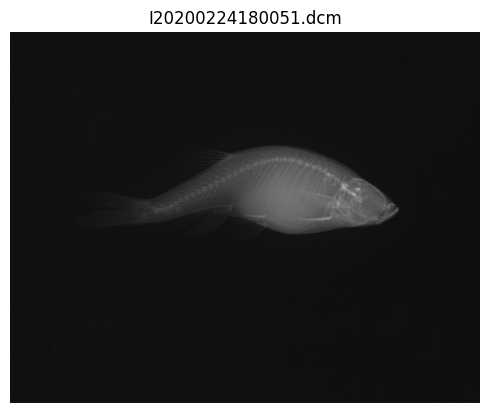

In [7]:
os.chdir(os.path.join(dir_zebrafish_stock, shortcuts[0]))

files = glob.glob("*.dcm")
print(len(files))

n = 20
ob_detect_df = pd.DataFrame(columns = ['Name', 'X', 'Y', 'Width', 'Height', 'Class'])

dcm_header = pydicom.dcmread(files[n])
dcm_file = dcm_header.pixel_array*dcm_header.RescaleSlope - dcm_header.RescaleIntercept
dcm_file = dcm_file.max() - dcm_file

fig, ax = plt.subplots(figsize = (5, 6))

plt.imshow(dcm_file, cmap = "gray")
plt.title(files[n])

plt.axis('off')

fig.tight_layout()
plt.show()

Identifying rough object regions

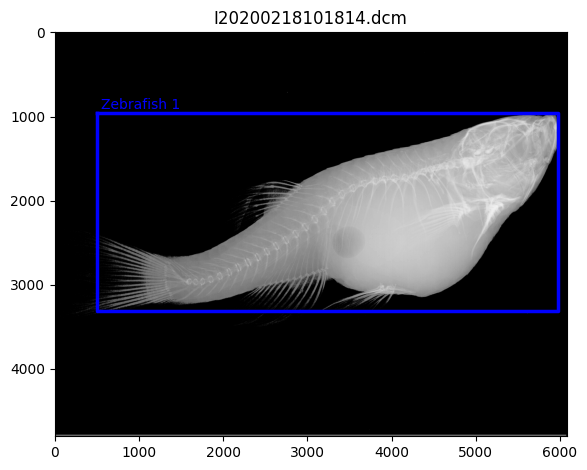

In [97]:
pad = 100
mask = np.pad([dcm_file > np.mean(dcm_file)][0][pad:-pad, pad:-pad], (pad, pad), 'constant', constant_values=(0, 0))

regions = skimage.measure.regionprops(skimage.measure.label(mask))
regions.sort(key = lambda x: x.area, reverse = True)
total_area = np.array([region.area for region in regions])

fig, ax = plt.subplots()
ax.imshow([dcm_file > np.mean(dcm_file)][0]*dcm_file, cmap = "gray")

z_count = 0
L, T, W, H = [], [], [], []

for region in regions:
    if region.area > (dcm_file.shape[0]*dcm_file.shape[1])*0.001:
        top, left, bottom, right = region.bbox
        if left == 100:
            left = 0
        bx = (left, right, right, left, left)
        by = (top, top, bottom, bottom, top)

        if region.area > np.mean(total_area[:20]) - np.std(total_area):
            z_count += 1
            ax.plot(bx, by, '-b', linewidth = 2.5)

            L.append(left)
            T.append(top)
            W.append(right - left)
            H.append(bottom - top)

        else:
            ax.plot(bx, by, '-r', linewidth = 2.5)
            ax.text(left + pad, top - pad/2, "CaHA", fontsize=10, color = 'r')

            x = len(ob_detect_df)
            ob_detect_df.loc[x, "Class"] = "CaHA"
            ob_detect_df.loc[x, "Name"] = files[n][:-4] + ".CaHA"
            ob_detect_df.loc[x, "X"], ob_detect_df.loc[x, "Y"] = left, top
            ob_detect_df.loc[x, "Width"], ob_detect_df.loc[x, "Height"] = right - left, bottom - top


for z in (np.linspace(0, z_count, z_count + 1)[np.argsort(L)]).astype(int):
  index = (np.linspace(0, z_count, z_count + 1)[np.argsort(L)]).astype(int)[z]

  ax.text(L[index] + pad/2, T[index] - pad/2, "Zebrafish " + str(z + 1), fontsize=10, color = 'b')
  x = len(ob_detect_df)
  ob_detect_df.loc[x, "Class"] = "Zebrafish"
  ob_detect_df.loc[x, "Name"] = files[n][:-4] + "." + str(z + 1)
  ob_detect_df.loc[x, "X"], ob_detect_df.loc[x, "Y"] = L[index], T[index]
  ob_detect_df.loc[x, "Width"], ob_detect_df.loc[x, "Height"] = W[index], H[index]

plt.title(files[n])
# ax.axis('off')

fig.tight_layout()
plt.show()

### Attempt 2 - Generate Excel Sheet of Objects and Locations

Progress:   0%|          | 0/21 [00:00<?, ?it/s]

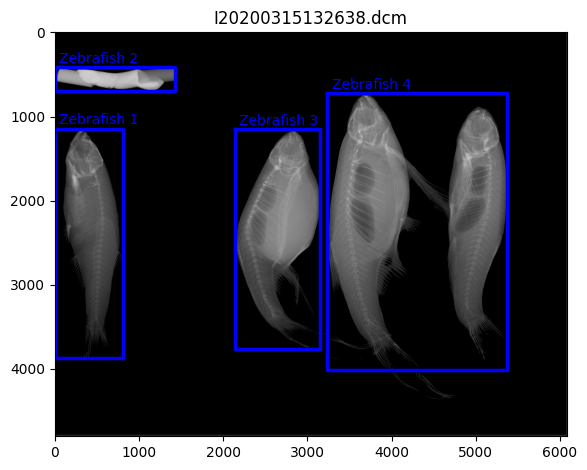

Progress:   5%|▍         | 1/21 [00:05<01:43,  5.19s/it]

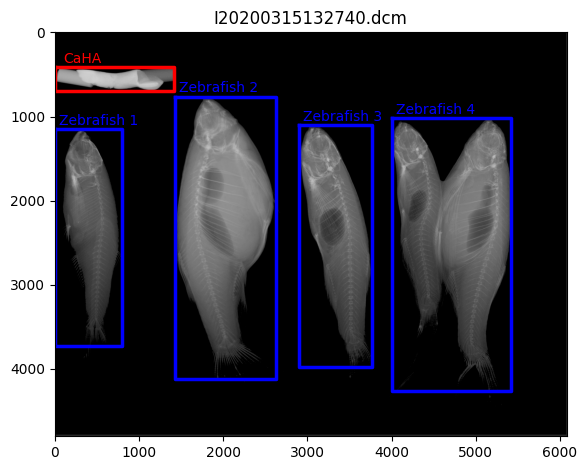

Progress:  10%|▉         | 2/21 [00:09<01:27,  4.61s/it]

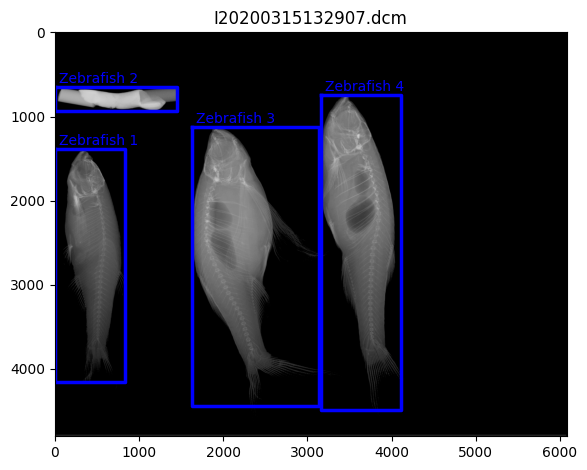

Progress:  14%|█▍        | 3/21 [00:14<01:27,  4.87s/it]

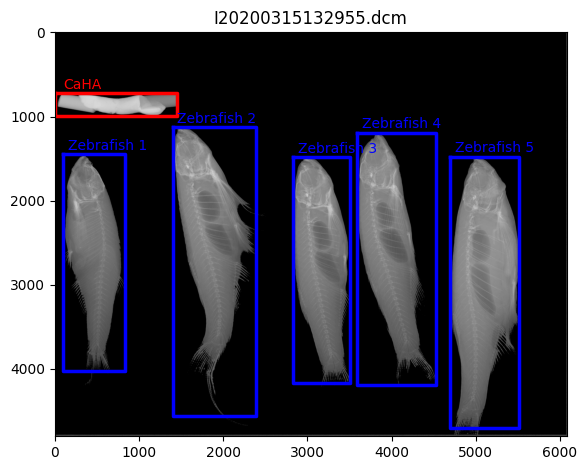

Progress:  19%|█▉        | 4/21 [00:18<01:15,  4.42s/it]

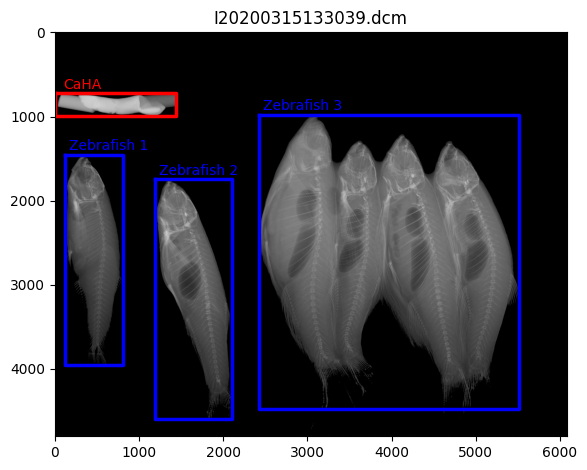

Progress:  24%|██▍       | 5/21 [00:22<01:06,  4.18s/it]

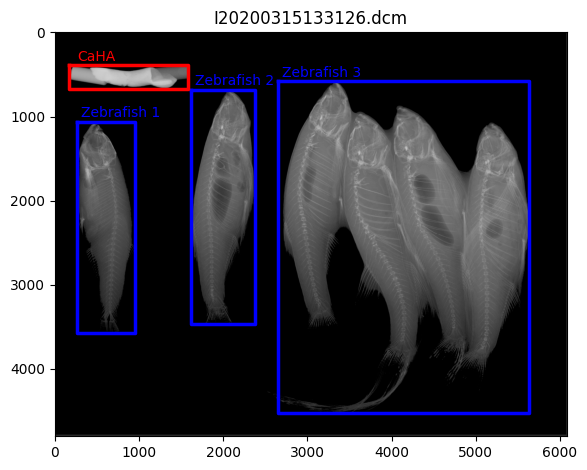

Progress:  29%|██▊       | 6/21 [00:27<01:07,  4.48s/it]

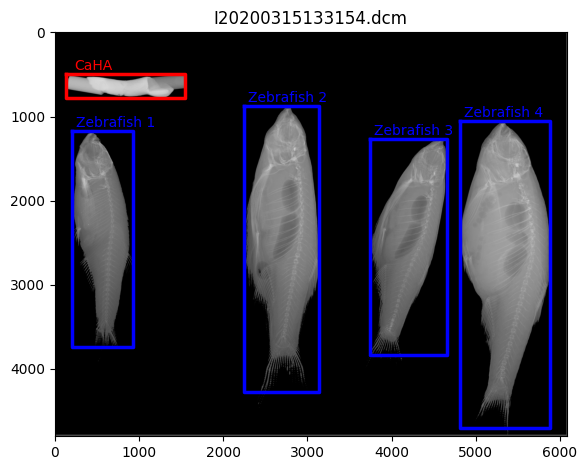

Progress:  33%|███▎      | 7/21 [00:31<01:02,  4.43s/it]

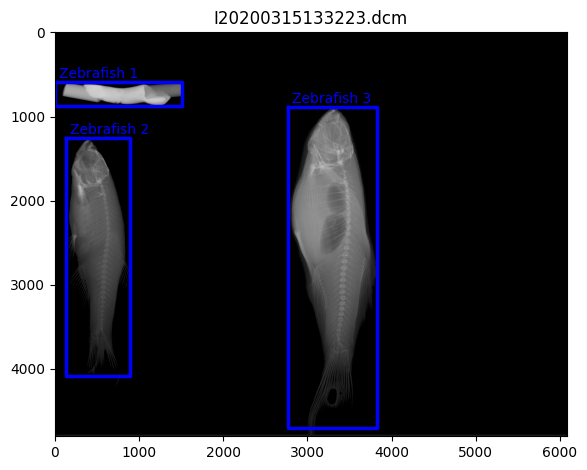

Progress:  38%|███▊      | 8/21 [00:35<00:55,  4.24s/it]

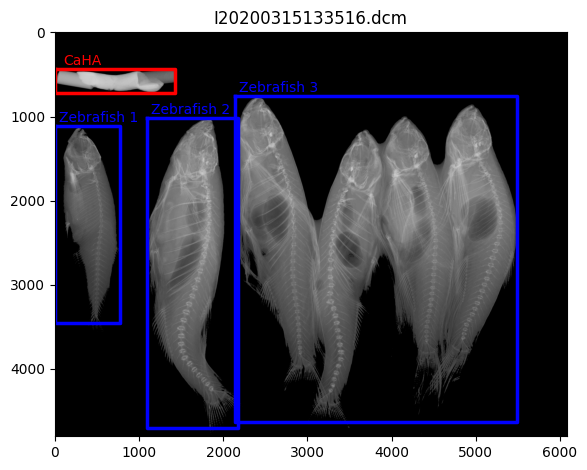

Progress:  43%|████▎     | 9/21 [00:39<00:49,  4.10s/it]

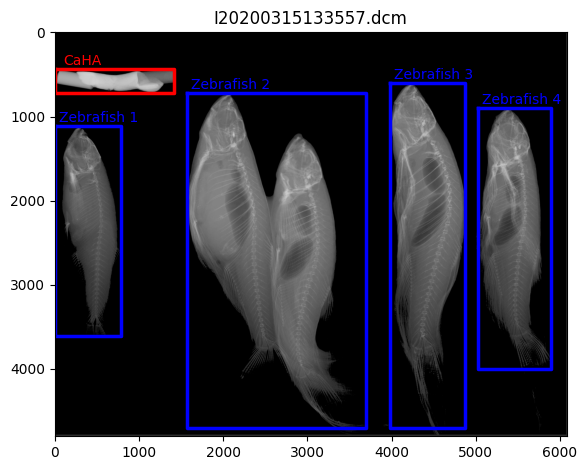

Progress:  48%|████▊     | 10/21 [00:44<00:49,  4.54s/it]

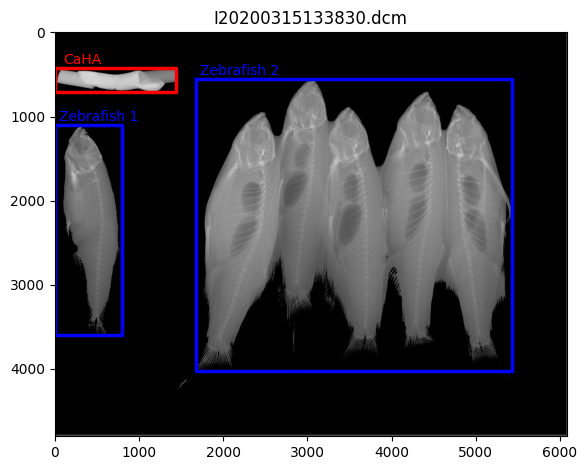

Progress:  52%|█████▏    | 11/21 [00:48<00:42,  4.27s/it]

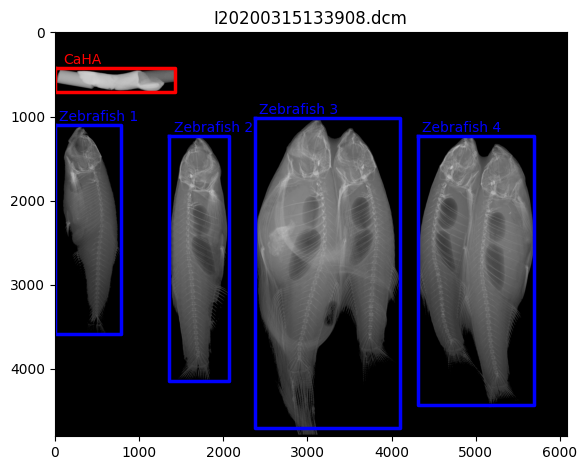

Progress:  57%|█████▋    | 12/21 [00:51<00:36,  4.10s/it]

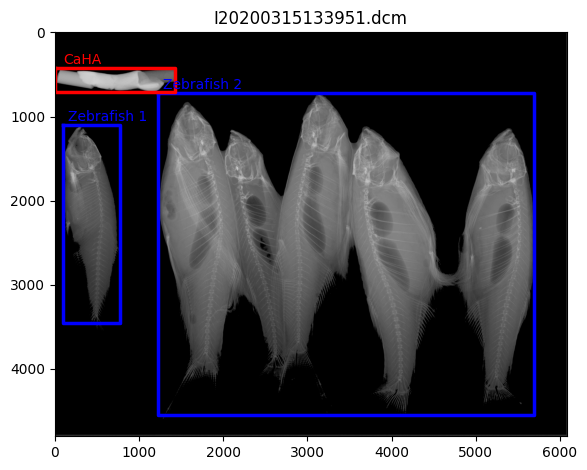

Progress:  62%|██████▏   | 13/21 [00:57<00:36,  4.53s/it]

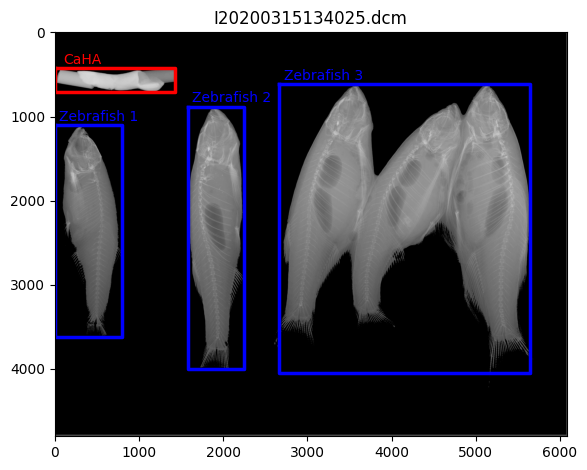

Progress:  67%|██████▋   | 14/21 [01:02<00:33,  4.73s/it]

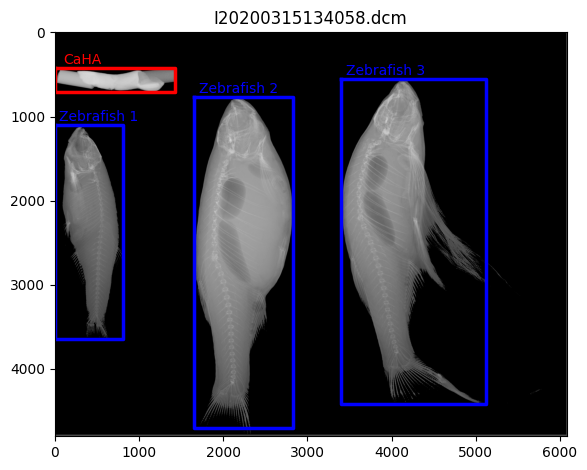

Progress:  71%|███████▏  | 15/21 [01:06<00:25,  4.33s/it]

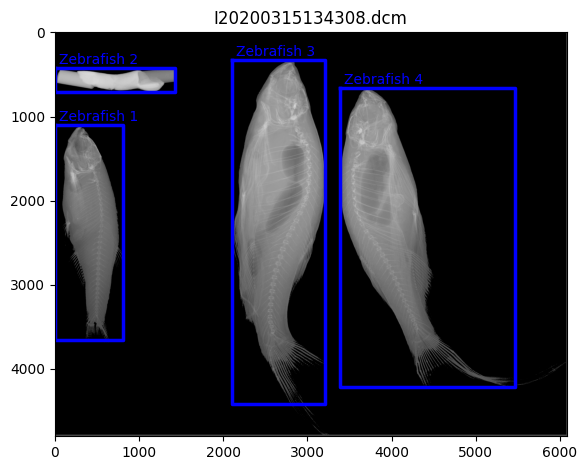

Progress:  76%|███████▌  | 16/21 [01:09<00:20,  4.09s/it]

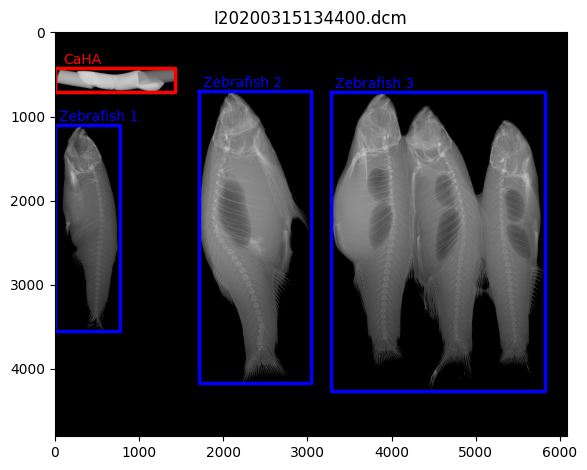

Progress:  81%|████████  | 17/21 [01:13<00:15,  3.97s/it]

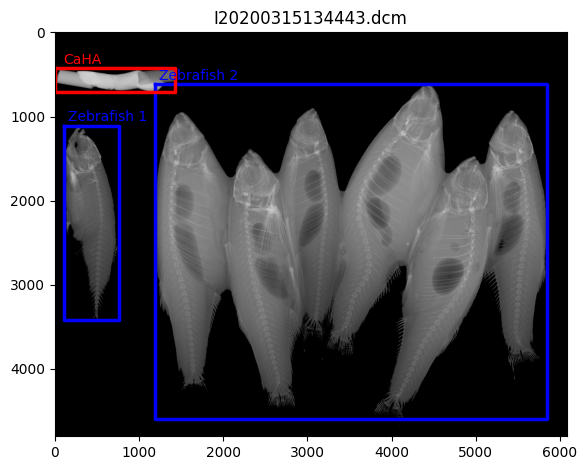

Progress:  86%|████████▌ | 18/21 [01:18<00:12,  4.29s/it]

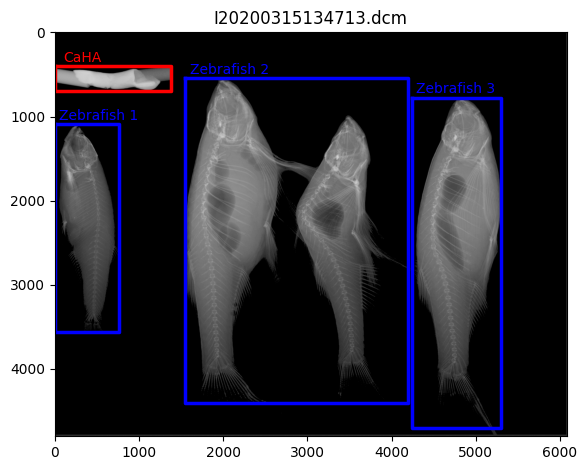

Progress:  90%|█████████ | 19/21 [01:21<00:08,  4.08s/it]

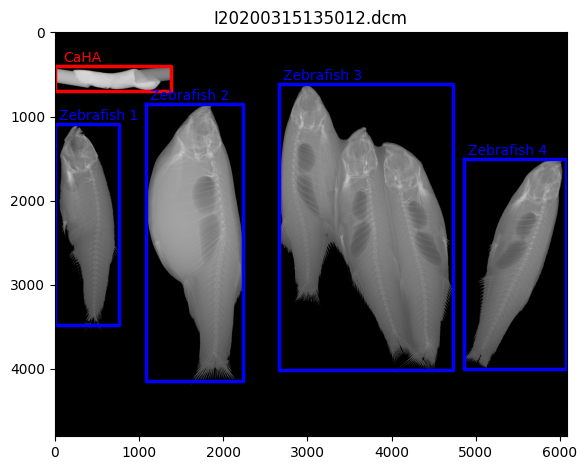

Progress:  95%|█████████▌| 20/21 [01:25<00:03,  3.88s/it]

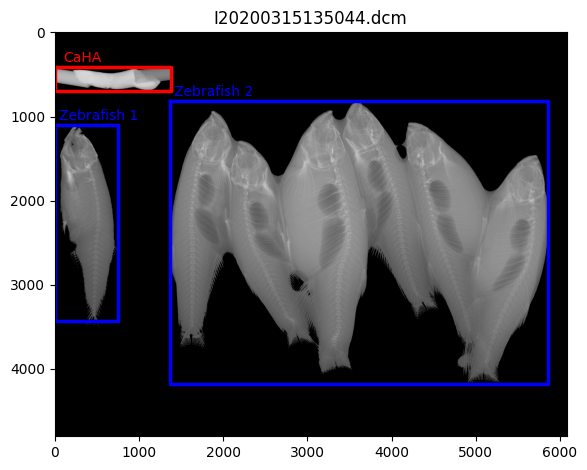

Progress: 100%|██████████| 21/21 [01:28<00:00,  4.24s/it]


In [18]:
set = 1
os.chdir(os.path.join(dir_zebrafish_stock, shortcuts[set]))
ob_detect_df = pd.DataFrame(columns = ['Name', 'X', 'Y', 'Width', 'Height', 'Class'])

files = glob.glob("*.dcm")

pad = 100

progressbar = trange(len(files), desc = "Progress")
for n in progressbar:
  dcm_header = pydicom.dcmread(files[n])
  dcm_file = dcm_header.pixel_array*dcm_header.RescaleSlope - dcm_header.RescaleIntercept
  dcm_file = dcm_file.max() - dcm_file

  mask = np.pad([dcm_file > np.mean(dcm_file)][0][pad:-pad, pad:-pad], (pad, pad), 'constant', constant_values=(0, 0))

  regions = skimage.measure.regionprops(skimage.measure.label(mask))
  regions.sort(key = lambda x: x.area, reverse = True)
  total_area = np.array([region.area for region in regions])

  fig, ax = plt.subplots()
  ax.imshow([dcm_file > np.mean(dcm_file)][0]*dcm_file, cmap = "gray")

  z_count = 0
  L, T, W, H = [], [], [], []

  for region in regions:
      if region.area > (dcm_file.shape[0]*dcm_file.shape[1])*0.001:
          top, left, bottom, right = region.bbox
          if left == 100:
              left = 0
          if right == dcm_file.shape[1] - pad:
            right = dcm_file.shape[1] - 1
          bx = (left, right, right, left, left)
          by = (top, top, bottom, bottom, top)

          if region.area > np.mean(total_area[:20]) - np.std(total_area):
              z_count += 1
              ax.plot(bx, by, '-b', linewidth = 2.5)

              L.append(left)
              T.append(top)
              W.append(right - left)
              H.append(bottom - top)

          else:
              ax.plot(bx, by, '-r', linewidth = 2.5)
              ax.text(left + pad, top - pad/2, "CaHA", fontsize=10, color = 'r')

              x = len(ob_detect_df)
              ob_detect_df.loc[x, "Class"] = "CaHA"
              ob_detect_df.loc[x, "Name"] = files[n][:-4] + ".CaHA"
              ob_detect_df.loc[x, "X"], ob_detect_df.loc[x, "Y"] = left, top
              ob_detect_df.loc[x, "Width"], ob_detect_df.loc[x, "Height"] = right - left, bottom - top


  for z in (np.linspace(0, z_count, z_count + 1)[np.argsort(L)]).astype(int):
    index = (np.linspace(0, z_count, z_count + 1)[np.argsort(L)]).astype(int)[z]

    ax.text(L[index] + pad/2, T[index] - pad/2, "Zebrafish " + str(z + 1), fontsize=10, color = 'b')
    x = len(ob_detect_df)
    ob_detect_df.loc[x, "Class"] = "Zebrafish"
    ob_detect_df.loc[x, "Name"] = files[n][:-4] + "." + str(z + 1)
    ob_detect_df.loc[x, "X"], ob_detect_df.loc[x, "Y"] = L[index], T[index]
    ob_detect_df.loc[x, "Width"], ob_detect_df.loc[x, "Height"] = W[index], H[index]

  plt.title(files[n])
  # ax.axis('off')

  fig.tight_layout()
  plt.show()

os.chdir(dir_zebrafish_stock)

ob_detect_df.to_excel(str(shortcuts[set]) + ".xlsx", index = False)

### Checking Manual Location Updates

In [19]:
os.chdir(dir_zebrafish_stock)

re_iterations = pd.read_excel(pd.ExcelFile("Xray 2020 march.xlsx"), "Image Comments")

re_iterations["Stock"] = [re_iterations["Image Names"][n].split(".")[0] for n in range(len(re_iterations))]

re_iterations.head()

,Image Names,Group,Note,X,Y,Width,Height,Class,Stock
0,I20200218101441.1,Training,Single,965,1413,4319,1850,Zebrafish,I20200218101441
1,EI20200218101441.1,Remove,Repeat Image,1021,1413,4263,1847,Zebrafish,EI20200218101441
2,I20200218101620.1,Remove,Repeat Image,1063,1413,4222,1757,Zebrafish,I20200218101620
3,EI20200218101620.1,Remove,Repeat Image,1063,1413,4222,1744,Zebrafish,EI20200218101620
4,I20200218101814.1,Remove,Repeat Image,495,958,5485,2349,Zebrafish,I20200218101814


Progress:   0%|          | 0/216 [00:00<?, ?it/s]

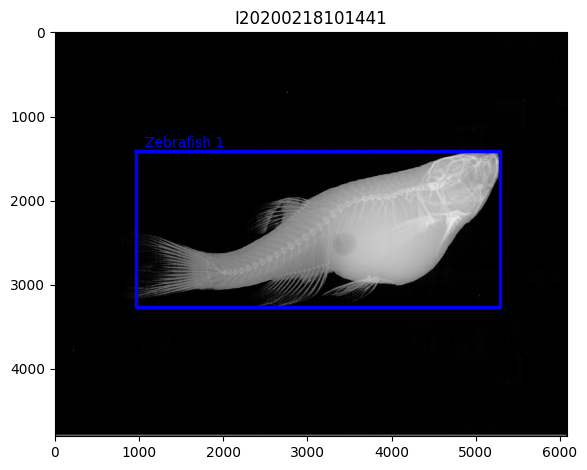

Progress:   0%|          | 1/216 [00:04<15:31,  4.33s/it]

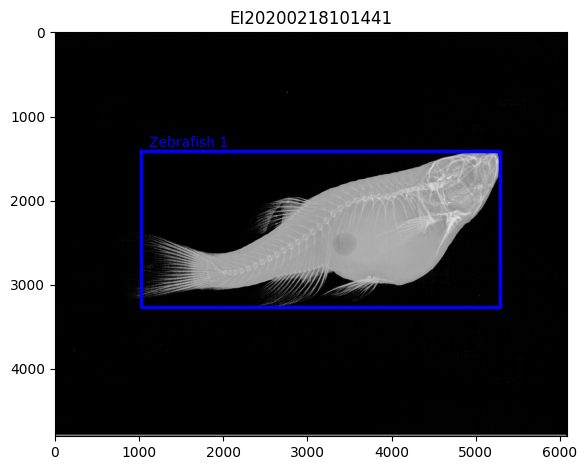

Progress:   1%|          | 2/216 [00:08<14:16,  4.00s/it]

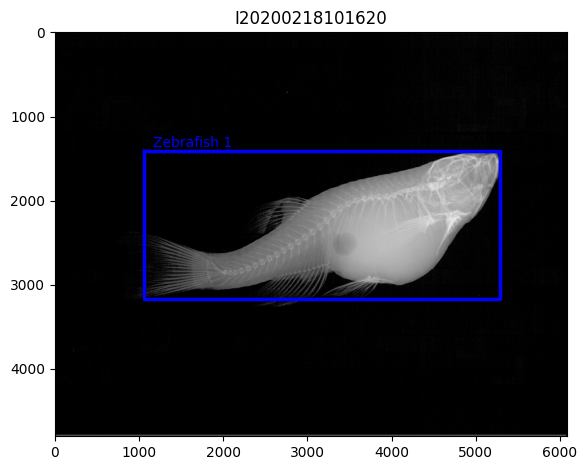

Progress:   1%|▏         | 3/216 [00:11<12:47,  3.60s/it]

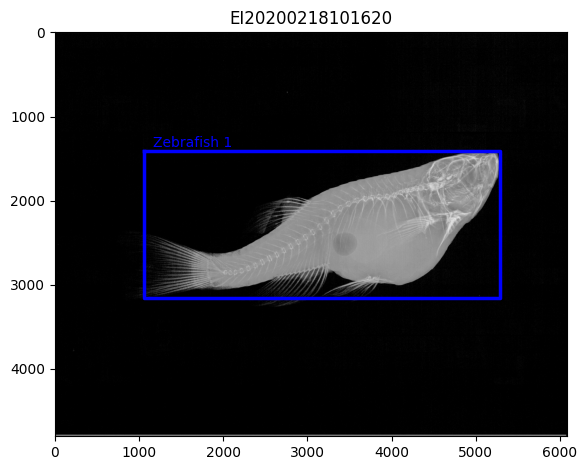

Progress:   2%|▏         | 4/216 [00:14<12:04,  3.42s/it]

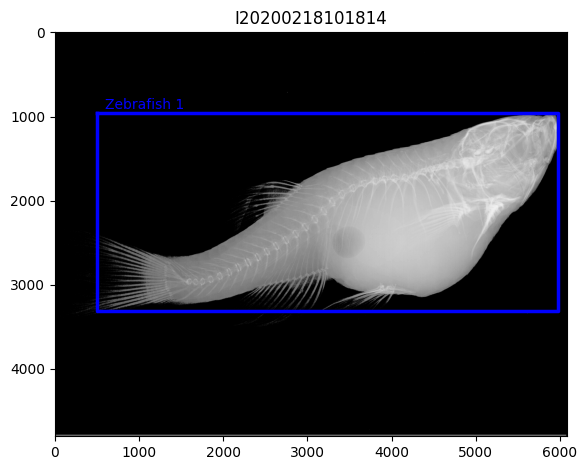

Progress:   2%|▏         | 5/216 [00:18<12:21,  3.51s/it]

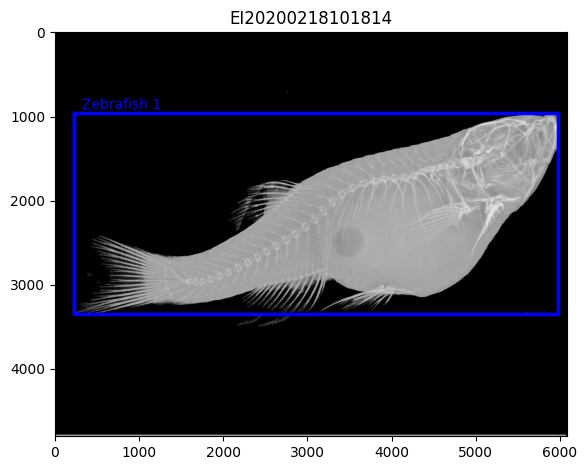

Progress:   3%|▎         | 6/216 [00:22<13:28,  3.85s/it]

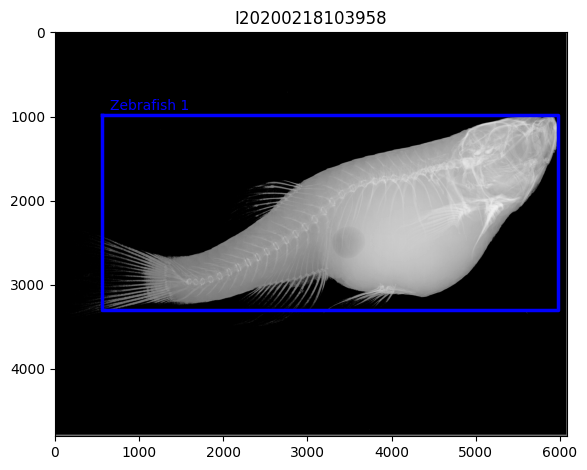

Progress:   3%|▎         | 7/216 [00:25<12:54,  3.71s/it]

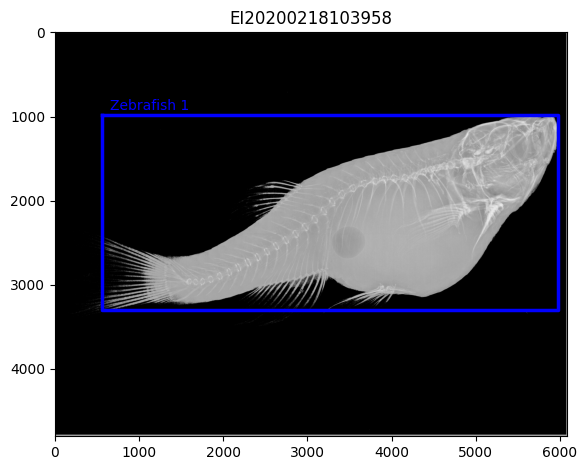

Progress:   4%|▎         | 8/216 [00:29<12:22,  3.57s/it]

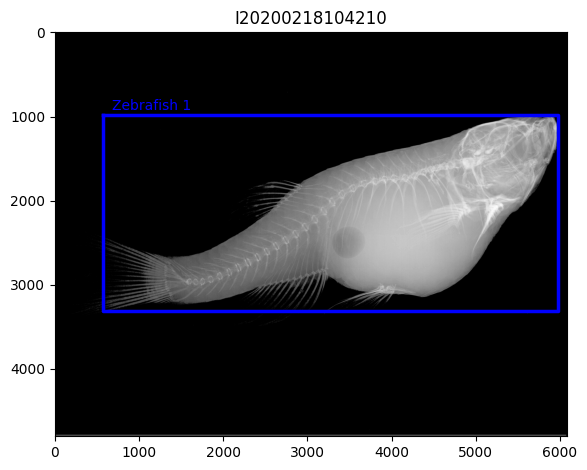

Progress:   4%|▍         | 9/216 [00:33<12:45,  3.70s/it]

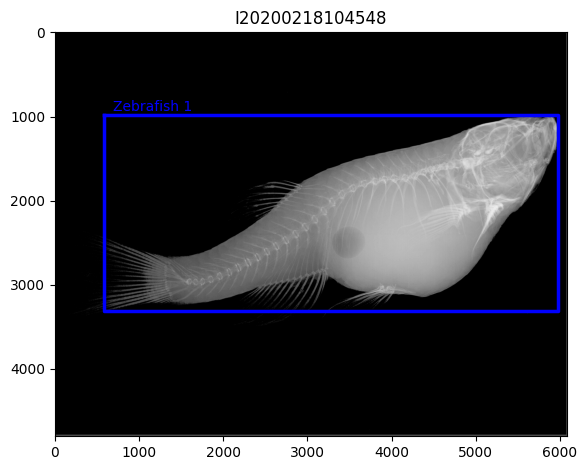

Progress:   5%|▍         | 10/216 [00:37<13:40,  3.98s/it]

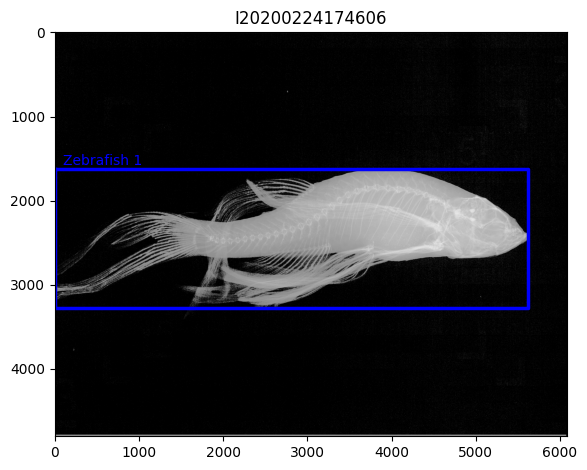

Progress:   5%|▌         | 11/216 [00:41<13:12,  3.86s/it]

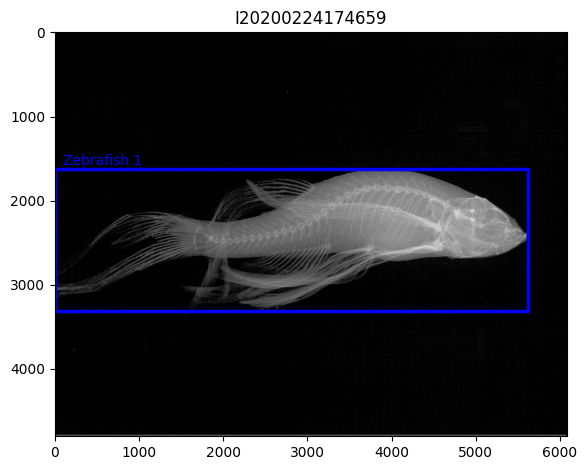

Progress:   6%|▌         | 12/216 [00:45<12:56,  3.81s/it]

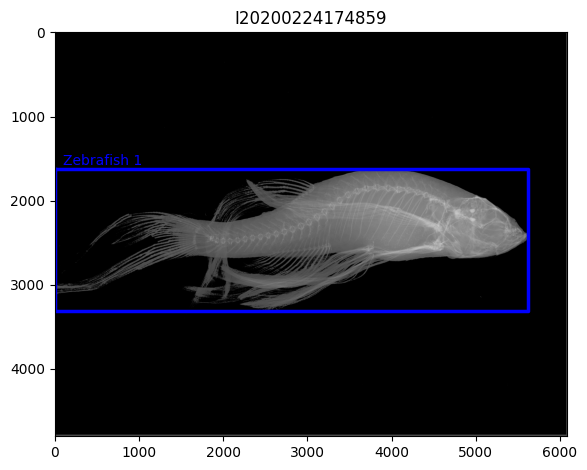

Progress:   6%|▌         | 13/216 [00:49<13:18,  3.93s/it]

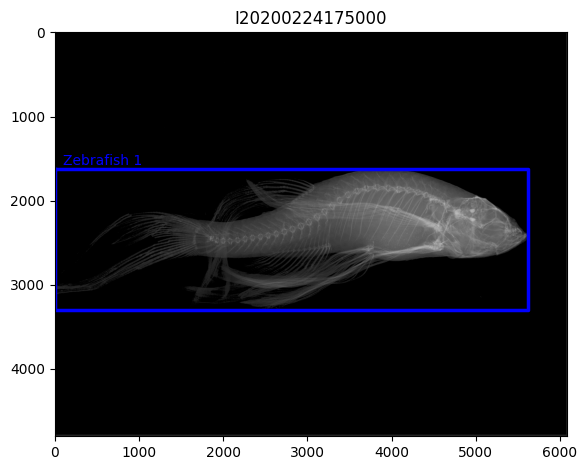

Progress:   6%|▋         | 14/216 [00:53<13:47,  4.10s/it]

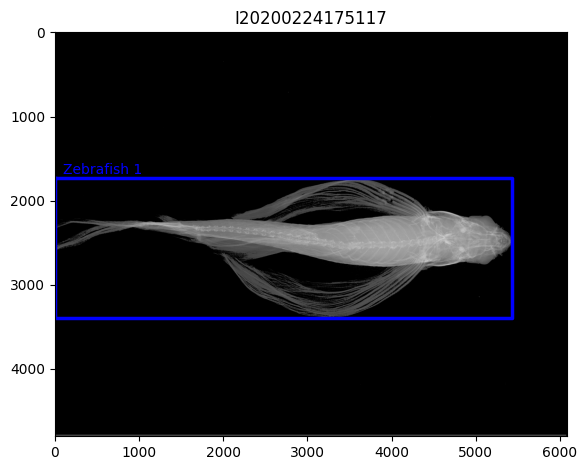

Progress:   7%|▋         | 15/216 [00:57<13:00,  3.88s/it]

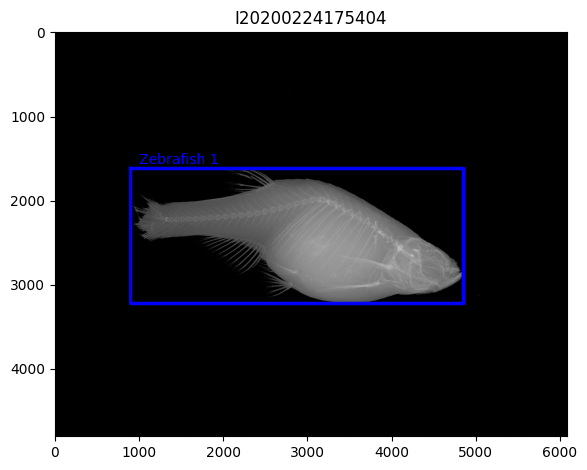

Progress:   7%|▋         | 16/216 [01:00<12:43,  3.82s/it]

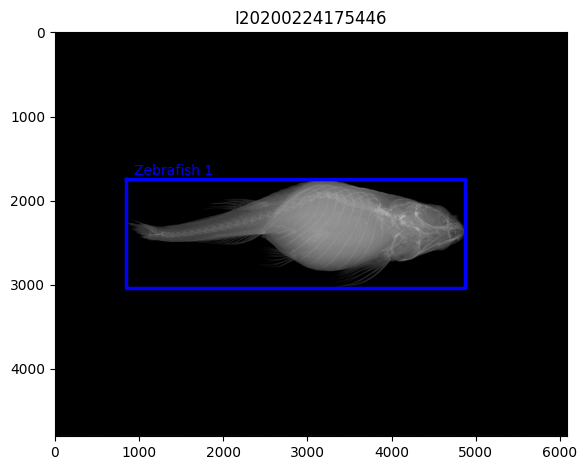

Progress:   8%|▊         | 17/216 [01:08<16:58,  5.12s/it]

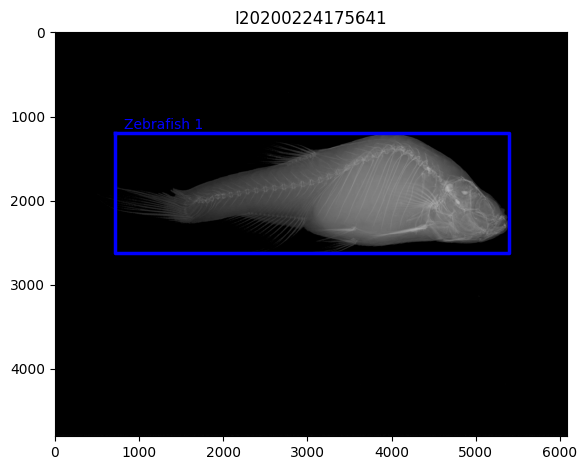

Progress:   8%|▊         | 18/216 [01:14<17:15,  5.23s/it]

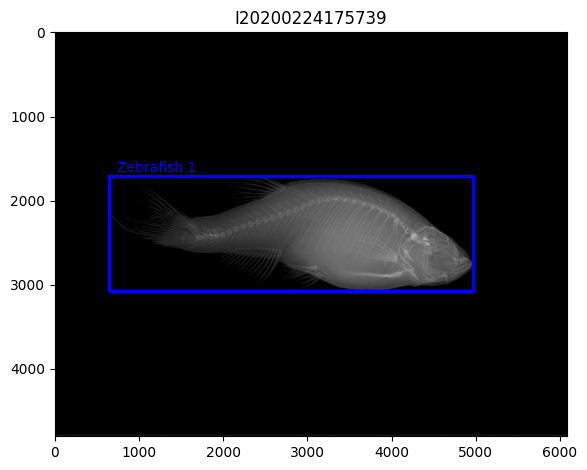

Progress:   9%|▉         | 19/216 [01:17<15:19,  4.67s/it]

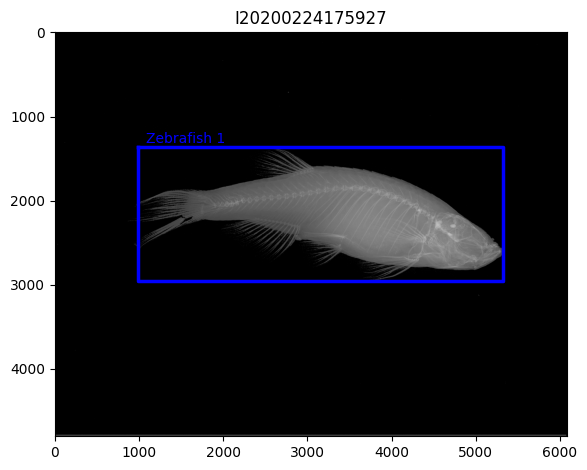

Progress:   9%|▉         | 20/216 [01:21<14:10,  4.34s/it]

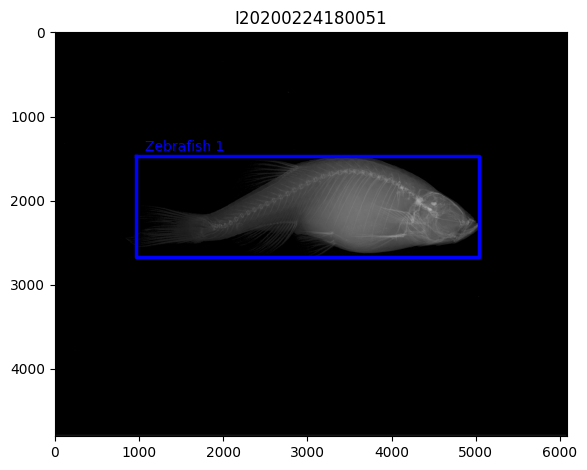

Progress:  10%|▉         | 21/216 [01:25<14:09,  4.36s/it]

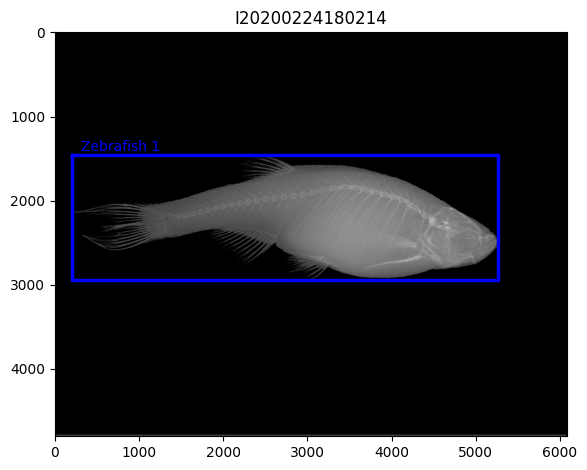

Progress:  10%|█         | 22/216 [01:30<14:07,  4.37s/it]

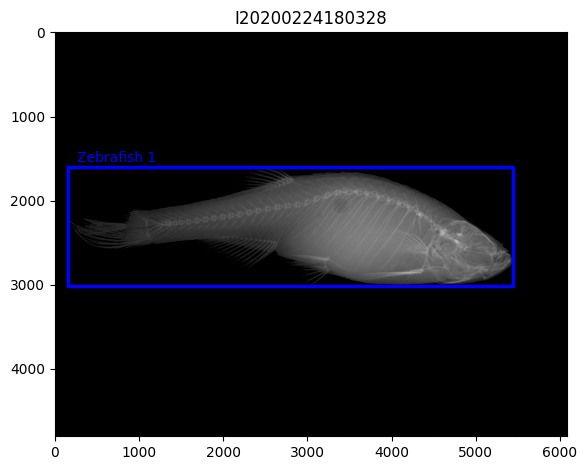

Progress:  11%|█         | 23/216 [01:33<13:06,  4.07s/it]

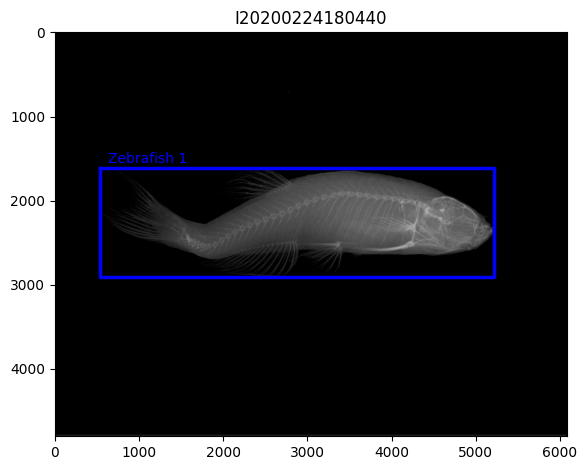

Progress:  11%|█         | 24/216 [01:37<12:40,  3.96s/it]

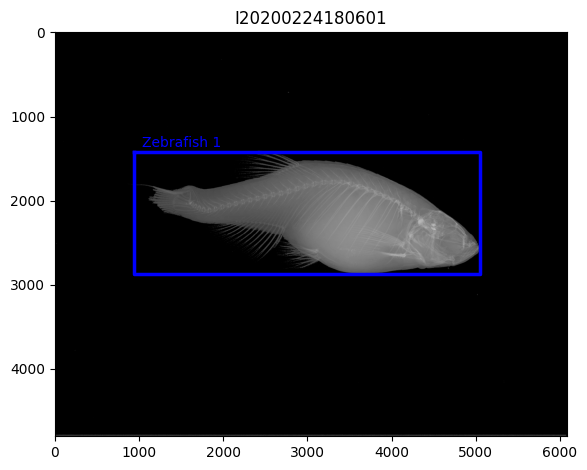

Progress:  12%|█▏        | 25/216 [01:42<13:28,  4.23s/it]

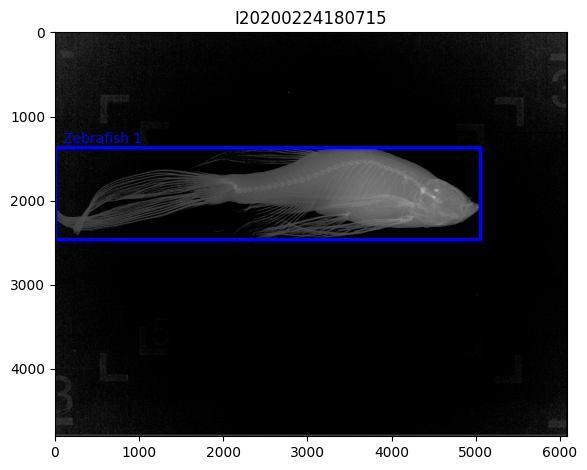

Progress:  12%|█▏        | 26/216 [01:47<14:03,  4.44s/it]

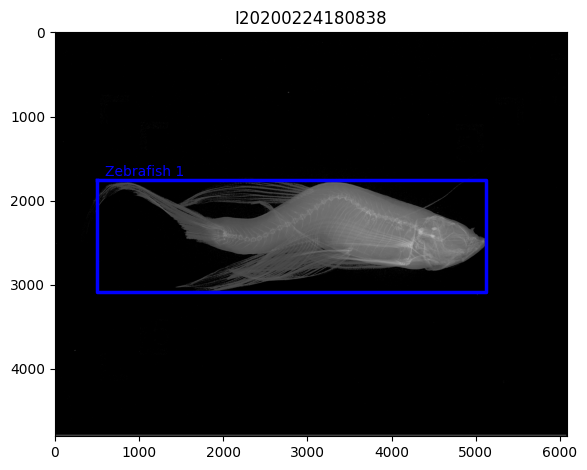

Progress:  12%|█▎        | 27/216 [01:50<13:01,  4.13s/it]

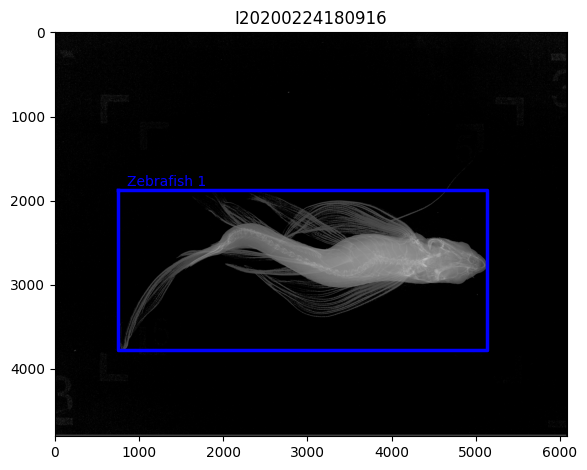

Progress:  13%|█▎        | 28/216 [01:53<12:10,  3.89s/it]

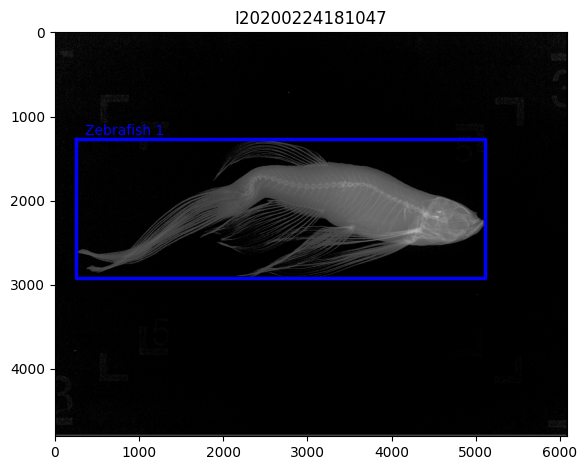

Progress:  13%|█▎        | 29/216 [01:58<12:30,  4.01s/it]

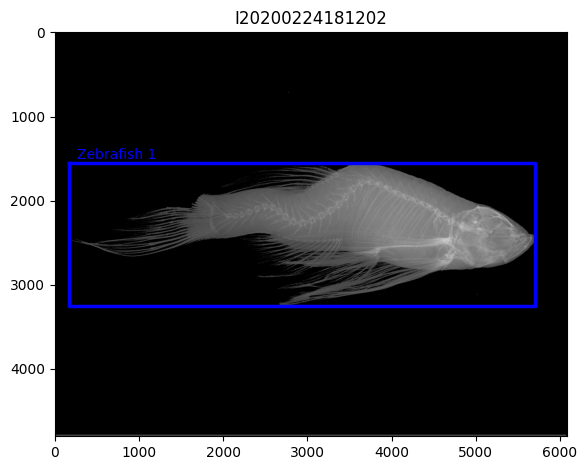

Progress:  14%|█▍        | 30/216 [02:02<12:27,  4.02s/it]

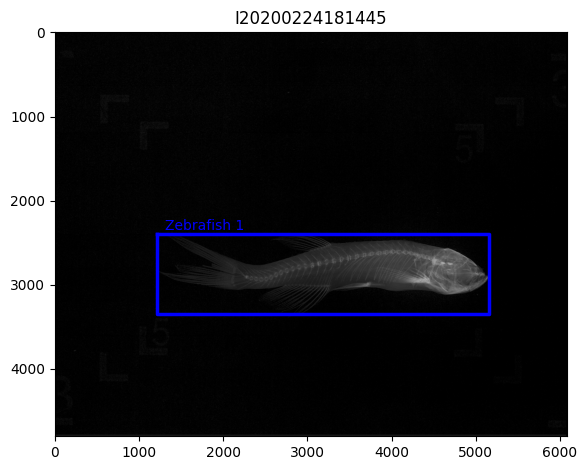

Progress:  14%|█▍        | 31/216 [02:05<11:43,  3.80s/it]

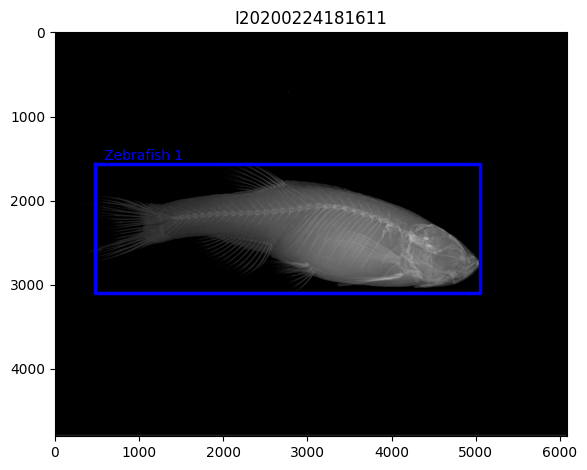

Progress:  15%|█▍        | 32/216 [02:08<11:08,  3.63s/it]

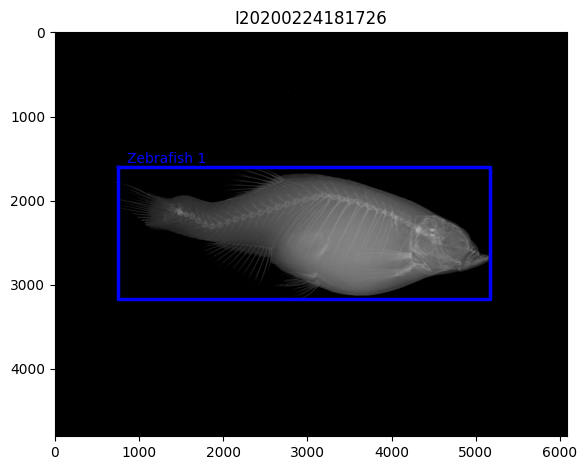

Progress:  15%|█▌        | 33/216 [02:12<11:20,  3.72s/it]

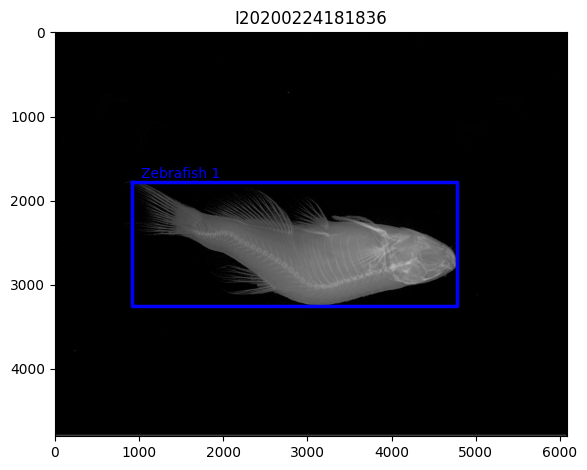

Progress:  16%|█▌        | 34/216 [02:17<12:08,  4.00s/it]

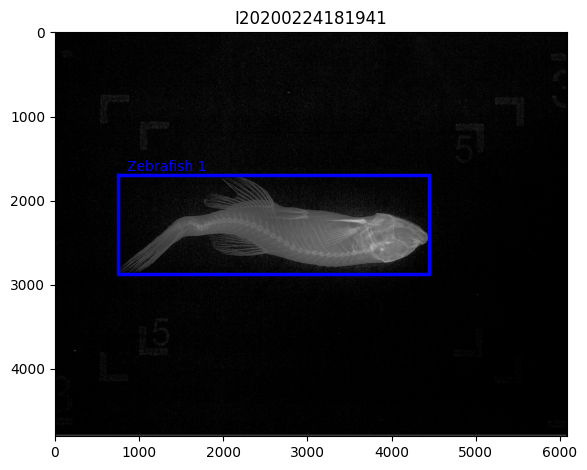

Progress:  16%|█▌        | 35/216 [02:20<11:30,  3.81s/it]

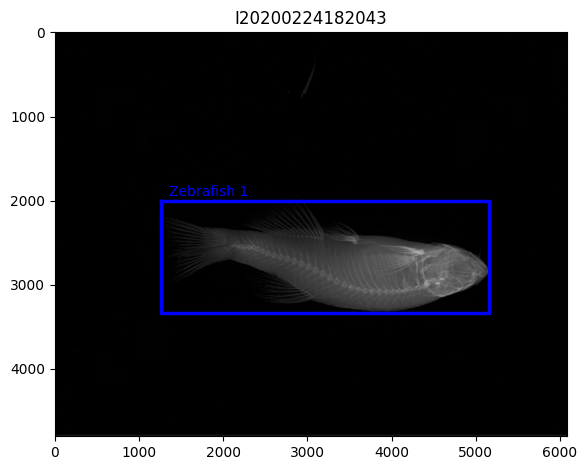

Progress:  17%|█▋        | 36/216 [02:24<11:05,  3.69s/it]

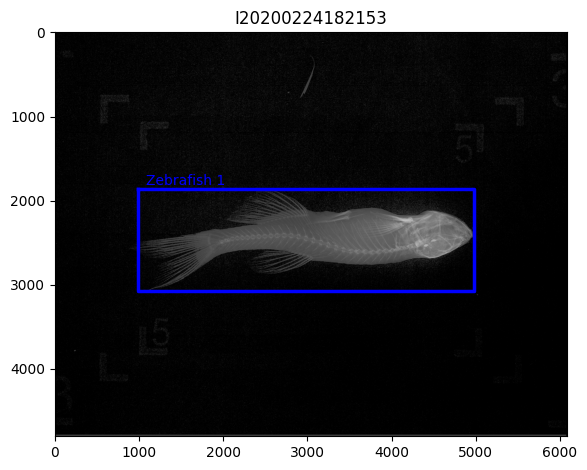

Progress:  17%|█▋        | 37/216 [02:32<15:11,  5.09s/it]

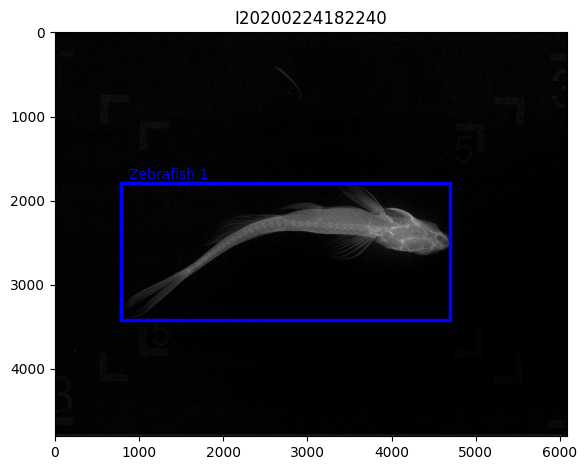

Progress:  18%|█▊        | 38/216 [02:37<15:14,  5.14s/it]

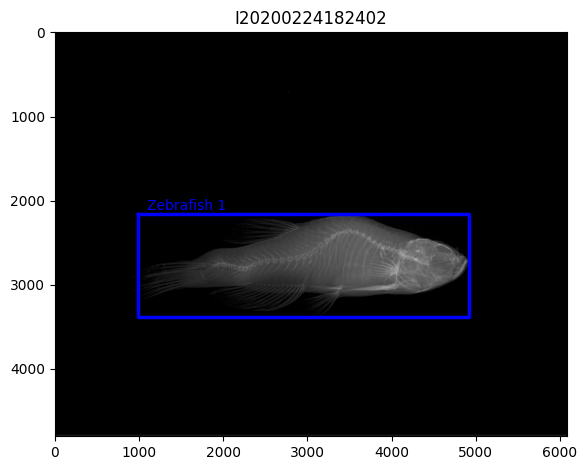

Progress:  18%|█▊        | 39/216 [02:41<14:12,  4.82s/it]

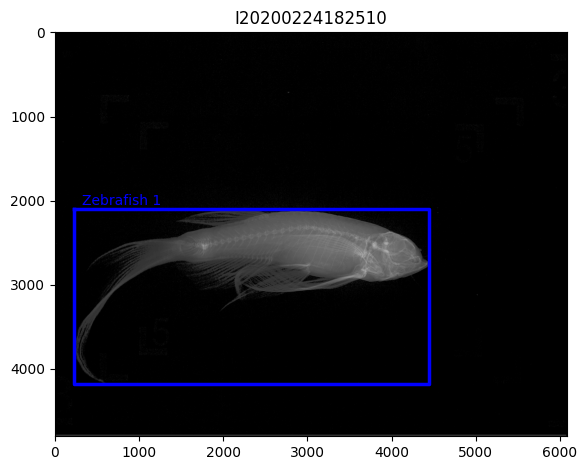

Progress:  19%|█▊        | 40/216 [02:47<15:14,  5.20s/it]

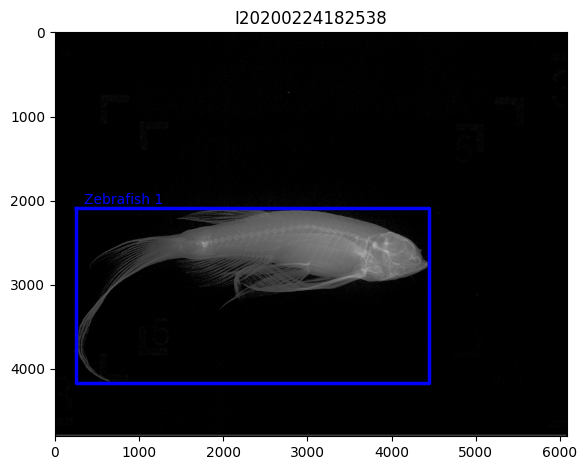

Progress:  19%|█▉        | 41/216 [02:53<15:34,  5.34s/it]

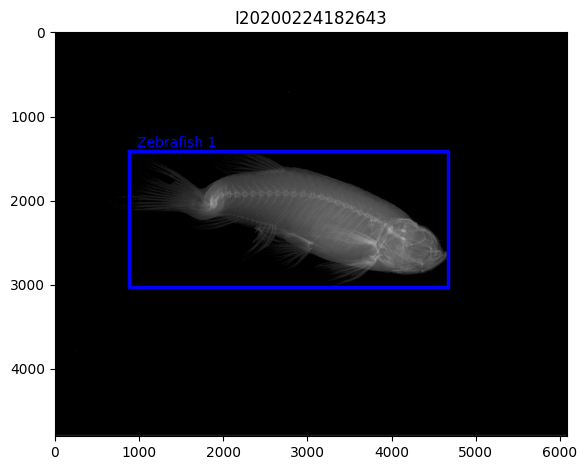

Progress:  19%|█▉        | 42/216 [02:58<14:47,  5.10s/it]

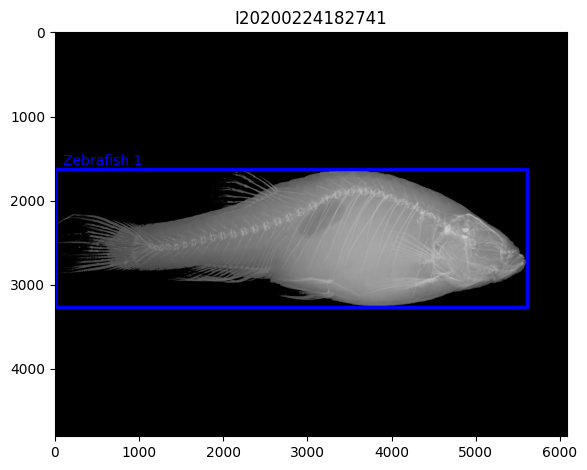

Progress:  20%|█▉        | 43/216 [03:03<14:44,  5.11s/it]

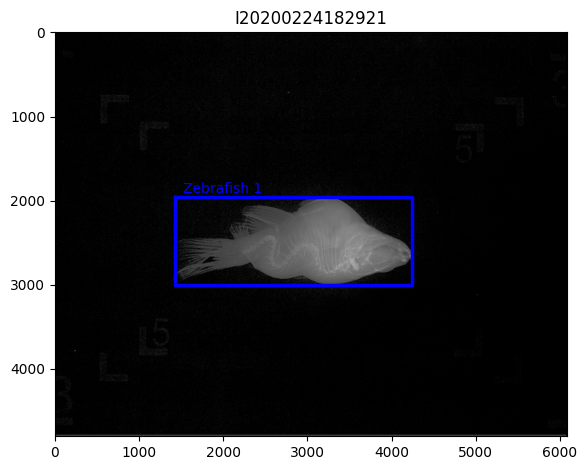

Progress:  20%|██        | 44/216 [03:08<14:40,  5.12s/it]

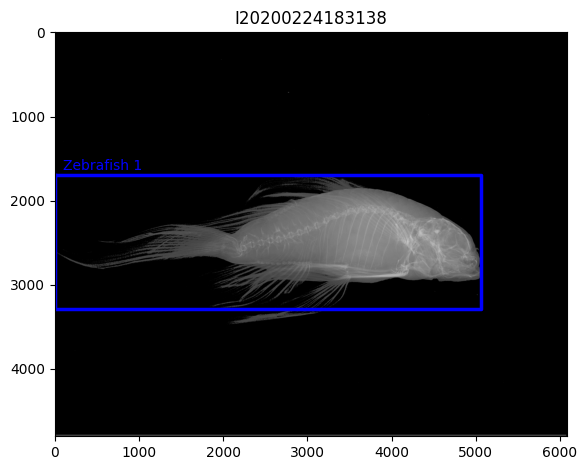

Progress:  21%|██        | 45/216 [03:12<13:31,  4.75s/it]

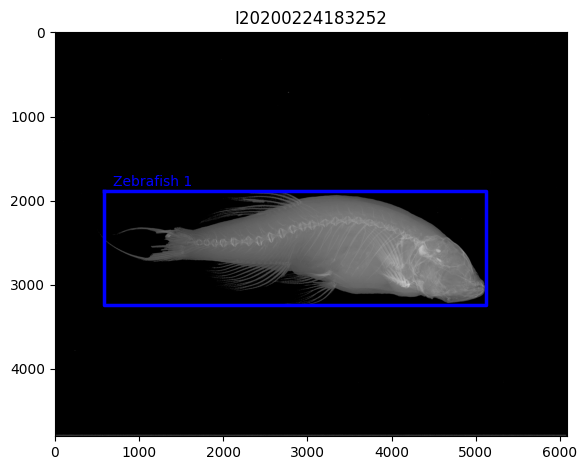

Progress:  21%|██▏       | 46/216 [03:16<13:13,  4.67s/it]

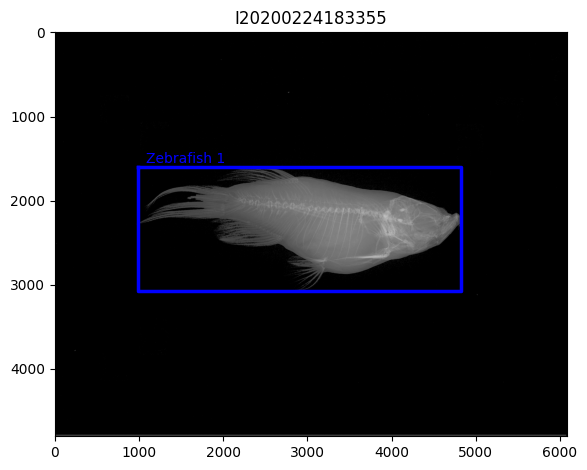

Progress:  22%|██▏       | 47/216 [03:22<14:13,  5.05s/it]

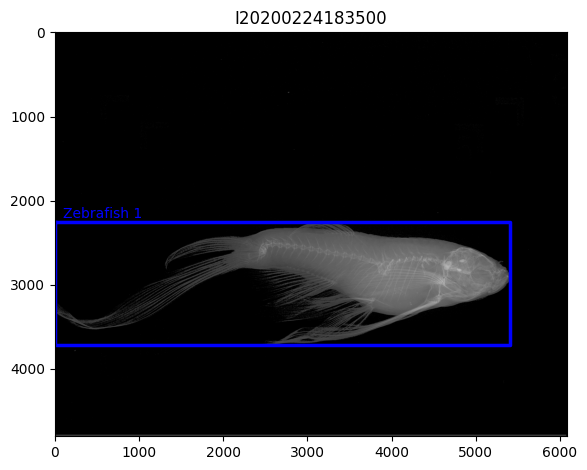

Progress:  22%|██▏       | 48/216 [03:29<15:54,  5.68s/it]

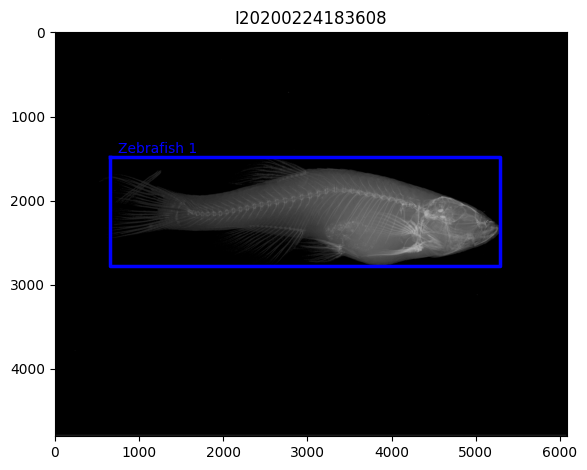

Progress:  23%|██▎       | 49/216 [03:33<13:58,  5.02s/it]

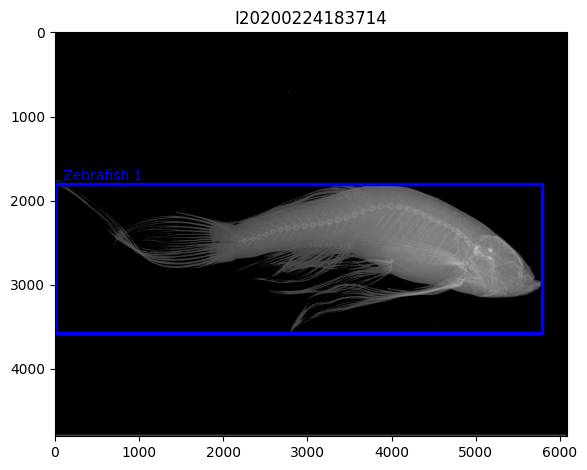

Progress:  23%|██▎       | 50/216 [03:38<13:56,  5.04s/it]

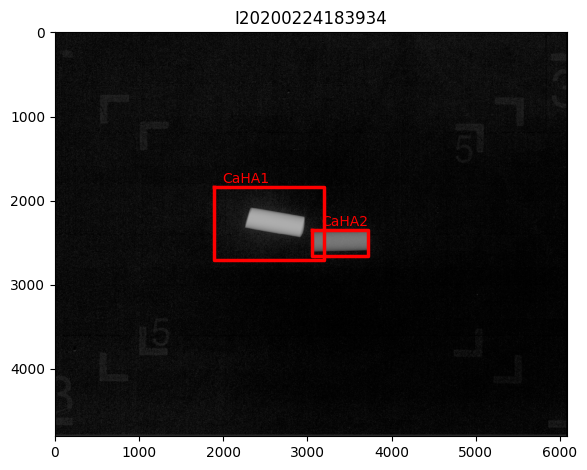

Progress:  24%|██▎       | 51/216 [03:43<14:06,  5.13s/it]

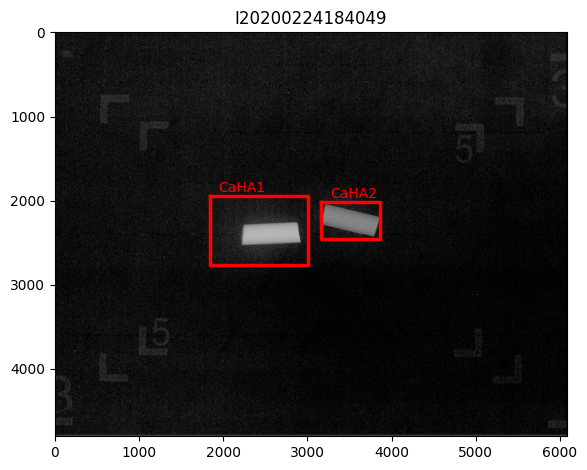

Progress:  24%|██▍       | 52/216 [03:47<12:55,  4.73s/it]

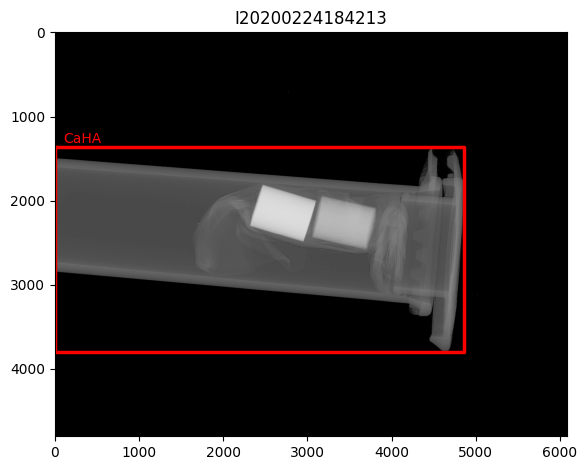

Progress:  25%|██▍       | 53/216 [03:51<12:08,  4.47s/it]

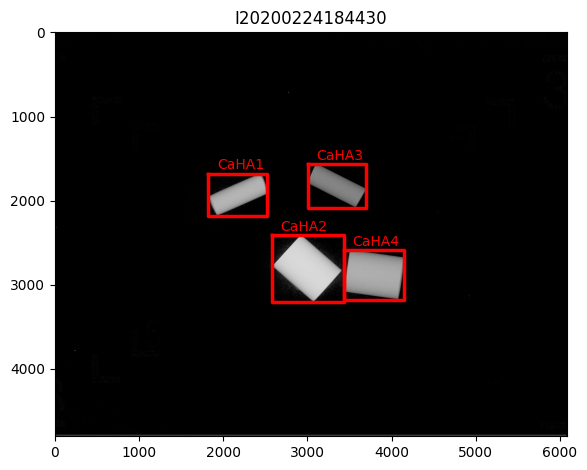

Progress:  25%|██▌       | 54/216 [03:56<12:54,  4.78s/it]

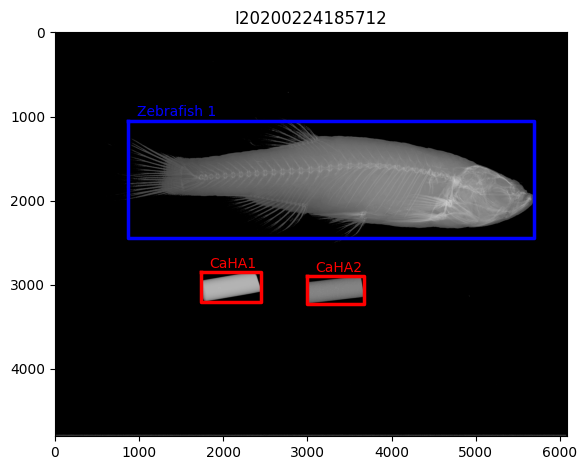

Progress:  25%|██▌       | 55/216 [04:01<12:21,  4.60s/it]

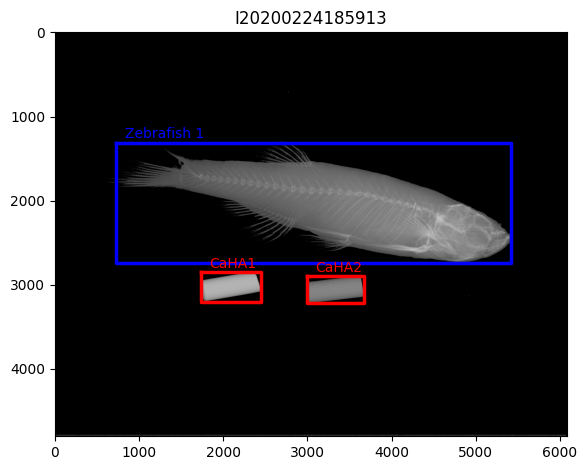

Progress:  26%|██▌       | 56/216 [04:04<11:14,  4.22s/it]

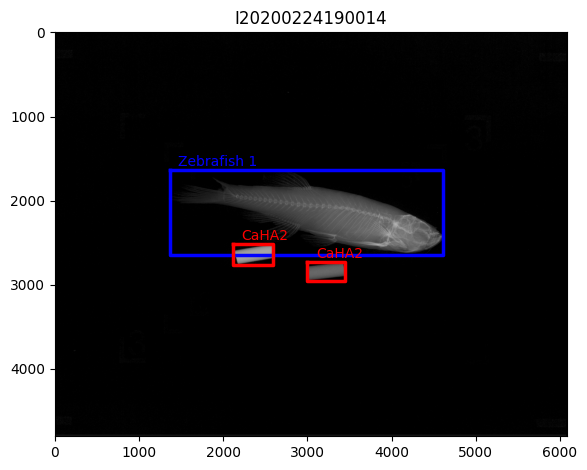

Progress:  26%|██▋       | 57/216 [04:07<10:20,  3.90s/it]

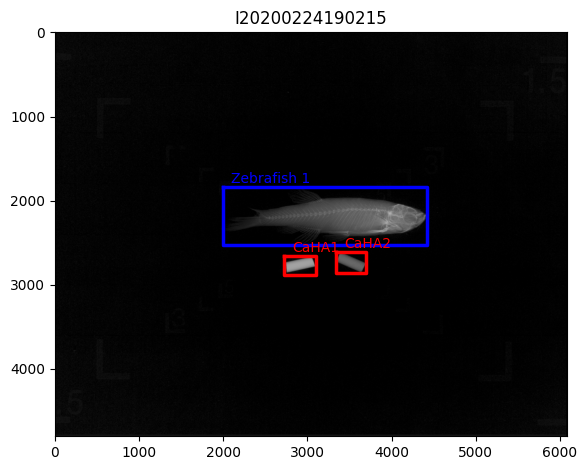

Progress:  27%|██▋       | 58/216 [04:11<10:35,  4.02s/it]

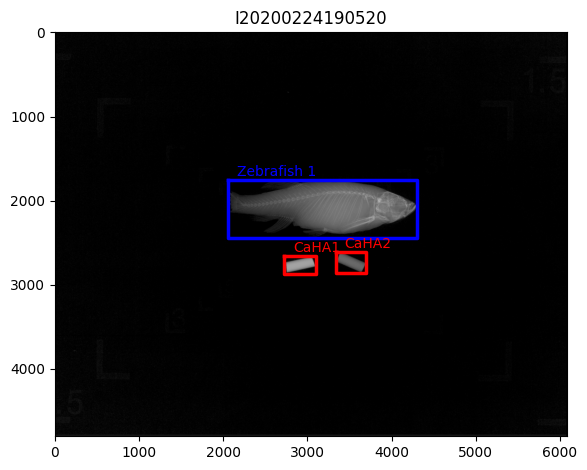

Progress:  27%|██▋       | 59/216 [04:15<10:21,  3.96s/it]

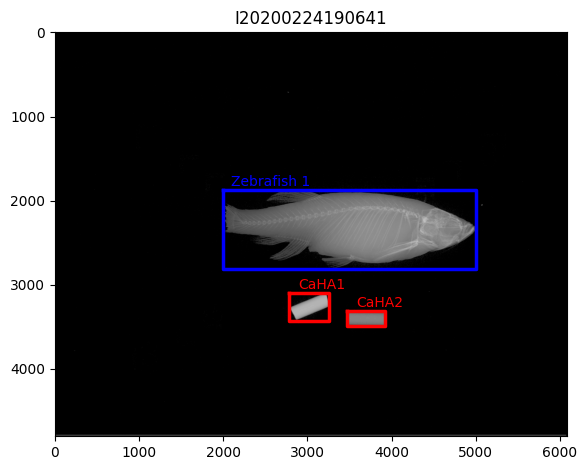

Progress:  28%|██▊       | 60/216 [04:20<10:53,  4.19s/it]

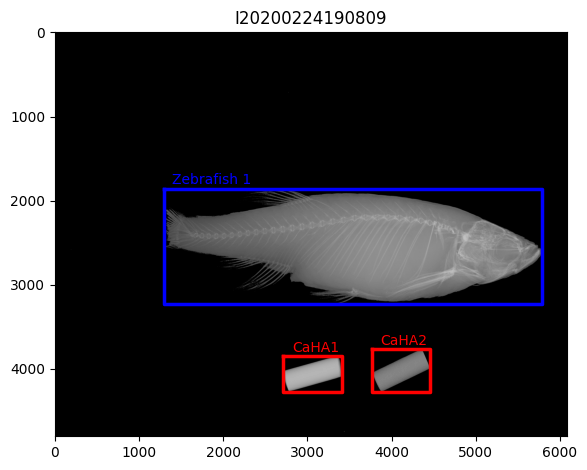

Progress:  28%|██▊       | 61/216 [04:24<10:26,  4.04s/it]

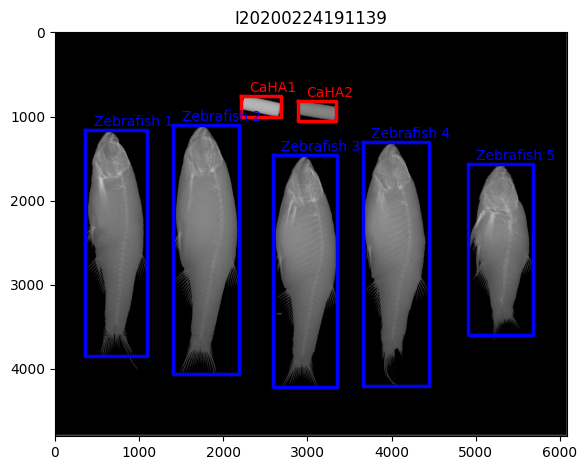

Progress:  29%|██▊       | 62/216 [04:28<10:37,  4.14s/it]

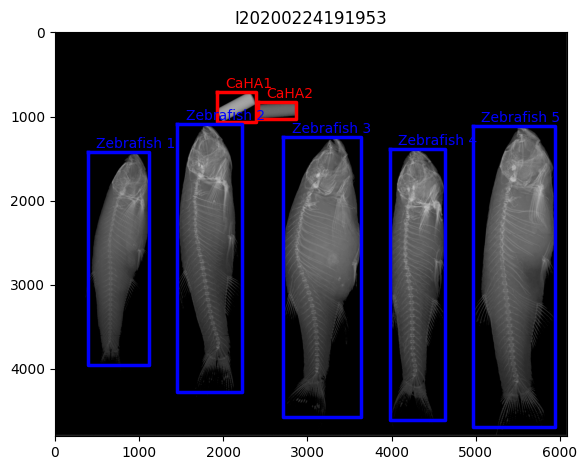

Progress:  29%|██▉       | 63/216 [04:32<10:16,  4.03s/it]

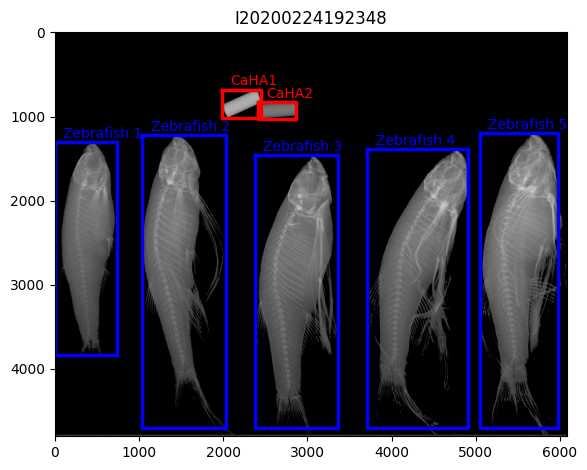

Progress:  30%|██▉       | 64/216 [04:36<10:08,  4.01s/it]

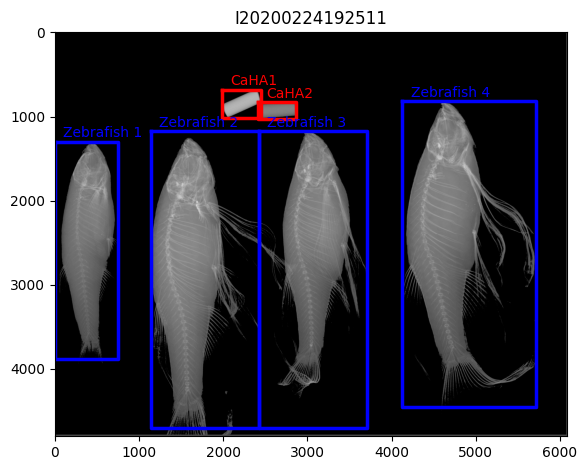

Progress:  30%|███       | 65/216 [04:39<09:56,  3.95s/it]

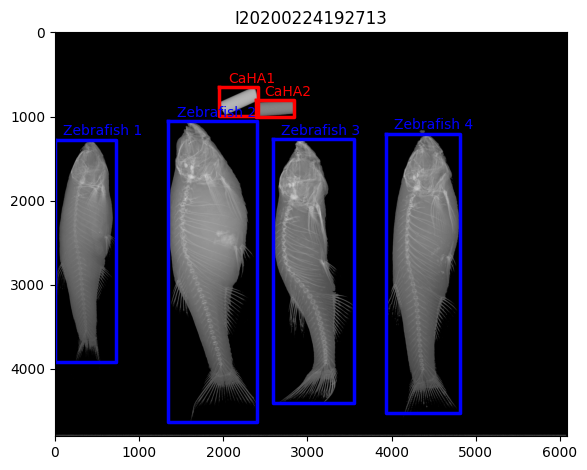

Progress:  31%|███       | 66/216 [04:45<11:08,  4.46s/it]

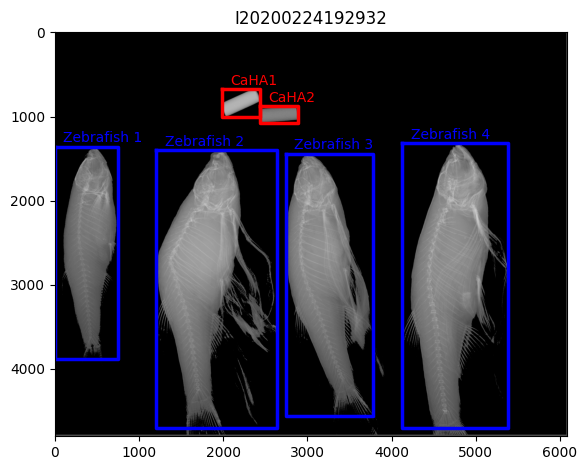

Progress:  31%|███       | 67/216 [04:49<10:45,  4.33s/it]

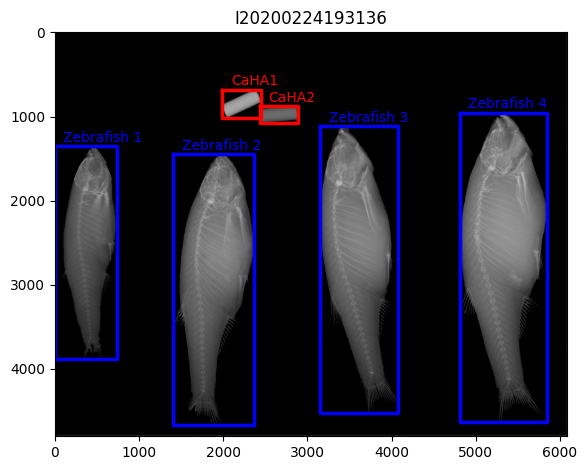

Progress:  31%|███▏      | 68/216 [04:54<11:15,  4.56s/it]

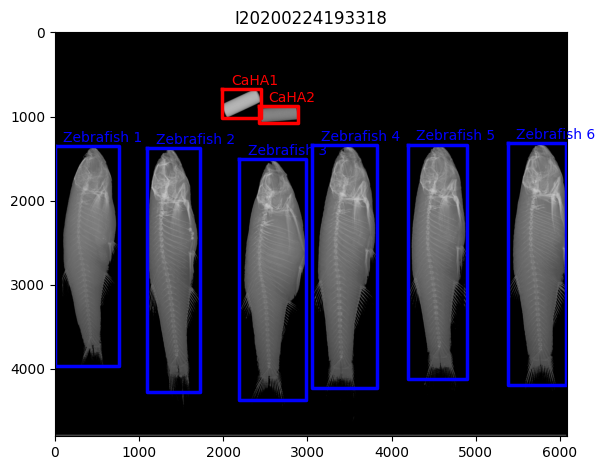

Progress:  32%|███▏      | 69/216 [05:01<13:05,  5.34s/it]

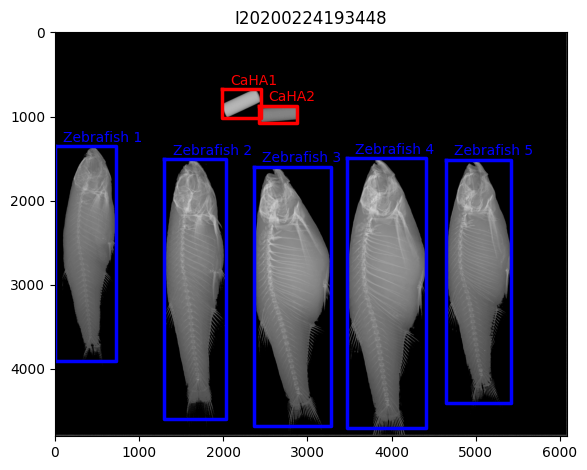

Progress:  32%|███▏      | 70/216 [05:06<12:38,  5.19s/it]

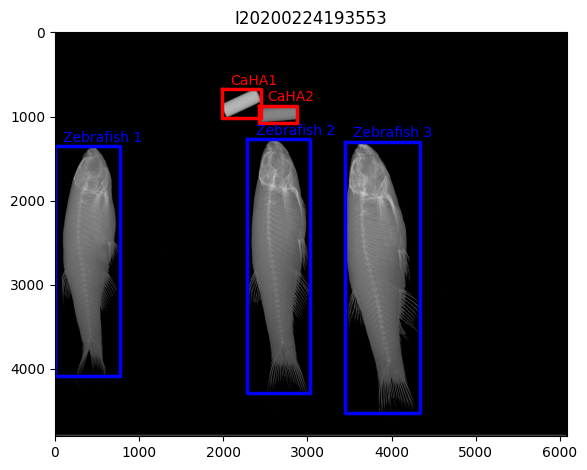

Progress:  33%|███▎      | 71/216 [05:10<11:19,  4.69s/it]

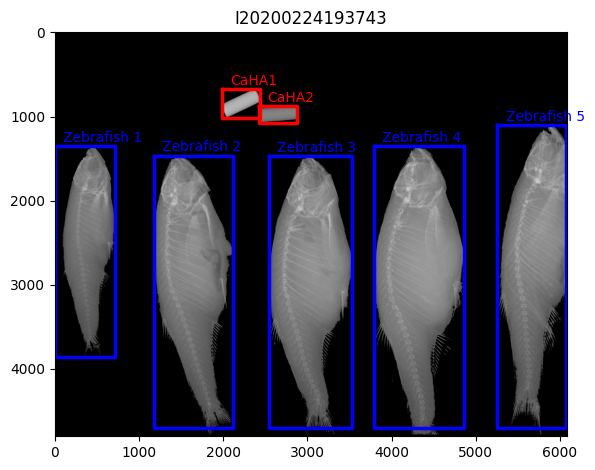

Progress:  33%|███▎      | 72/216 [05:16<12:25,  5.18s/it]

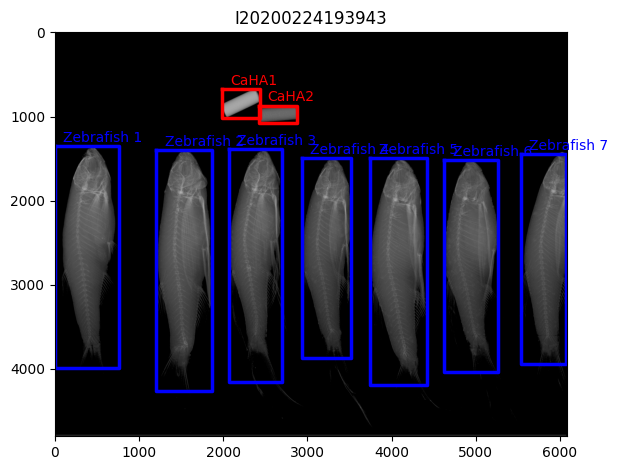

Progress:  34%|███▍      | 73/216 [05:21<12:11,  5.12s/it]

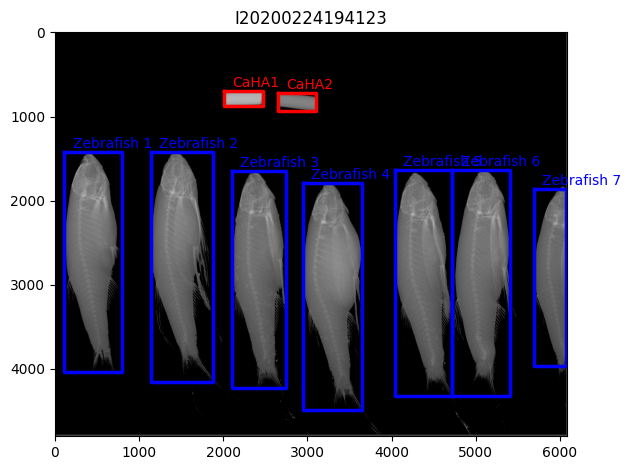

Progress:  34%|███▍      | 74/216 [05:26<12:00,  5.07s/it]

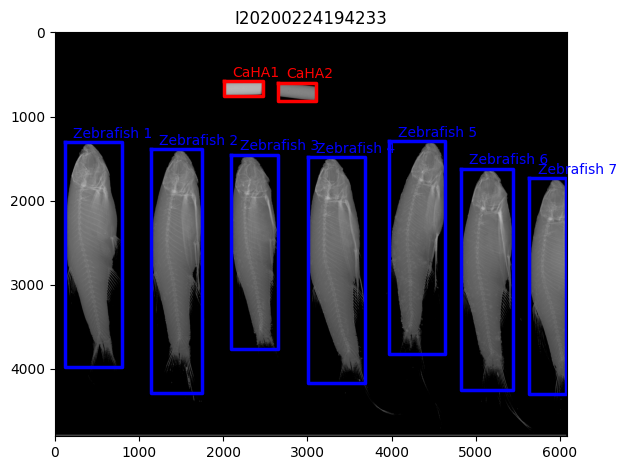

Progress:  35%|███▍      | 75/216 [05:31<12:00,  5.11s/it]

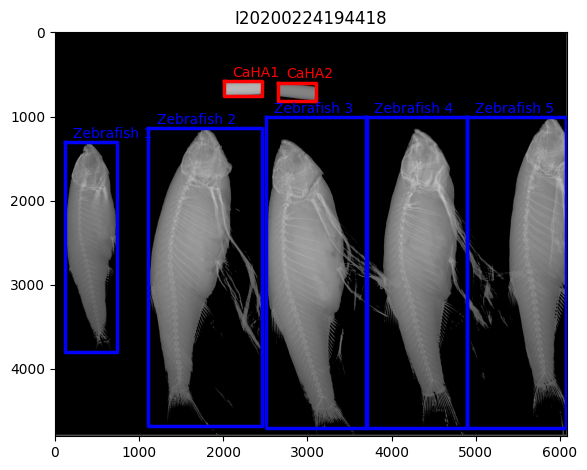

Progress:  35%|███▌      | 76/216 [05:36<11:33,  4.95s/it]

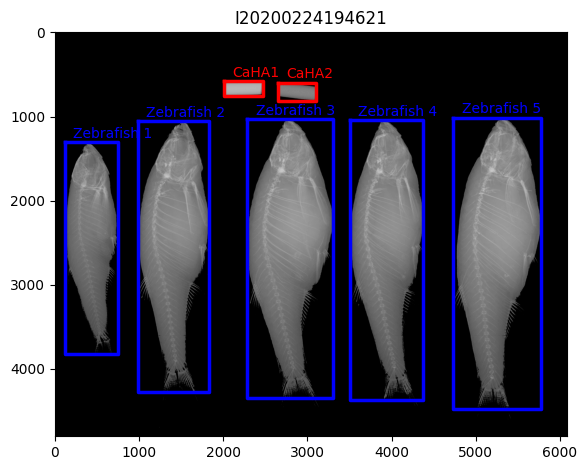

Progress:  36%|███▌      | 77/216 [05:40<10:58,  4.73s/it]

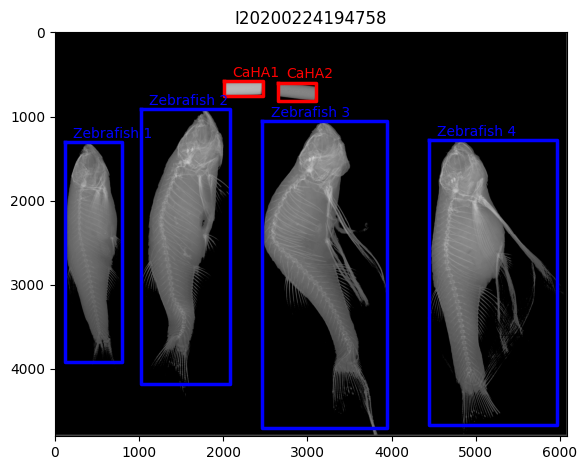

Progress:  36%|███▌      | 78/216 [05:44<10:21,  4.50s/it]

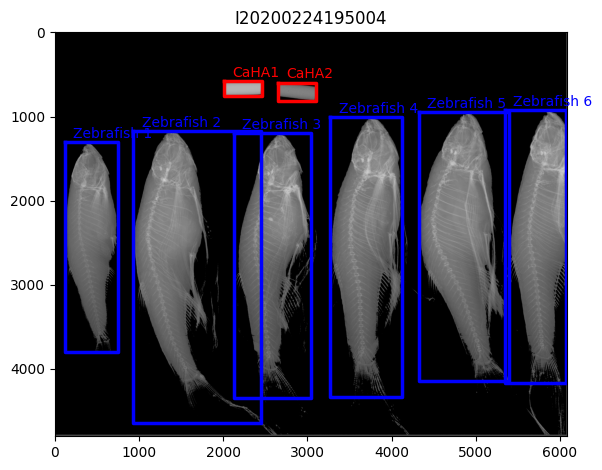

Progress:  37%|███▋      | 79/216 [05:50<11:23,  4.99s/it]

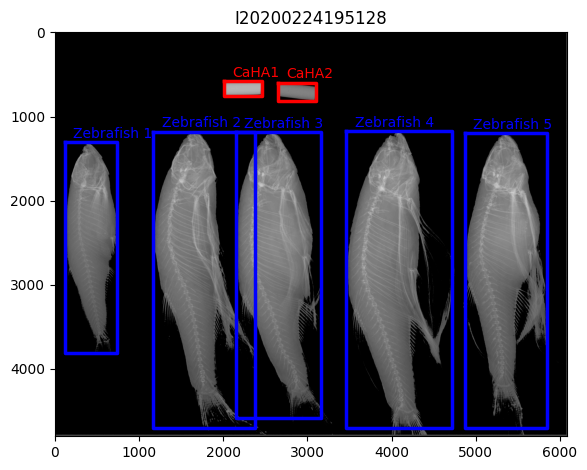

Progress:  37%|███▋      | 80/216 [05:54<10:16,  4.53s/it]

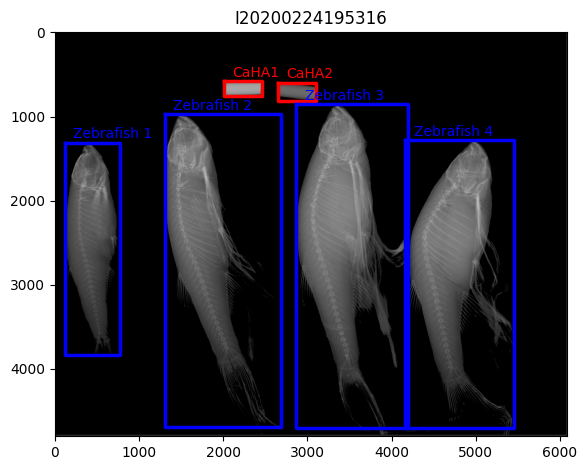

Progress:  38%|███▊      | 81/216 [05:57<09:32,  4.24s/it]

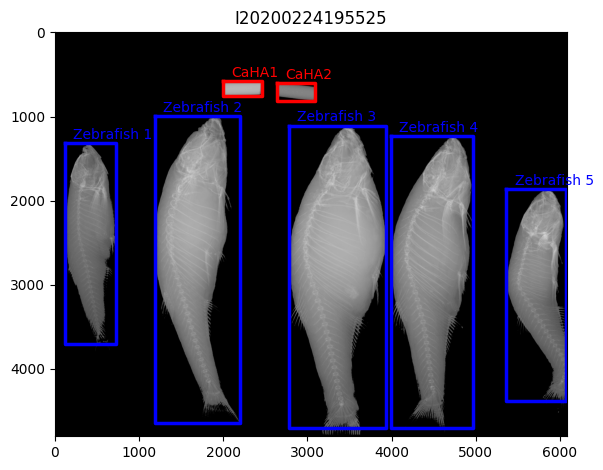

Progress:  38%|███▊      | 82/216 [06:02<09:48,  4.39s/it]

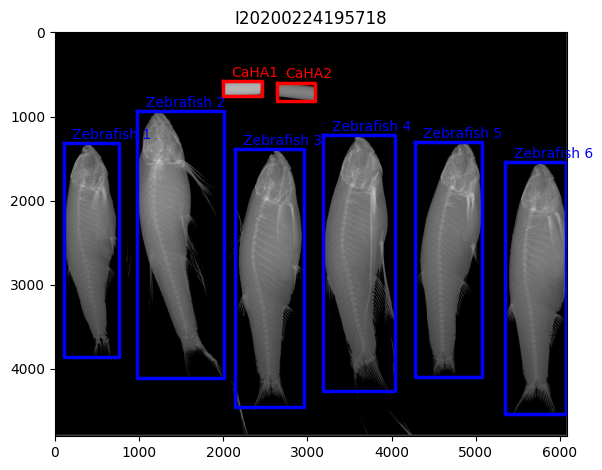

Progress:  38%|███▊      | 83/216 [06:07<09:57,  4.49s/it]

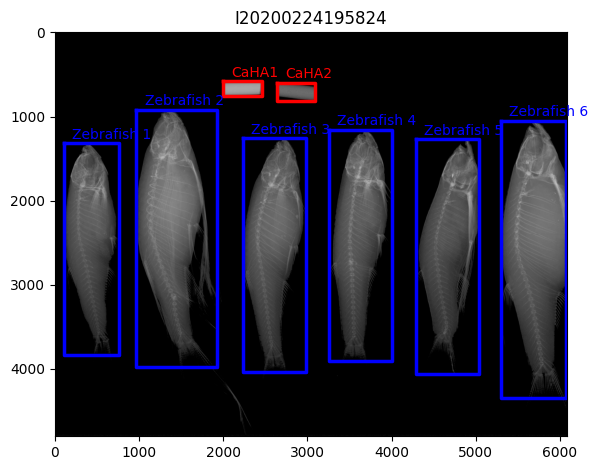

Progress:  39%|███▉      | 84/216 [06:10<09:17,  4.22s/it]

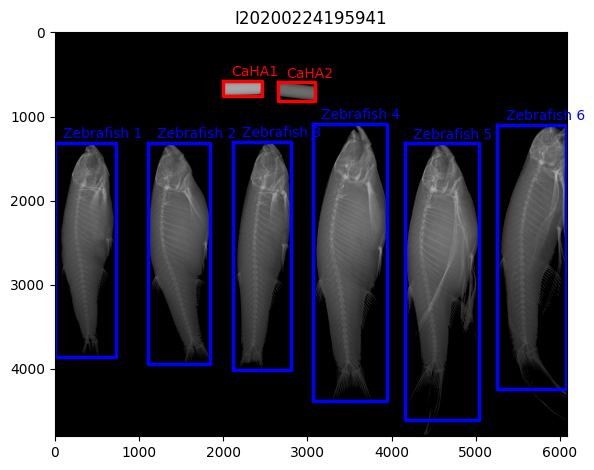

Progress:  39%|███▉      | 85/216 [06:14<09:08,  4.18s/it]

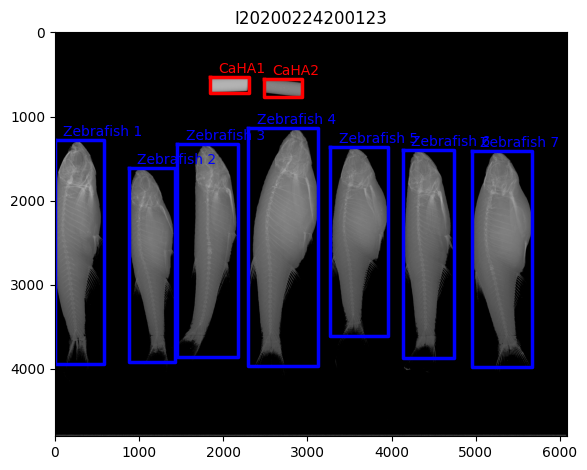

Progress:  40%|███▉      | 86/216 [06:20<10:21,  4.78s/it]

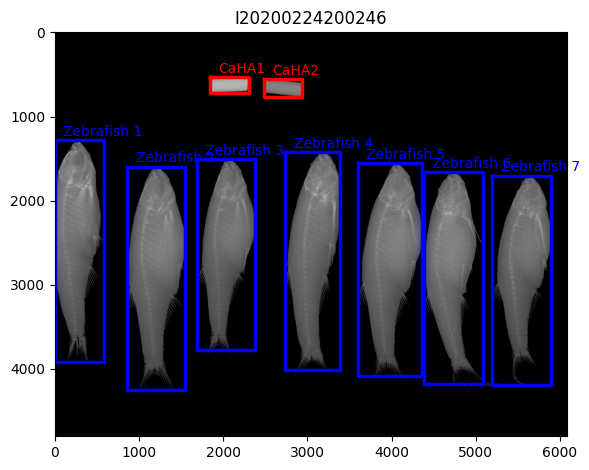

Progress:  40%|████      | 87/216 [06:25<10:16,  4.78s/it]

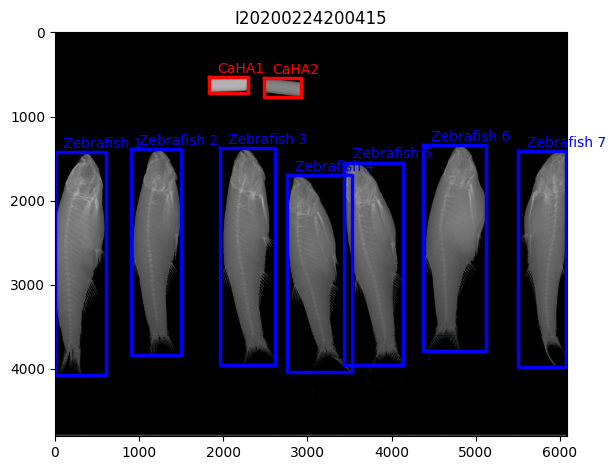

Progress:  41%|████      | 88/216 [06:29<09:51,  4.62s/it]

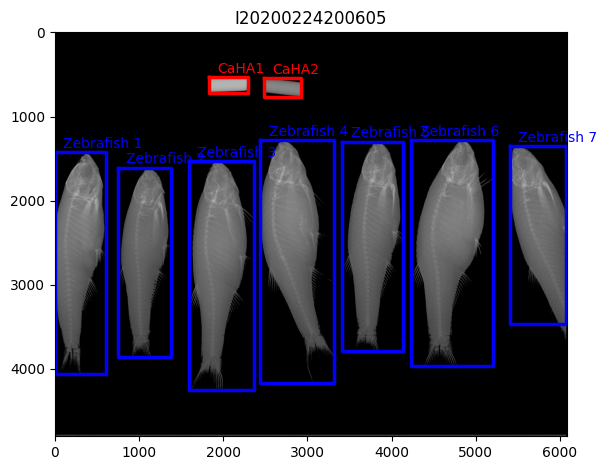

Progress:  41%|████      | 89/216 [06:34<10:00,  4.73s/it]

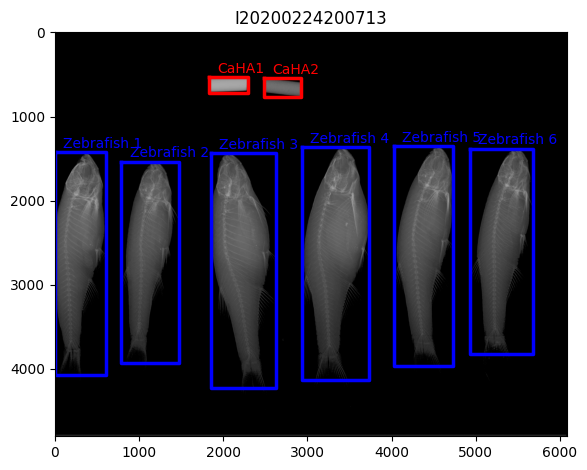

Progress:  42%|████▏     | 90/216 [06:39<09:56,  4.73s/it]

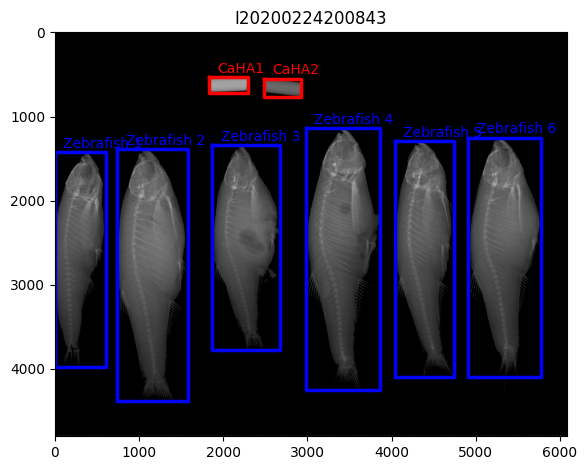

Progress:  42%|████▏     | 91/216 [06:43<09:15,  4.44s/it]

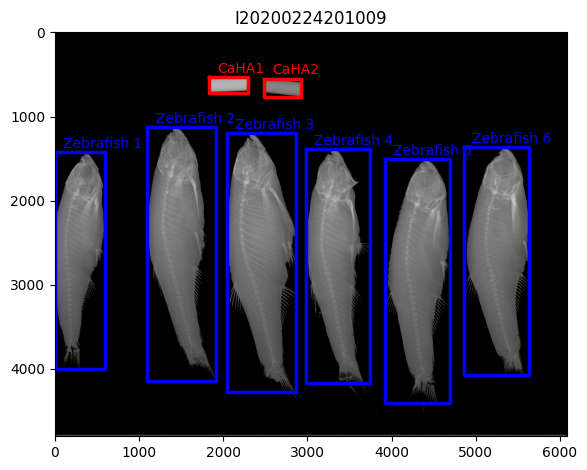

Progress:  43%|████▎     | 92/216 [06:47<08:44,  4.23s/it]

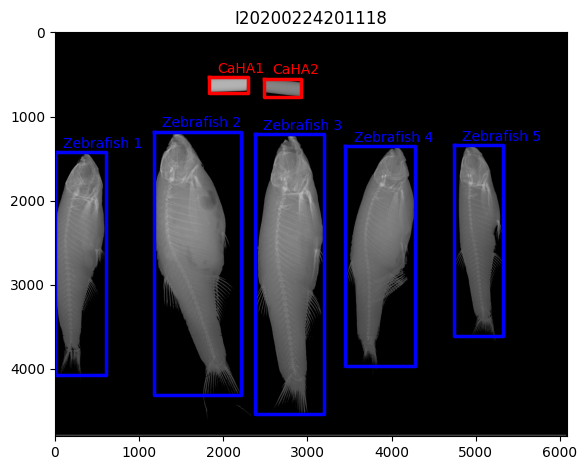

Progress:  43%|████▎     | 93/216 [06:53<09:52,  4.81s/it]

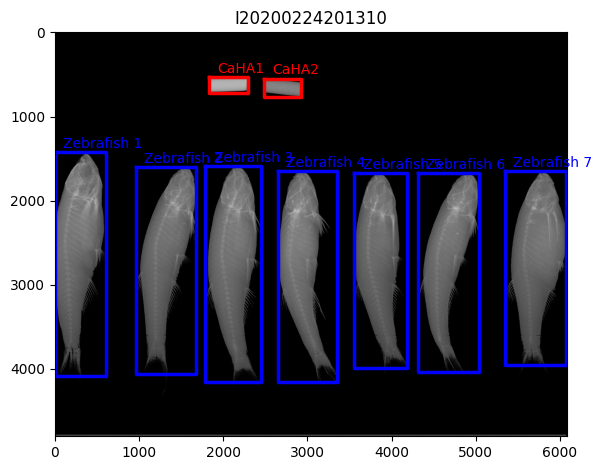

Progress:  44%|████▎     | 94/216 [06:58<10:08,  4.99s/it]

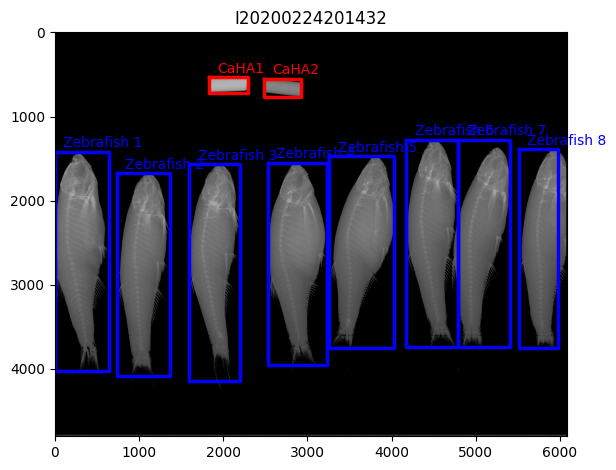

Progress:  44%|████▍     | 95/216 [07:02<09:30,  4.71s/it]

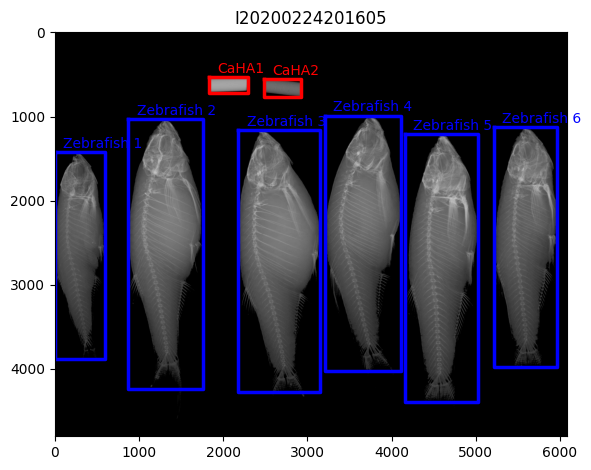

Progress:  44%|████▍     | 96/216 [07:06<08:31,  4.26s/it]

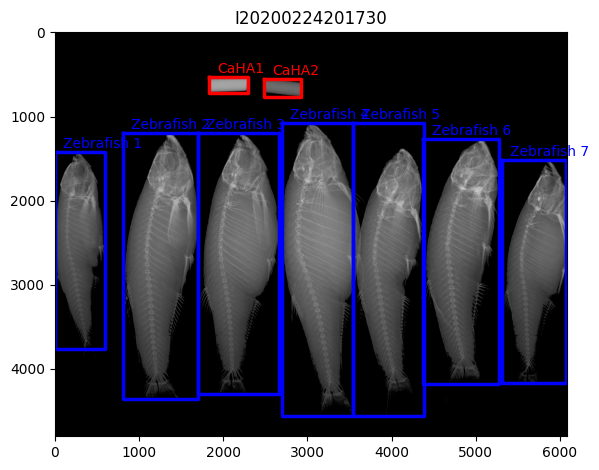

Progress:  45%|████▍     | 97/216 [07:10<08:43,  4.40s/it]

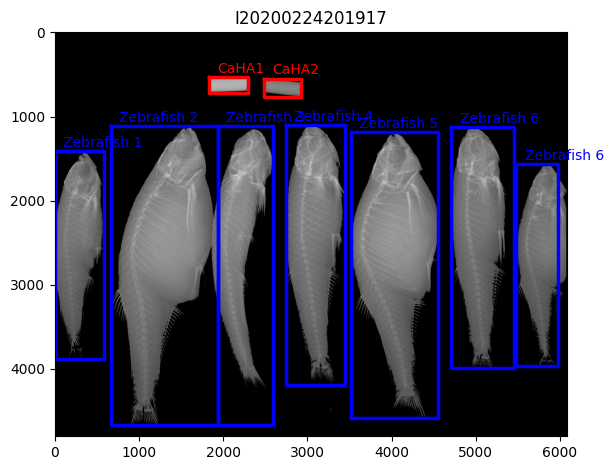

Progress:  45%|████▌     | 98/216 [07:14<08:29,  4.32s/it]

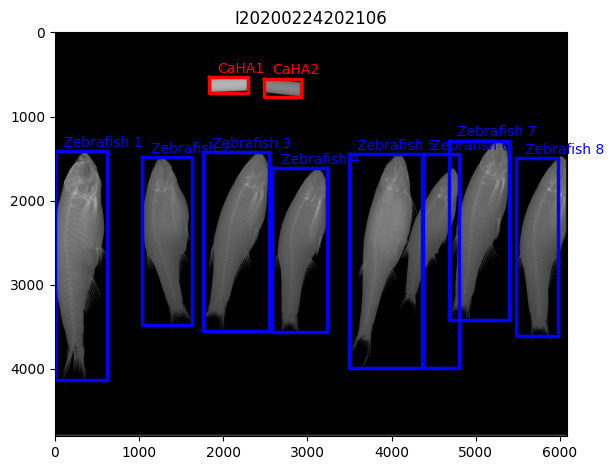

Progress:  46%|████▌     | 99/216 [07:19<08:28,  4.34s/it]

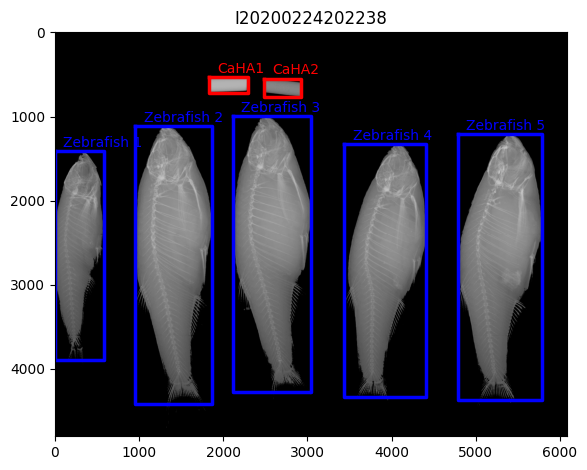

Progress:  46%|████▋     | 100/216 [07:23<08:19,  4.30s/it]

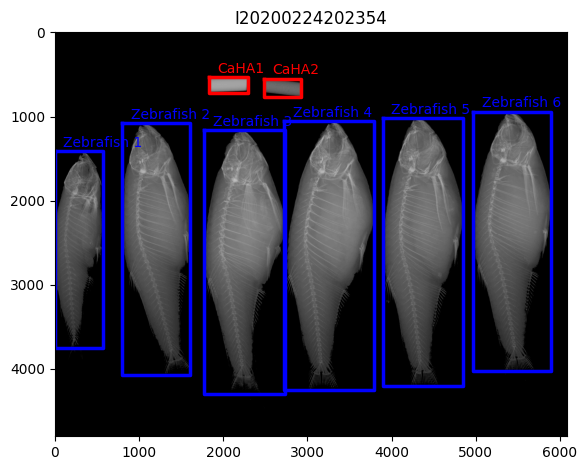

Progress:  47%|████▋     | 101/216 [07:28<08:51,  4.62s/it]

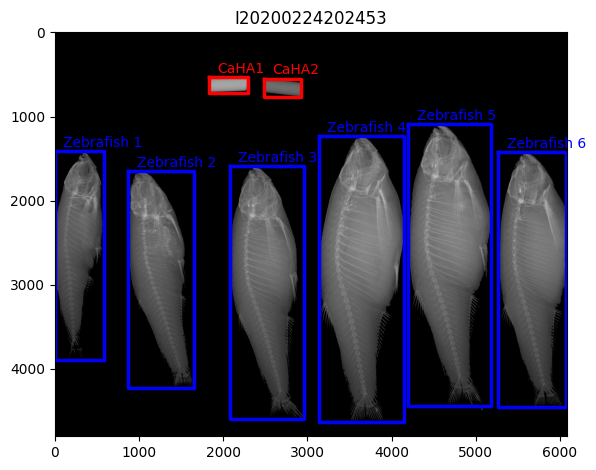

Progress:  47%|████▋     | 102/216 [07:32<08:24,  4.42s/it]

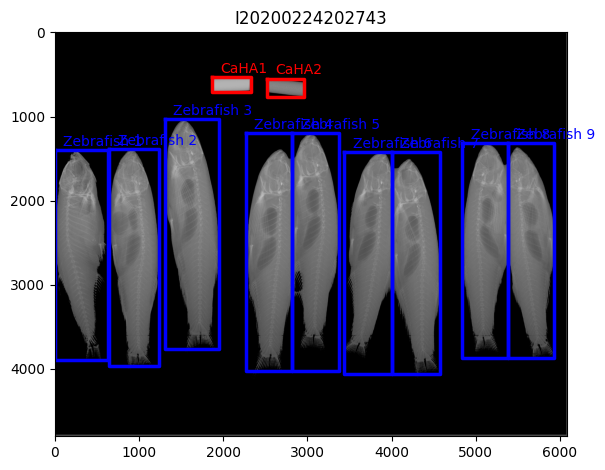

Progress:  48%|████▊     | 103/216 [07:36<08:09,  4.34s/it]

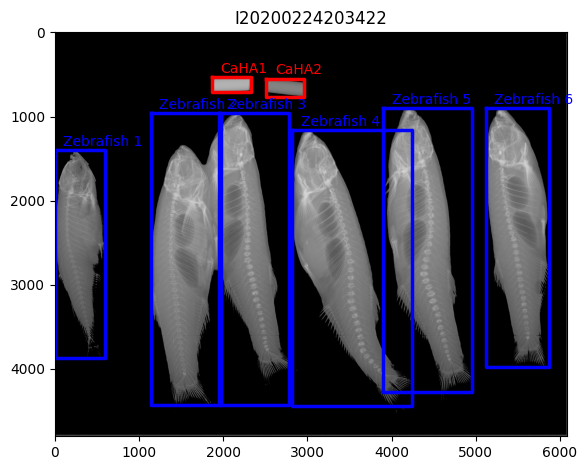

Progress:  48%|████▊     | 104/216 [07:41<08:12,  4.40s/it]

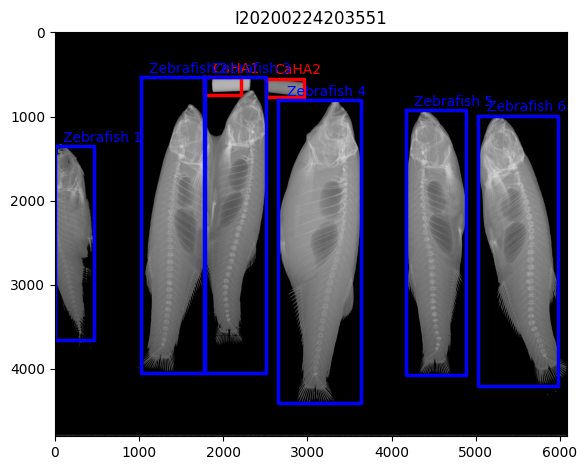

Progress:  49%|████▊     | 105/216 [07:46<08:24,  4.55s/it]

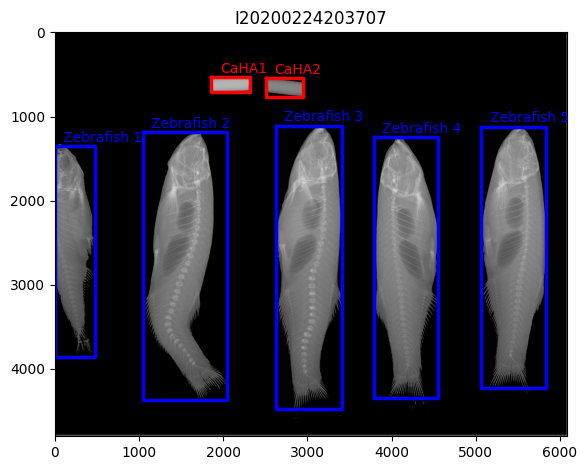

Progress:  49%|████▉     | 106/216 [07:50<08:11,  4.47s/it]

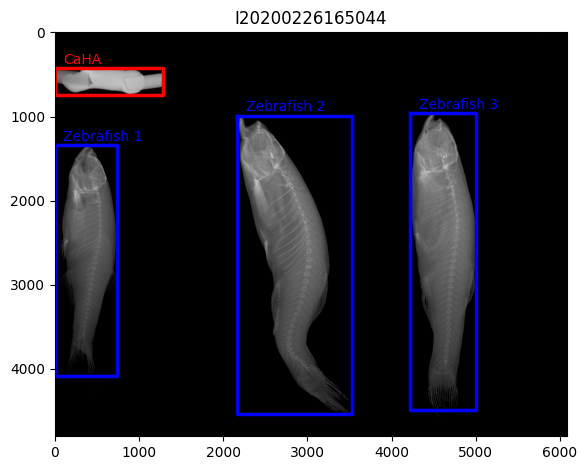

Progress:  50%|████▉     | 107/216 [07:55<08:30,  4.68s/it]

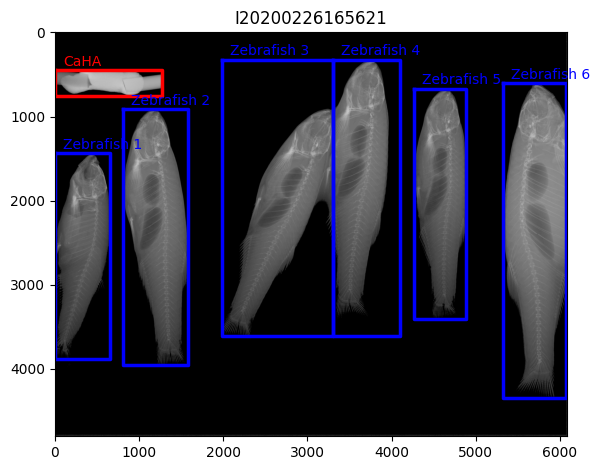

Progress:  50%|█████     | 108/216 [08:01<08:49,  4.90s/it]

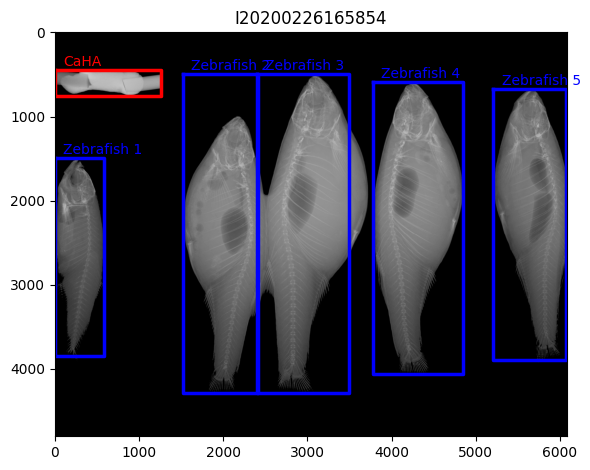

Progress:  50%|█████     | 109/216 [08:05<08:09,  4.58s/it]

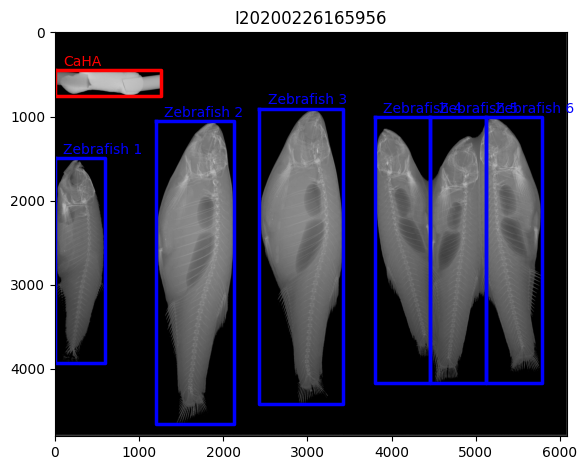

Progress:  51%|█████     | 110/216 [08:08<07:39,  4.33s/it]

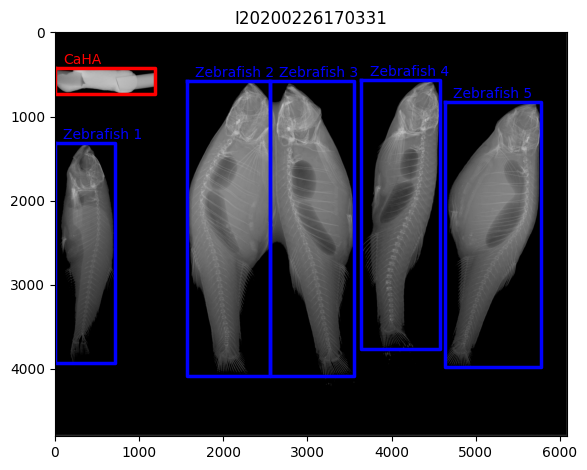

Progress:  51%|█████▏    | 111/216 [08:12<07:18,  4.17s/it]

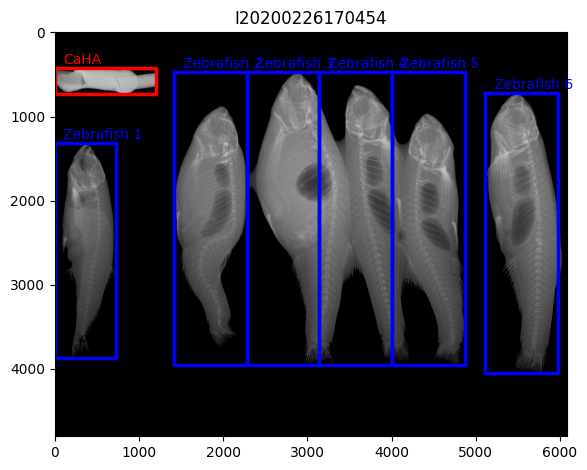

Progress:  52%|█████▏    | 112/216 [08:17<07:45,  4.48s/it]

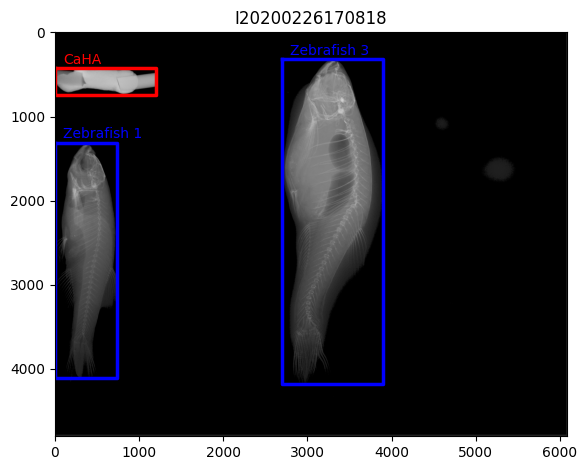

Progress:  52%|█████▏    | 113/216 [08:21<07:27,  4.34s/it]

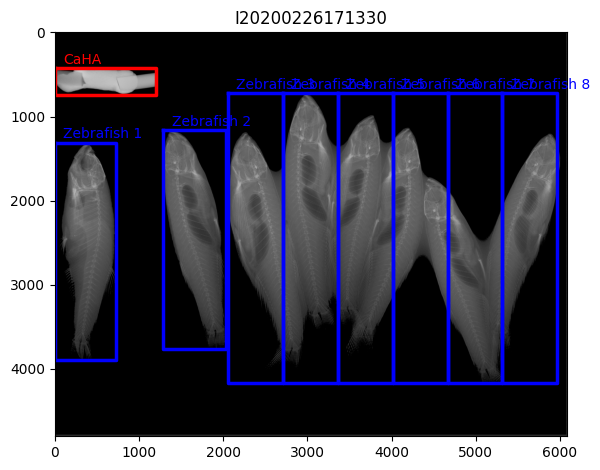

Progress:  53%|█████▎    | 114/216 [08:25<07:10,  4.22s/it]

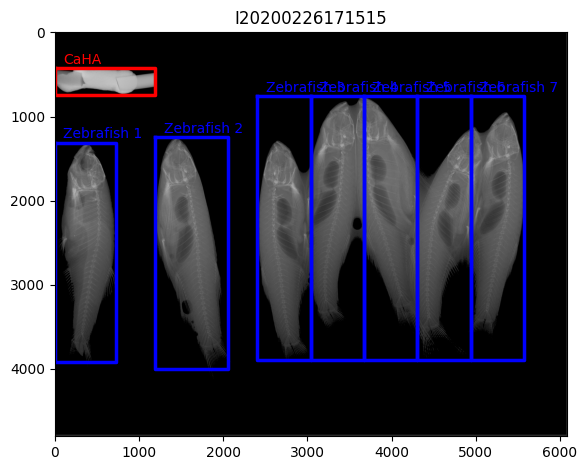

Progress:  53%|█████▎    | 115/216 [08:30<07:25,  4.41s/it]

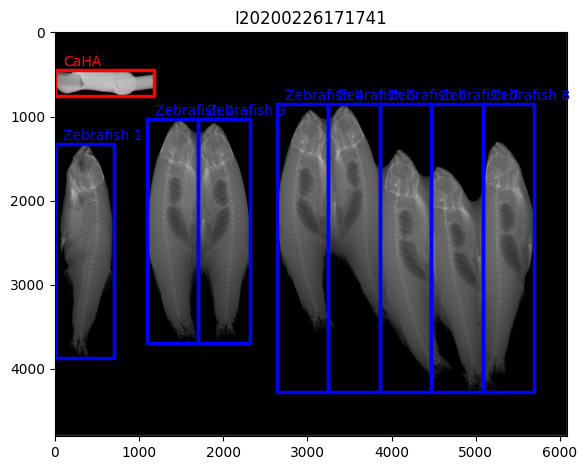

Progress:  54%|█████▎    | 116/216 [08:35<07:26,  4.47s/it]

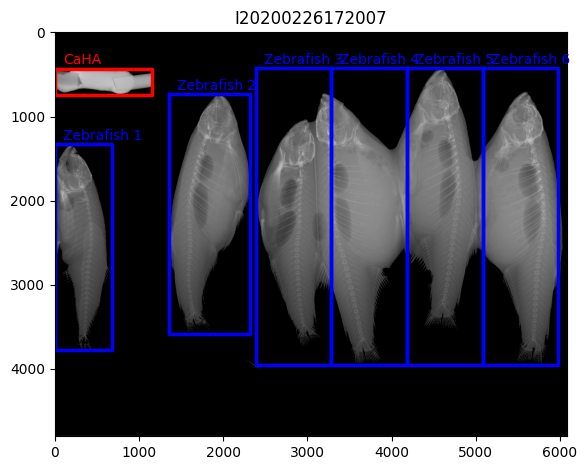

Progress:  54%|█████▍    | 117/216 [08:39<07:09,  4.34s/it]

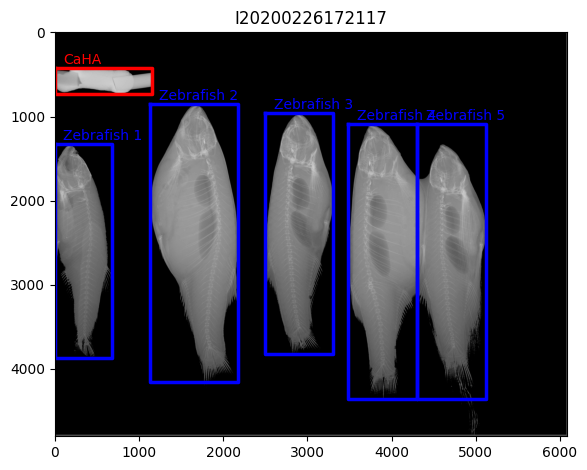

Progress:  55%|█████▍    | 118/216 [08:43<06:56,  4.25s/it]

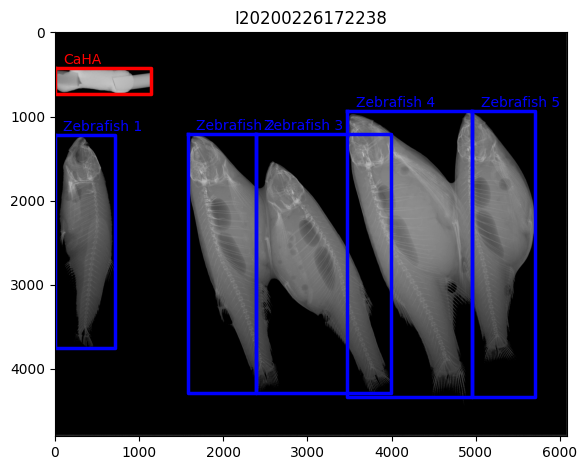

Progress:  55%|█████▌    | 119/216 [08:48<07:21,  4.55s/it]

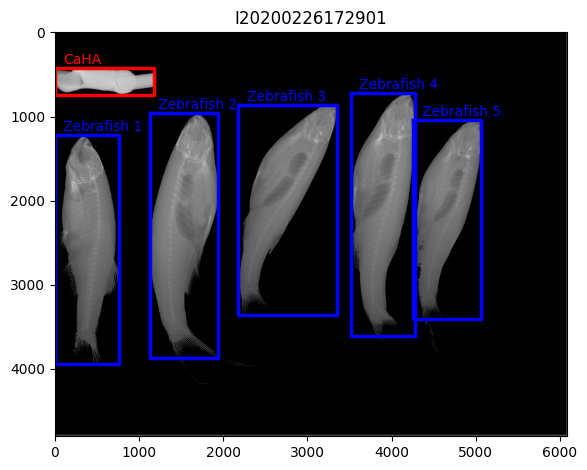

Progress:  56%|█████▌    | 120/216 [08:52<07:09,  4.47s/it]

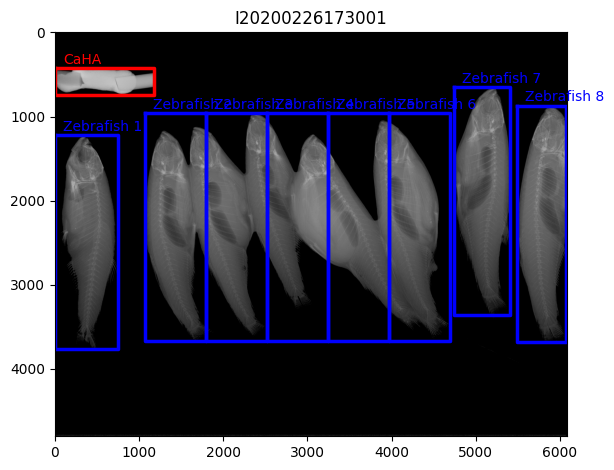

Progress:  56%|█████▌    | 121/216 [08:57<06:56,  4.39s/it]

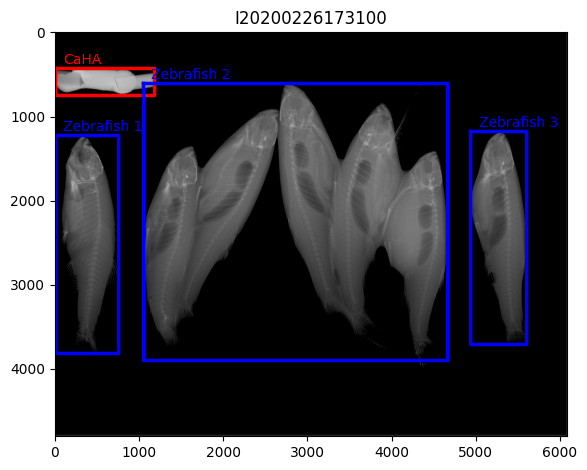

Progress:  56%|█████▋    | 122/216 [09:01<06:50,  4.36s/it]

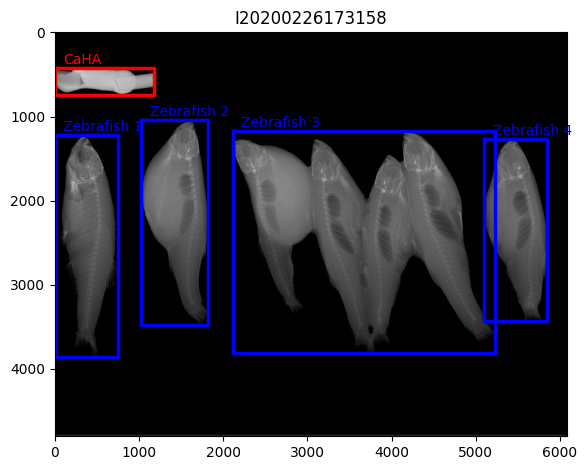

Progress:  57%|█████▋    | 123/216 [09:06<07:16,  4.70s/it]

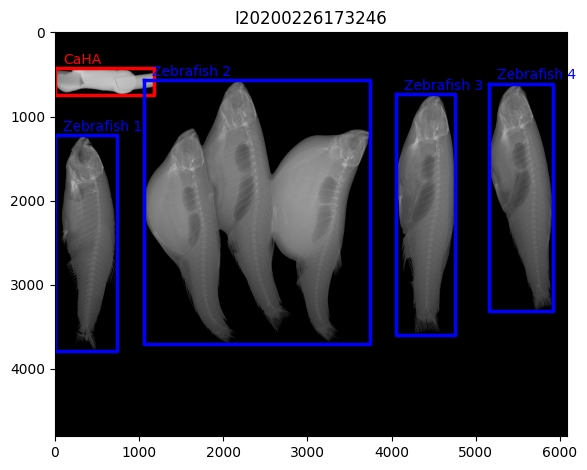

Progress:  57%|█████▋    | 124/216 [09:10<06:45,  4.40s/it]

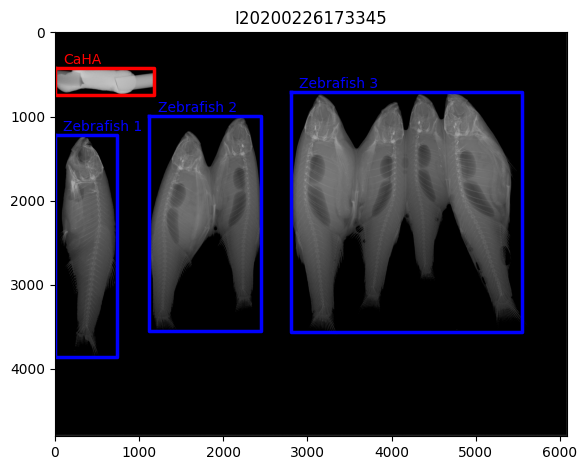

Progress:  58%|█████▊    | 125/216 [09:14<06:17,  4.15s/it]

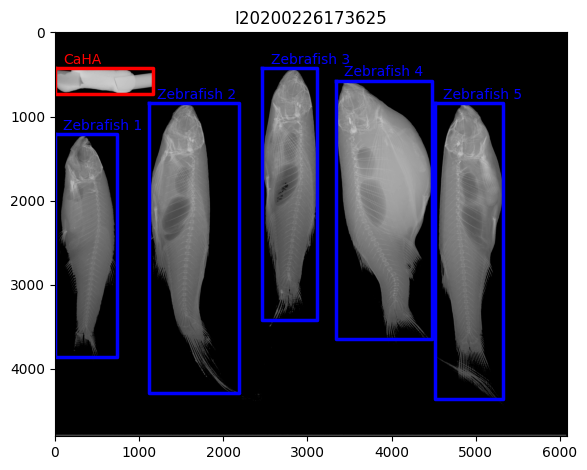

Progress:  58%|█████▊    | 126/216 [09:19<06:40,  4.45s/it]

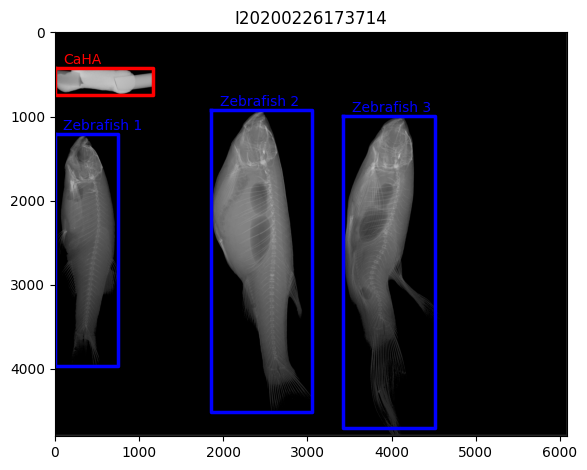

Progress:  59%|█████▉    | 127/216 [09:22<06:07,  4.13s/it]

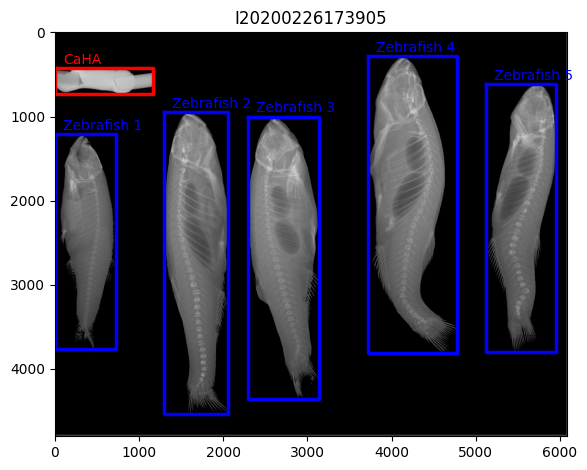

Progress:  59%|█████▉    | 128/216 [09:26<05:49,  3.98s/it]

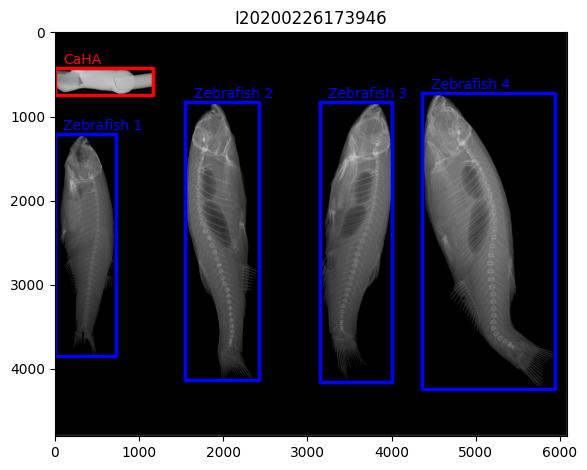

Progress:  60%|█████▉    | 129/216 [09:30<05:39,  3.91s/it]

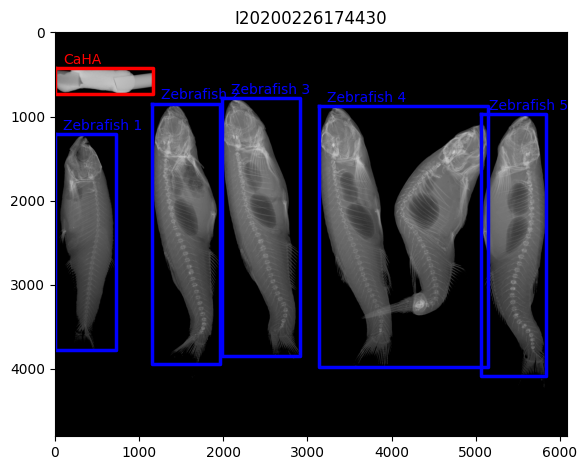

Progress:  60%|██████    | 130/216 [09:35<06:05,  4.25s/it]

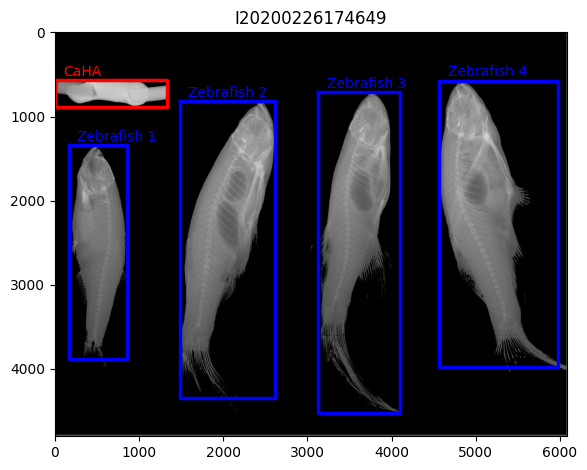

Progress:  61%|██████    | 131/216 [09:39<05:56,  4.20s/it]

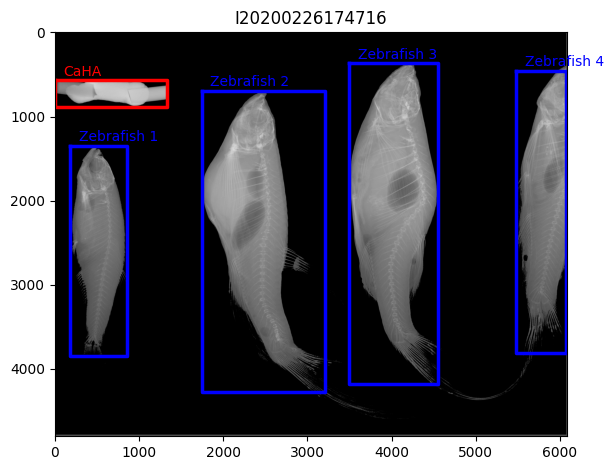

Progress:  61%|██████    | 132/216 [09:43<05:46,  4.12s/it]

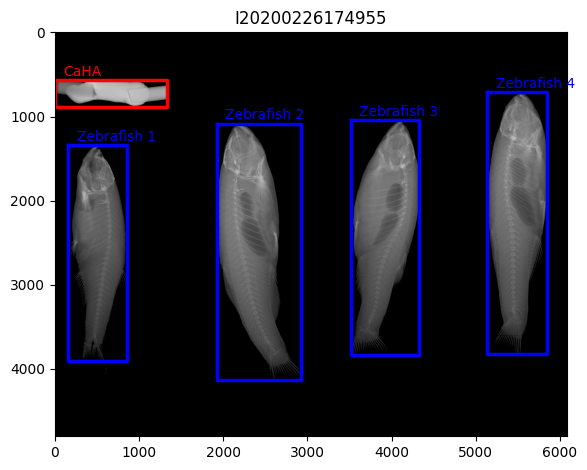

Progress:  62%|██████▏   | 133/216 [09:47<05:47,  4.18s/it]

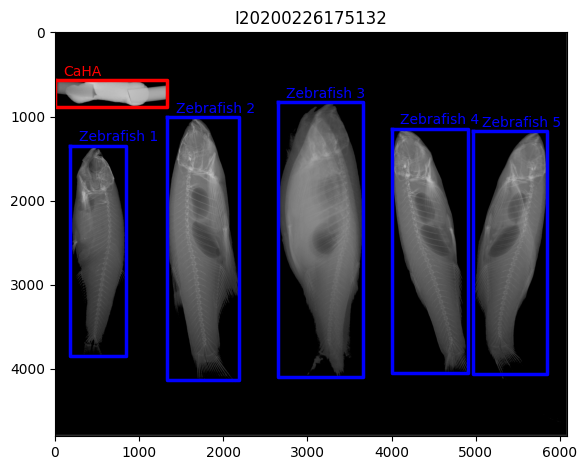

Progress:  62%|██████▏   | 134/216 [09:52<06:05,  4.46s/it]

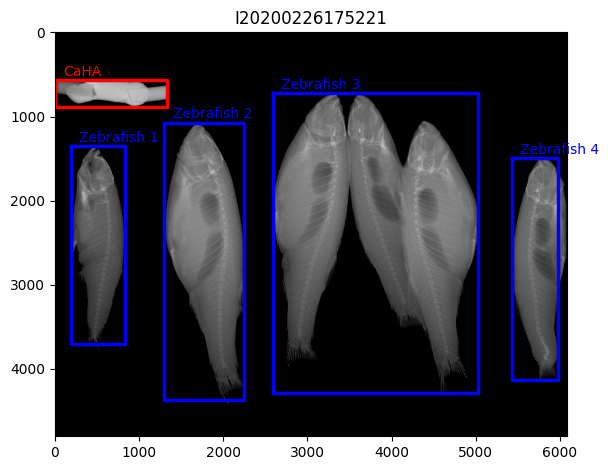

Progress:  62%|██████▎   | 135/216 [09:56<05:50,  4.33s/it]

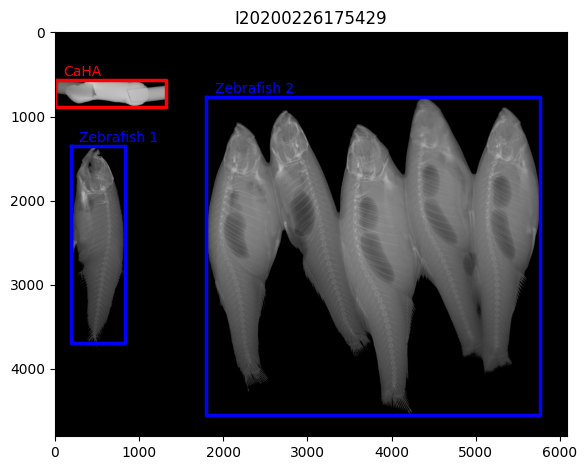

Progress:  63%|██████▎   | 136/216 [10:00<05:41,  4.26s/it]

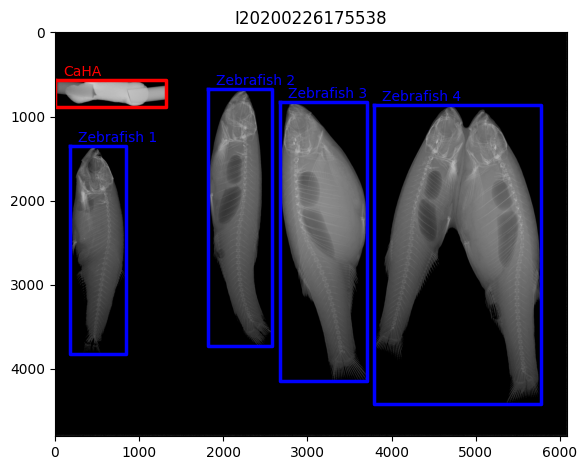

Progress:  63%|██████▎   | 137/216 [10:06<06:14,  4.73s/it]

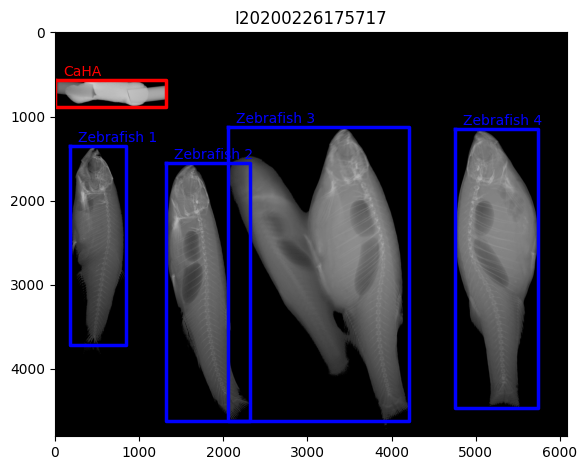

Progress:  64%|██████▍   | 138/216 [10:10<05:54,  4.55s/it]

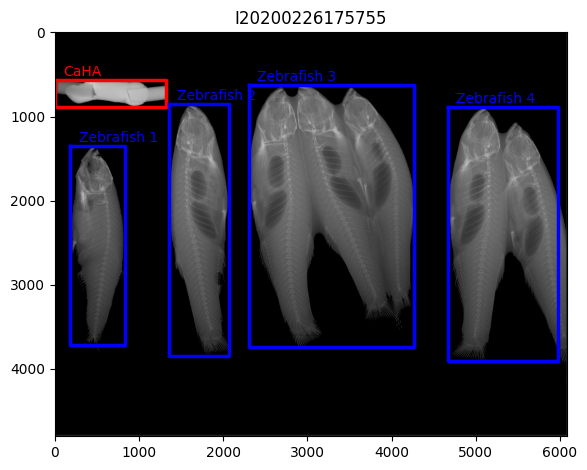

Progress:  64%|██████▍   | 139/216 [10:14<05:37,  4.38s/it]

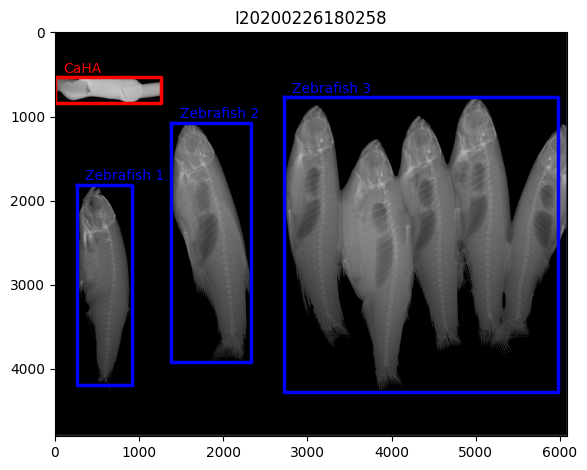

Progress:  65%|██████▍   | 140/216 [10:19<05:55,  4.68s/it]

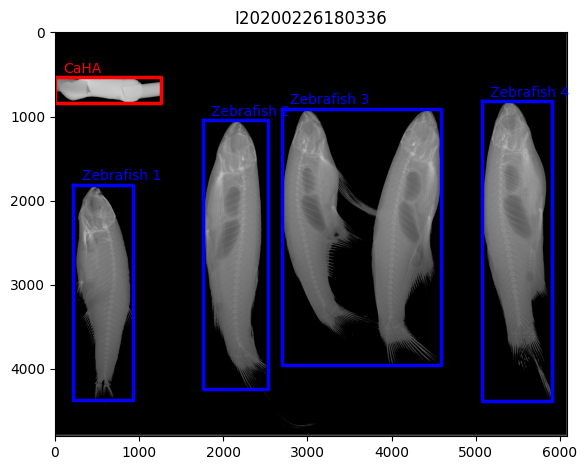

Progress:  65%|██████▌   | 141/216 [10:24<05:57,  4.76s/it]

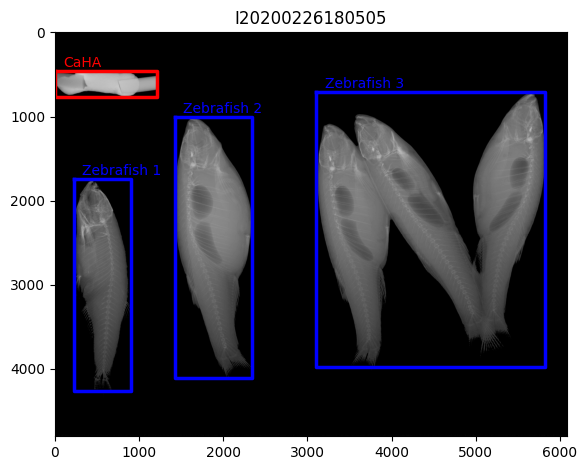

Progress:  66%|██████▌   | 142/216 [10:28<05:18,  4.30s/it]

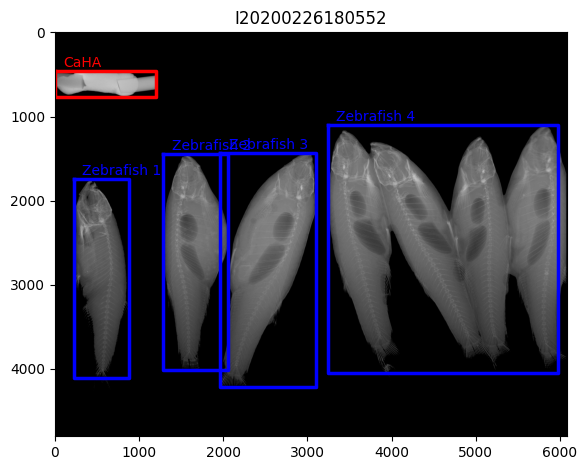

Progress:  66%|██████▌   | 143/216 [10:32<05:12,  4.28s/it]

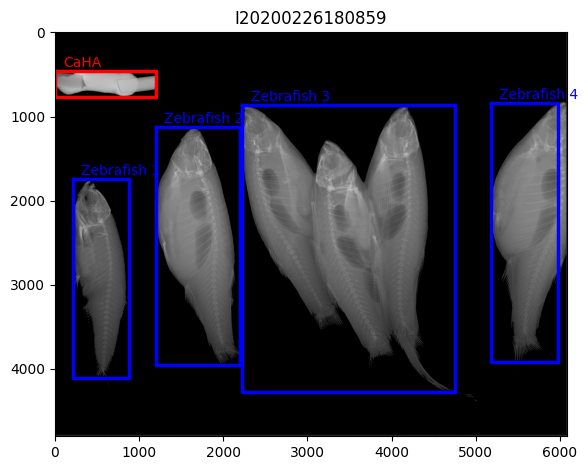

Progress:  67%|██████▋   | 144/216 [10:37<05:30,  4.59s/it]

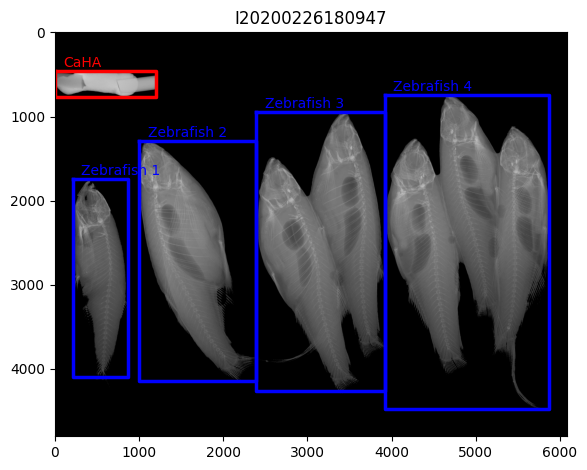

Progress:  67%|██████▋   | 145/216 [10:41<05:09,  4.36s/it]

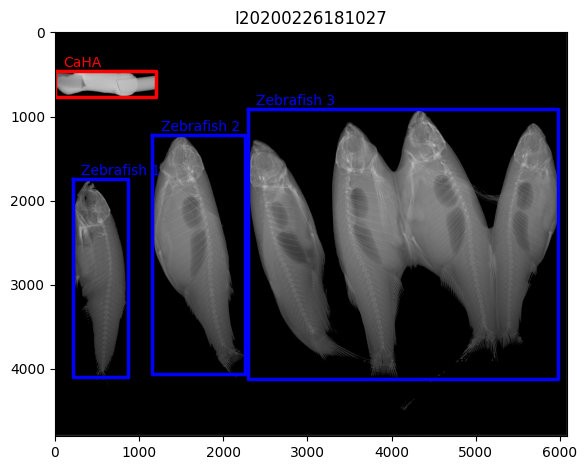

Progress:  68%|██████▊   | 146/216 [10:44<04:41,  4.02s/it]

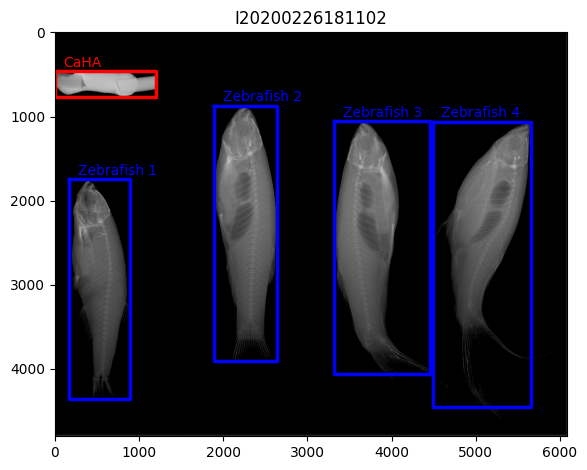

Progress:  68%|██████▊   | 147/216 [10:48<04:29,  3.91s/it]

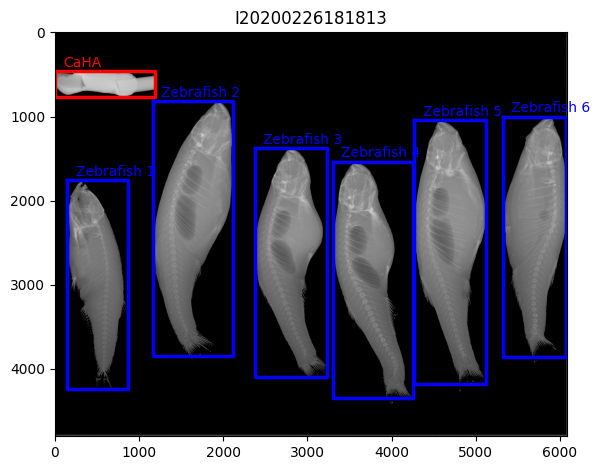

Progress:  69%|██████▊   | 148/216 [10:53<04:50,  4.27s/it]

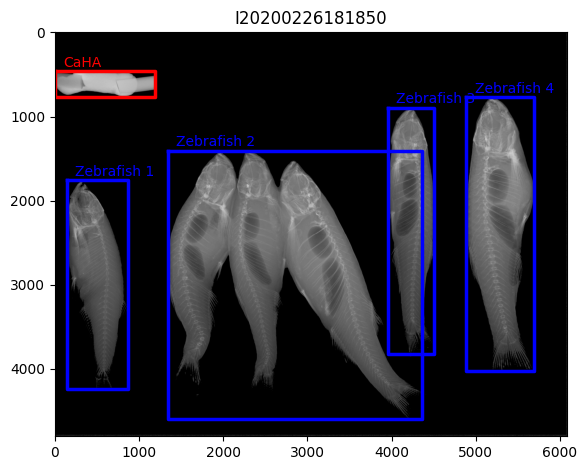

Progress:  69%|██████▉   | 149/216 [10:57<04:38,  4.16s/it]

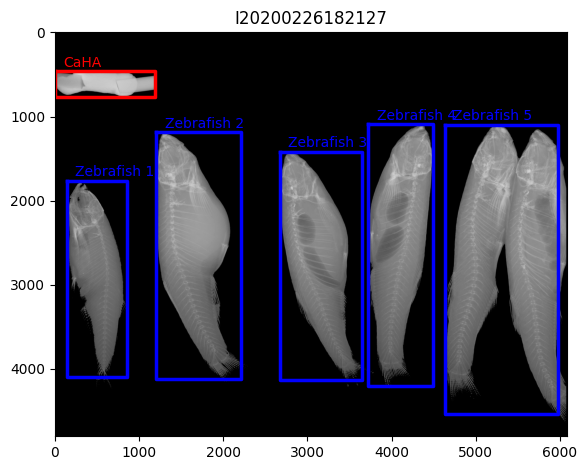

Progress:  69%|██████▉   | 150/216 [11:01<04:25,  4.02s/it]

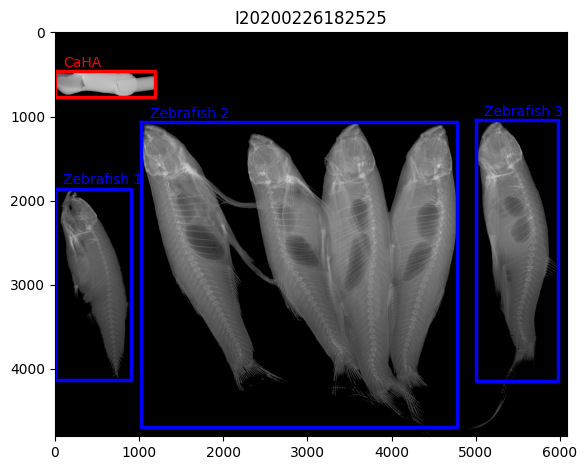

Progress:  70%|██████▉   | 151/216 [11:05<04:20,  4.00s/it]

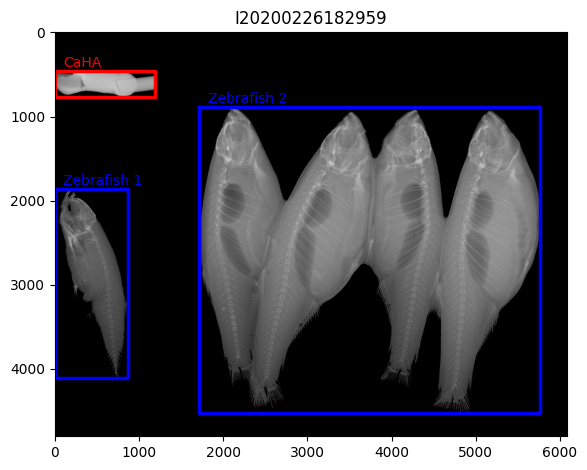

Progress:  70%|███████   | 152/216 [11:10<04:49,  4.52s/it]

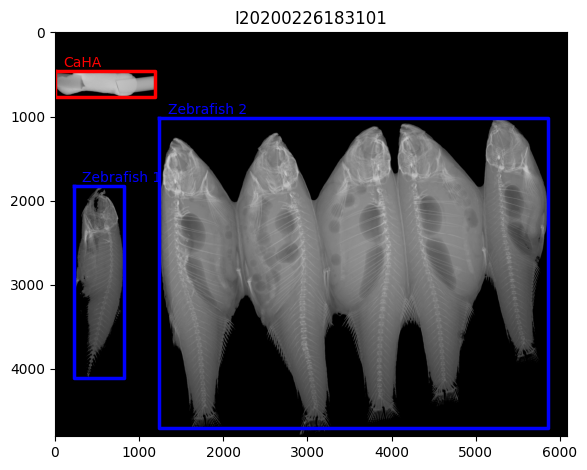

Progress:  71%|███████   | 153/216 [11:18<05:50,  5.57s/it]

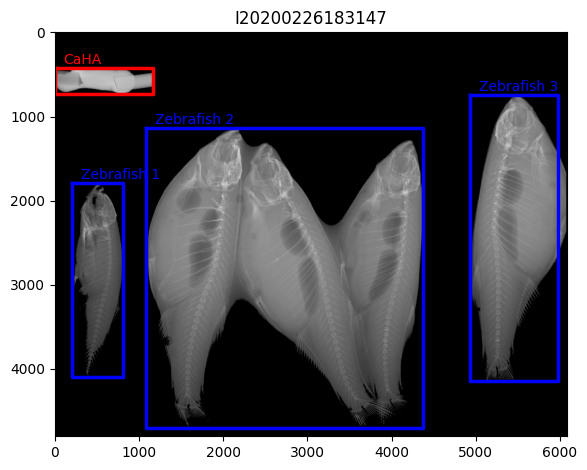

Progress:  71%|███████▏  | 154/216 [11:24<05:52,  5.69s/it]

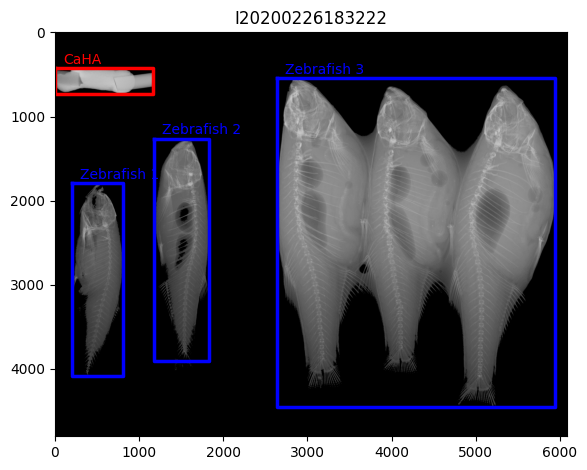

Progress:  72%|███████▏  | 155/216 [11:29<05:25,  5.33s/it]

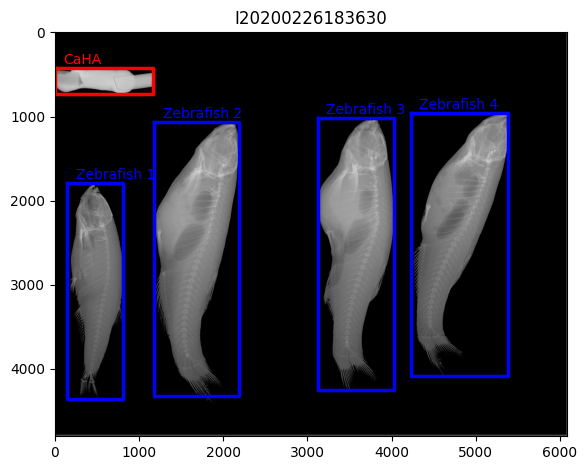

Progress:  72%|███████▏  | 156/216 [11:33<04:57,  4.95s/it]

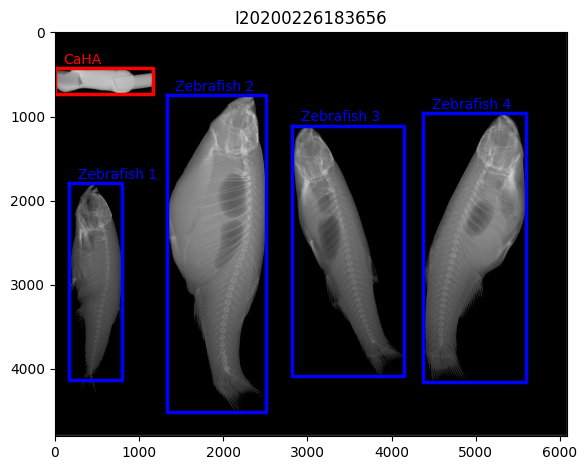

Progress:  73%|███████▎  | 157/216 [11:38<04:47,  4.88s/it]

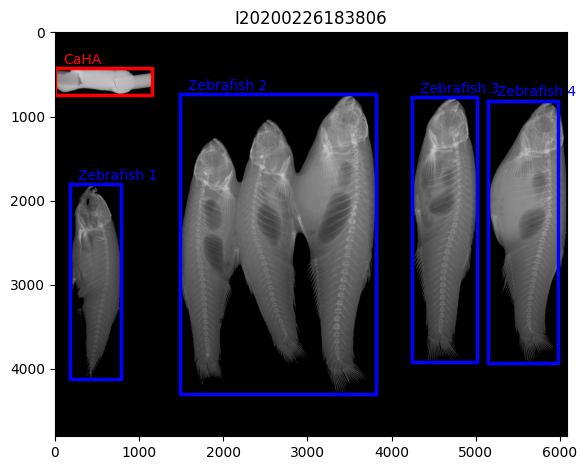

Progress:  73%|███████▎  | 158/216 [11:43<04:51,  5.03s/it]

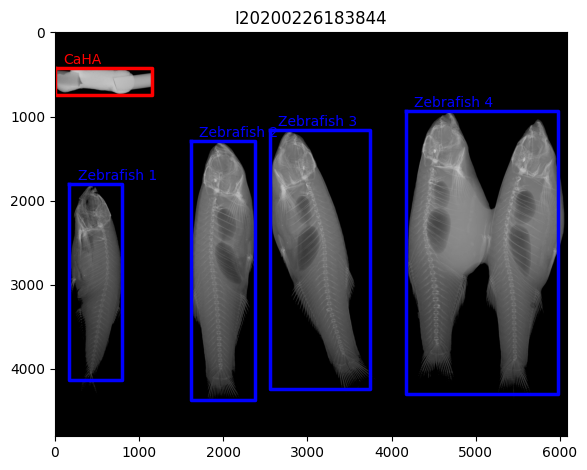

Progress:  74%|███████▎  | 159/216 [11:47<04:31,  4.76s/it]

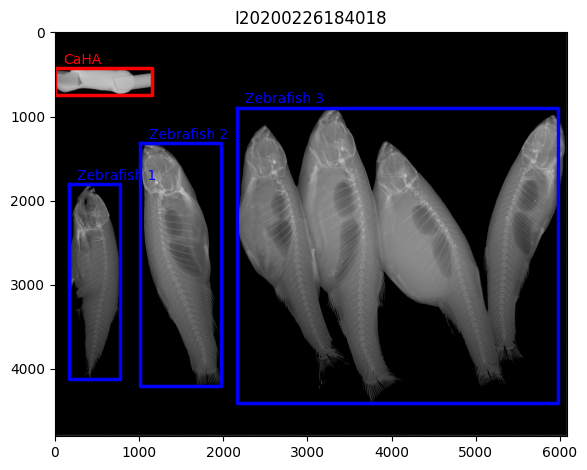

Progress:  74%|███████▍  | 160/216 [11:51<04:11,  4.49s/it]

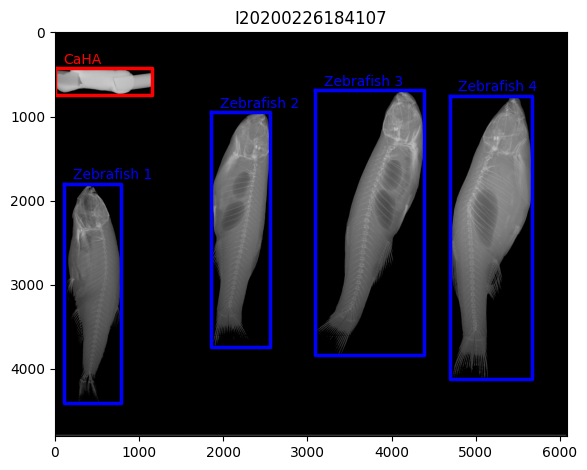

Progress:  75%|███████▍  | 161/216 [11:57<04:30,  4.92s/it]

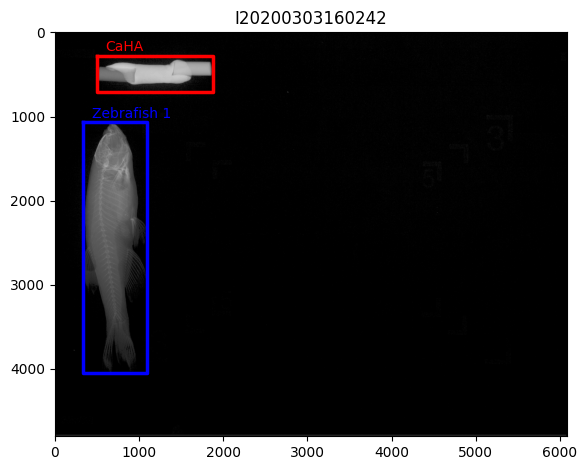

Progress:  75%|███████▌  | 162/216 [12:01<04:09,  4.63s/it]

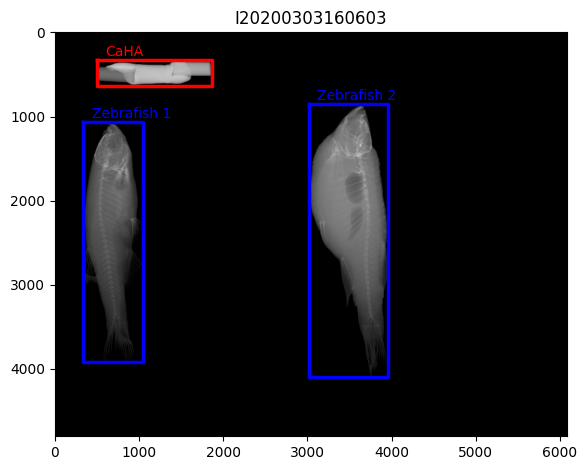

Progress:  75%|███████▌  | 163/216 [12:05<03:55,  4.44s/it]

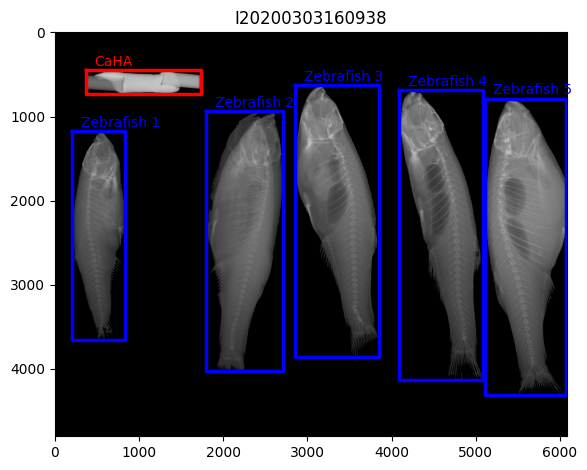

Progress:  76%|███████▌  | 164/216 [12:09<03:46,  4.36s/it]

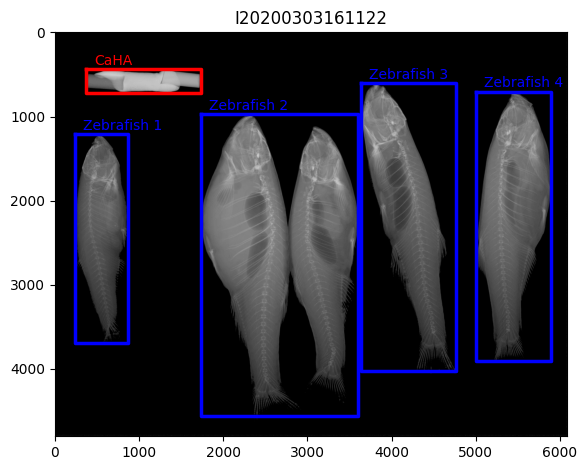

Progress:  76%|███████▋  | 165/216 [12:14<03:56,  4.64s/it]

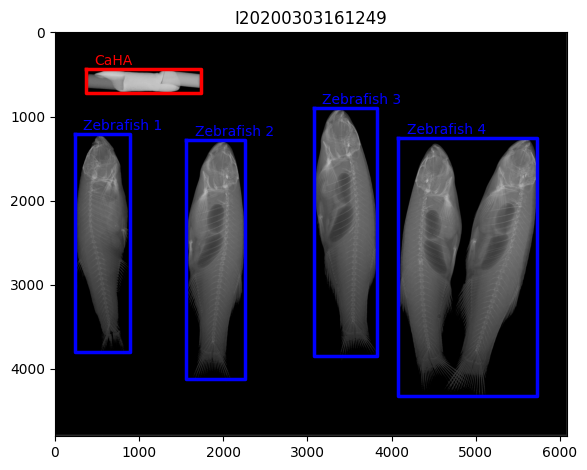

Progress:  77%|███████▋  | 166/216 [12:18<03:37,  4.36s/it]

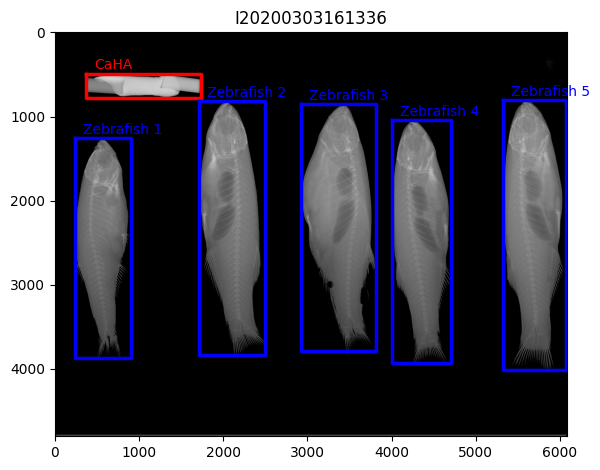

Progress:  77%|███████▋  | 167/216 [12:22<03:33,  4.36s/it]

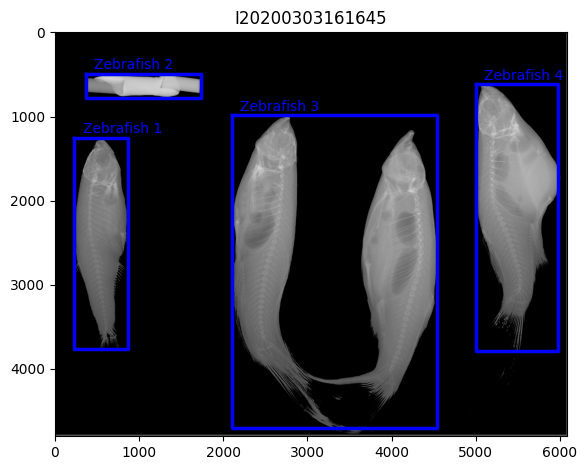

Progress:  78%|███████▊  | 168/216 [12:28<03:42,  4.64s/it]

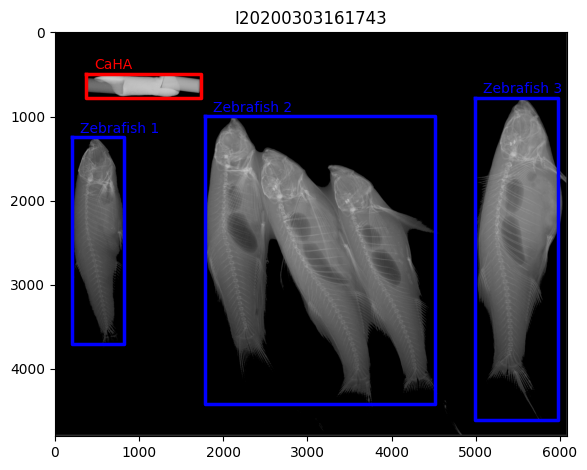

Progress:  78%|███████▊  | 169/216 [12:33<03:41,  4.72s/it]

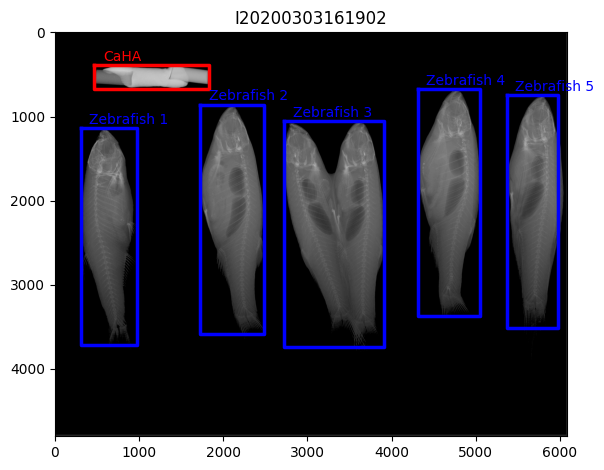

Progress:  79%|███████▊  | 170/216 [12:36<03:21,  4.38s/it]

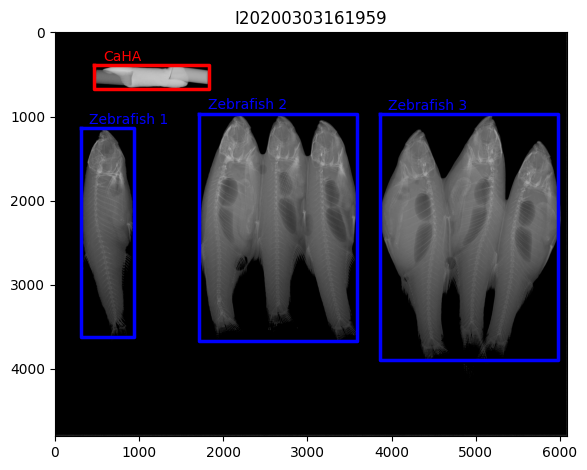

Progress:  79%|███████▉  | 171/216 [12:39<03:03,  4.08s/it]

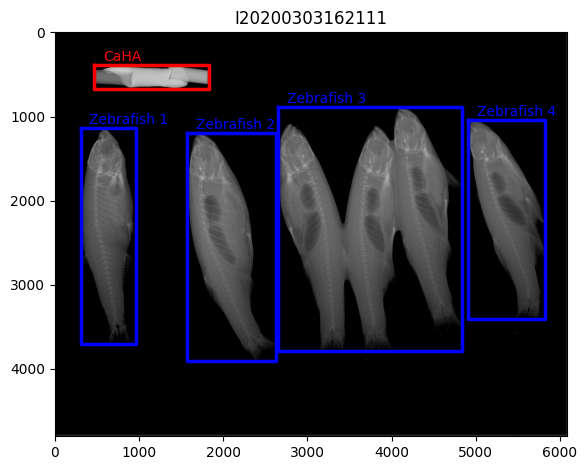

Progress:  80%|███████▉  | 172/216 [12:44<03:09,  4.31s/it]

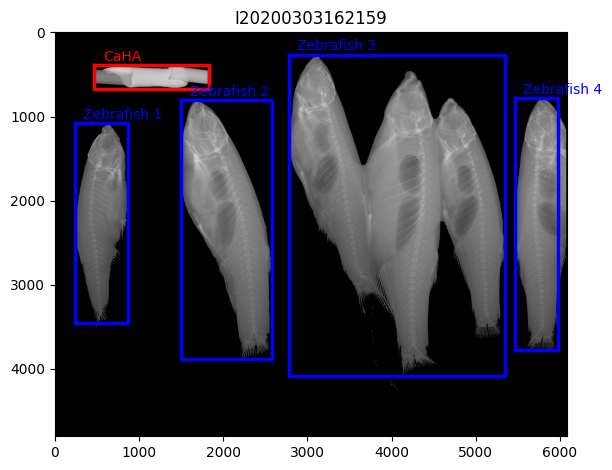

Progress:  80%|████████  | 173/216 [12:49<03:14,  4.53s/it]

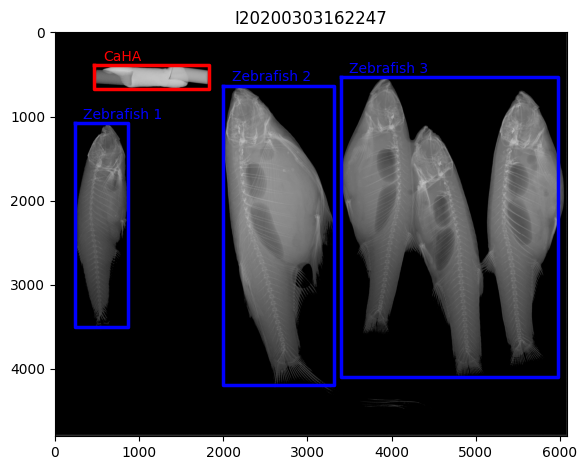

Progress:  81%|████████  | 174/216 [12:54<03:08,  4.49s/it]

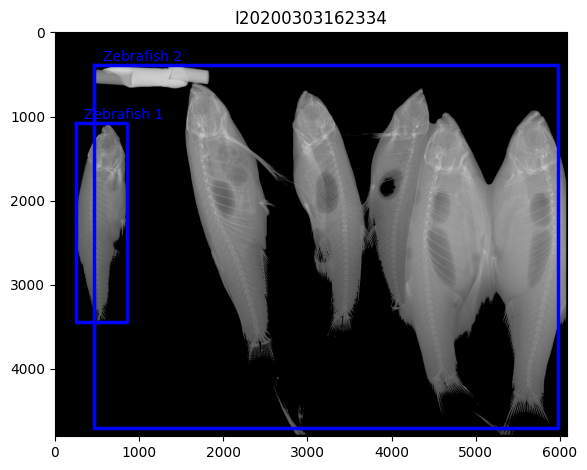

Progress:  81%|████████  | 175/216 [12:58<03:01,  4.43s/it]

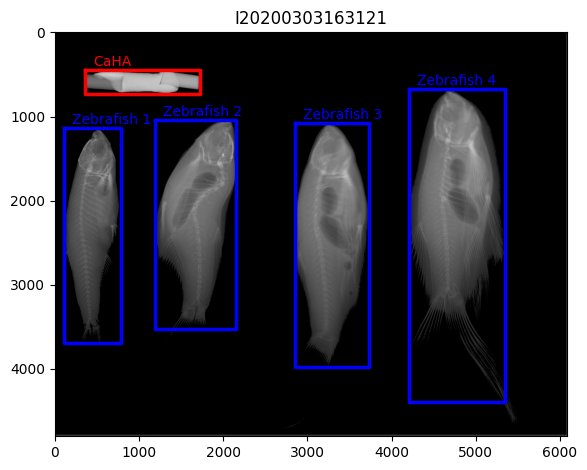

Progress:  81%|████████▏ | 176/216 [13:05<03:32,  5.32s/it]

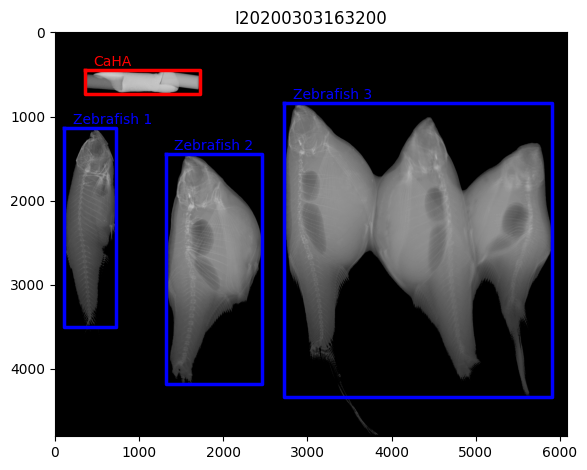

Progress:  82%|████████▏ | 177/216 [13:10<03:15,  5.01s/it]

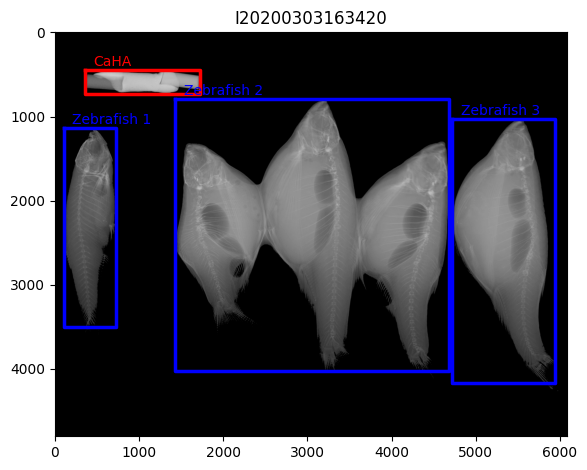

Progress:  82%|████████▏ | 178/216 [13:14<03:00,  4.76s/it]

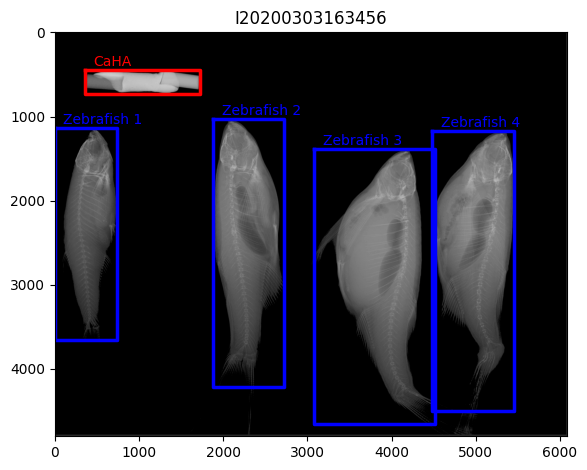

Progress:  83%|████████▎ | 179/216 [13:19<02:59,  4.86s/it]

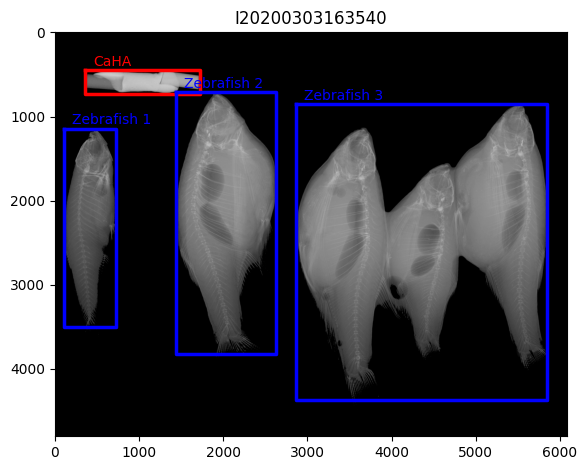

Progress:  83%|████████▎ | 180/216 [13:24<02:53,  4.81s/it]

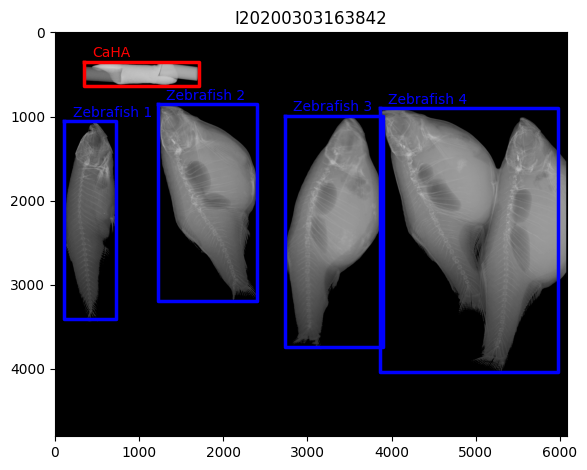

Progress:  84%|████████▍ | 181/216 [13:28<02:43,  4.66s/it]

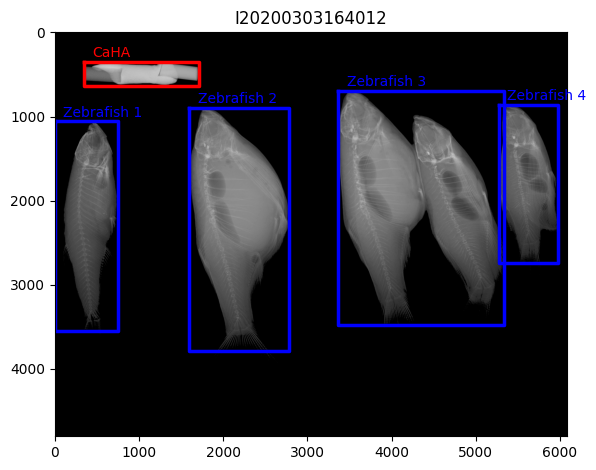

Progress:  84%|████████▍ | 182/216 [13:32<02:28,  4.37s/it]

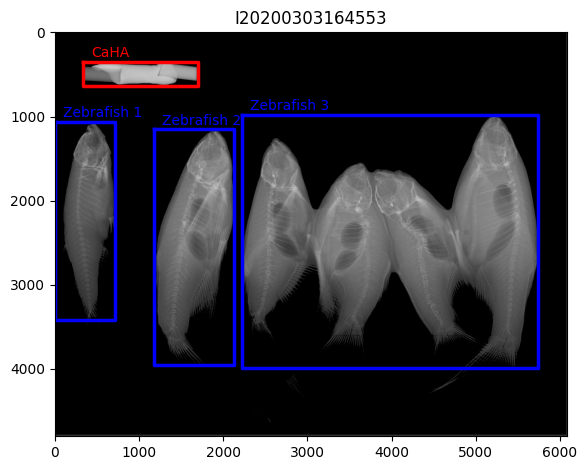

Progress:  85%|████████▍ | 183/216 [13:36<02:25,  4.41s/it]

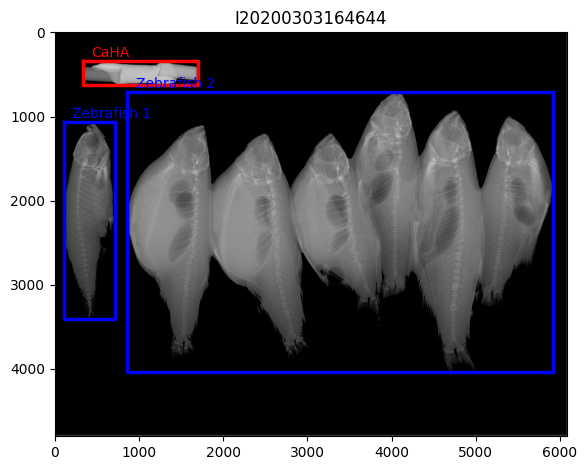

Progress:  85%|████████▌ | 184/216 [13:40<02:16,  4.28s/it]

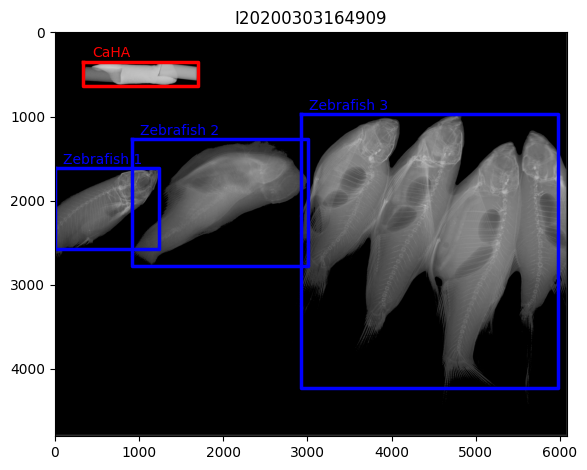

Progress:  86%|████████▌ | 185/216 [13:44<02:07,  4.13s/it]

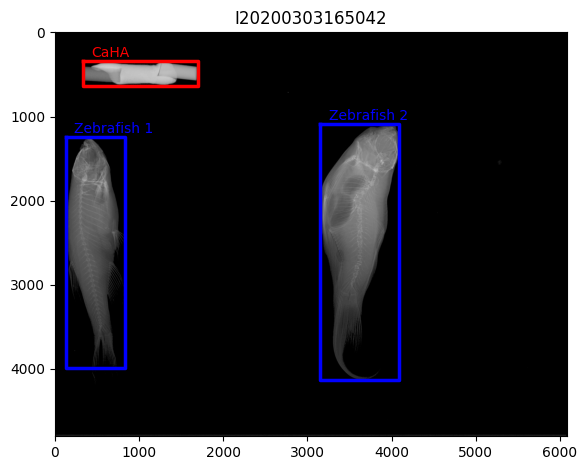

Progress:  86%|████████▌ | 186/216 [13:48<01:58,  3.96s/it]

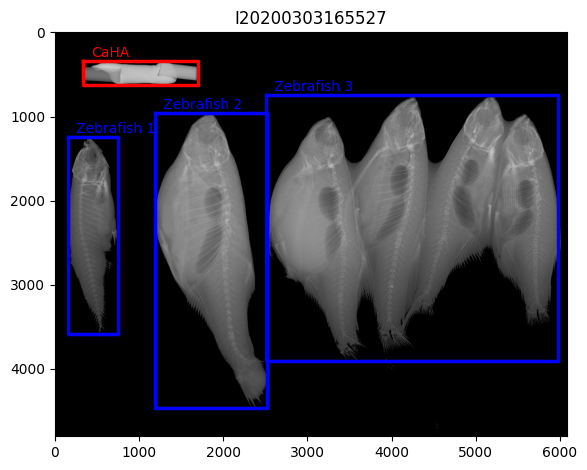

Progress:  87%|████████▋ | 187/216 [13:53<02:04,  4.28s/it]

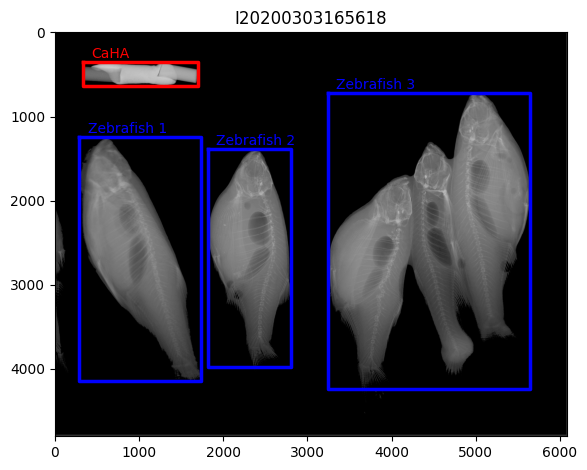

Progress:  87%|████████▋ | 188/216 [13:56<01:56,  4.16s/it]

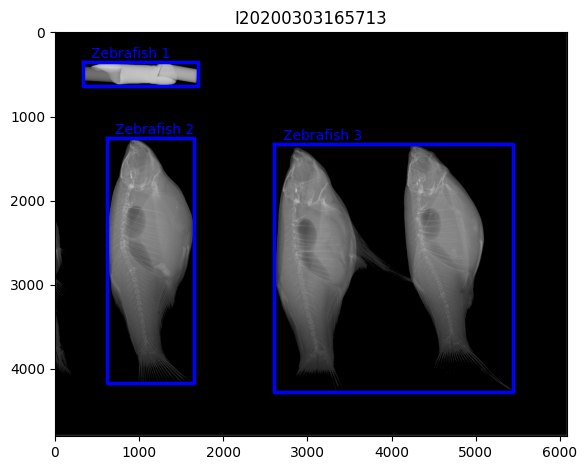

Progress:  88%|████████▊ | 189/216 [14:00<01:49,  4.04s/it]

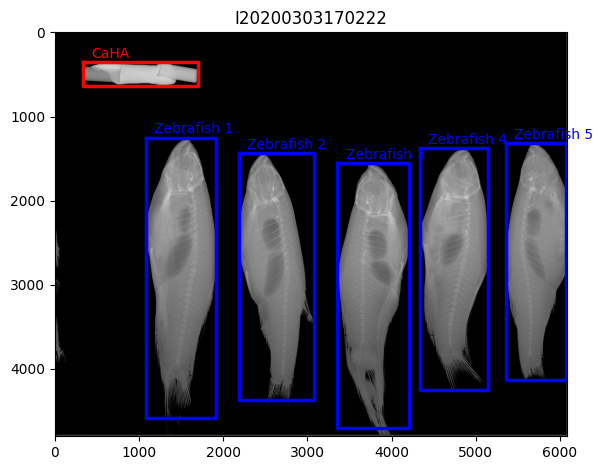

Progress:  88%|████████▊ | 190/216 [14:03<01:38,  3.77s/it]

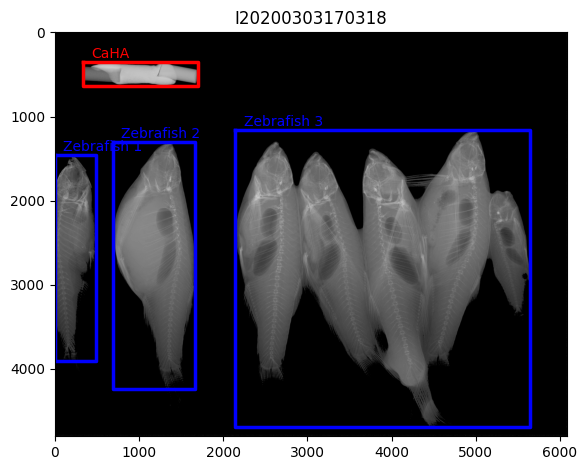

Progress:  88%|████████▊ | 191/216 [14:08<01:43,  4.12s/it]

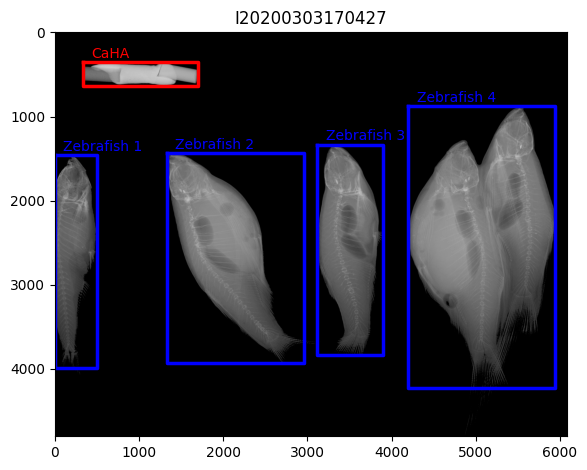

Progress:  89%|████████▉ | 192/216 [14:13<01:41,  4.21s/it]

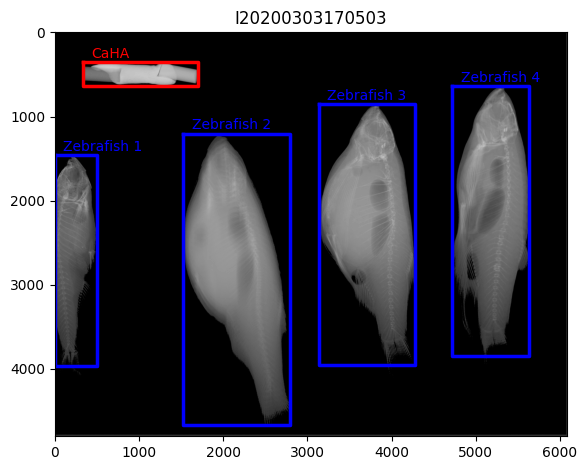

Progress:  89%|████████▉ | 193/216 [14:16<01:33,  4.06s/it]

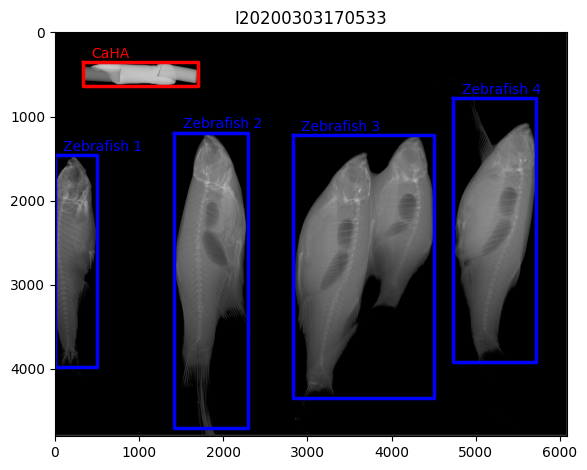

Progress:  90%|████████▉ | 194/216 [14:20<01:29,  4.05s/it]

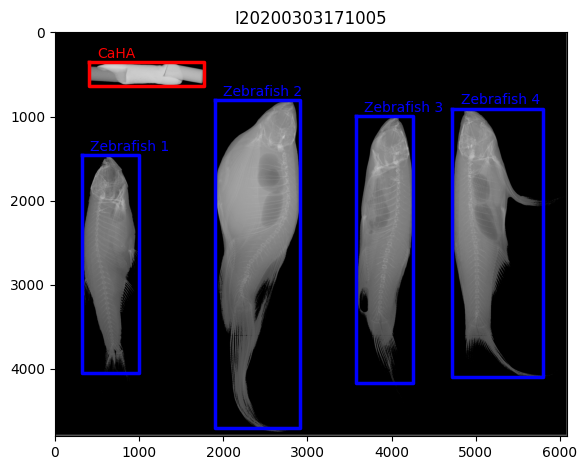

Progress:  90%|█████████ | 195/216 [14:26<01:34,  4.49s/it]

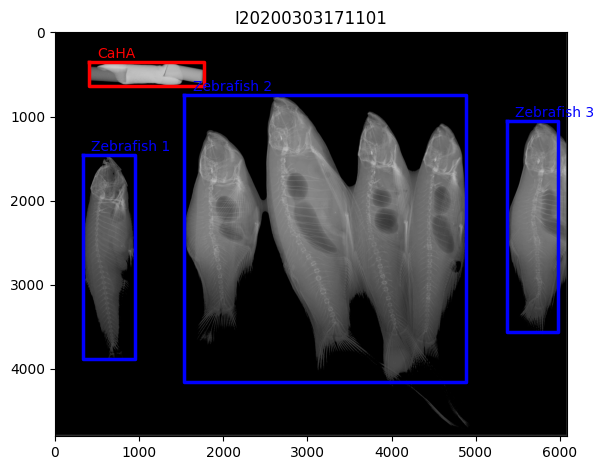

Progress:  91%|█████████ | 196/216 [14:30<01:27,  4.37s/it]

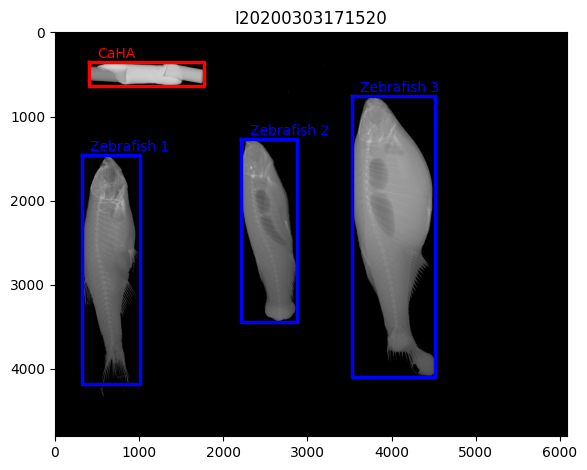

Progress:  91%|█████████ | 197/216 [14:34<01:21,  4.27s/it]

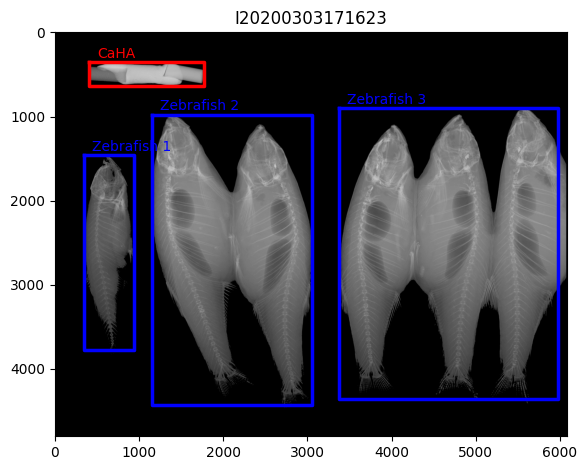

Progress:  92%|█████████▏| 198/216 [14:39<01:21,  4.53s/it]

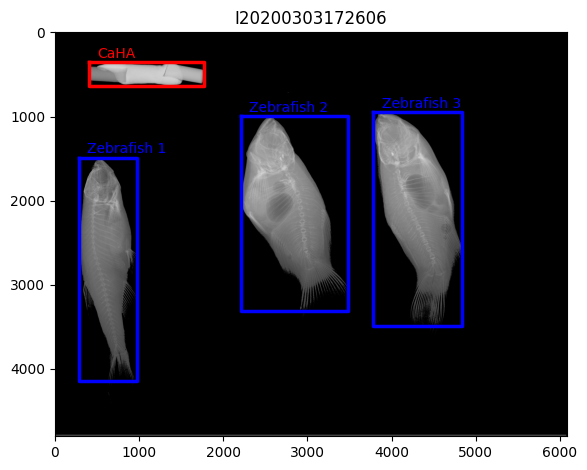

Progress:  92%|█████████▏| 199/216 [14:44<01:19,  4.70s/it]

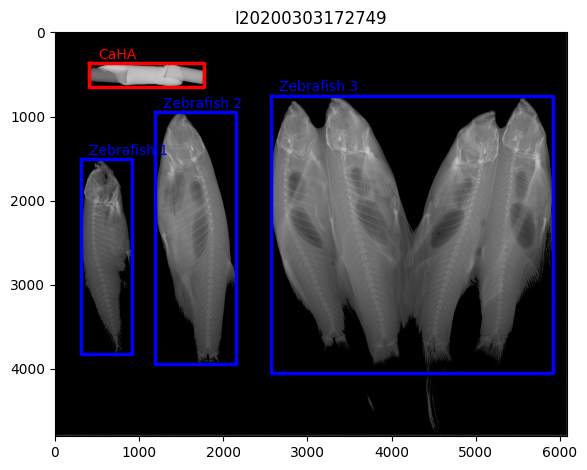

Progress:  93%|█████████▎| 200/216 [14:48<01:11,  4.47s/it]

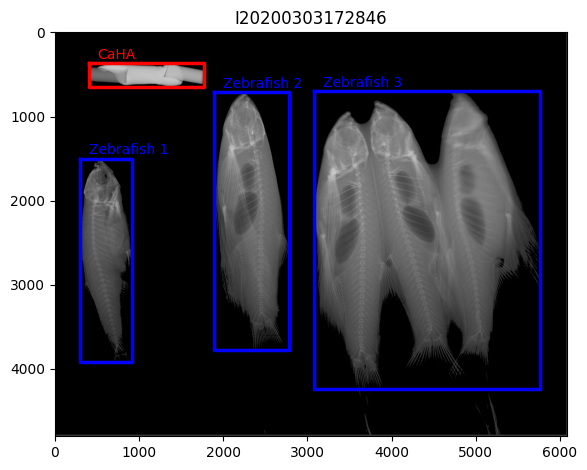

Progress:  93%|█████████▎| 201/216 [14:52<01:04,  4.28s/it]

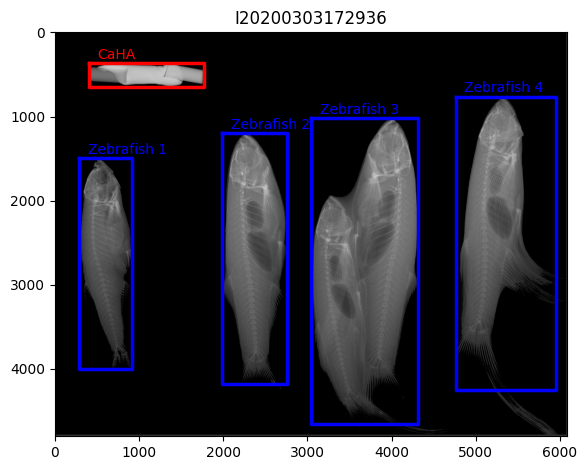

Progress:  94%|█████████▎| 202/216 [14:57<01:03,  4.51s/it]

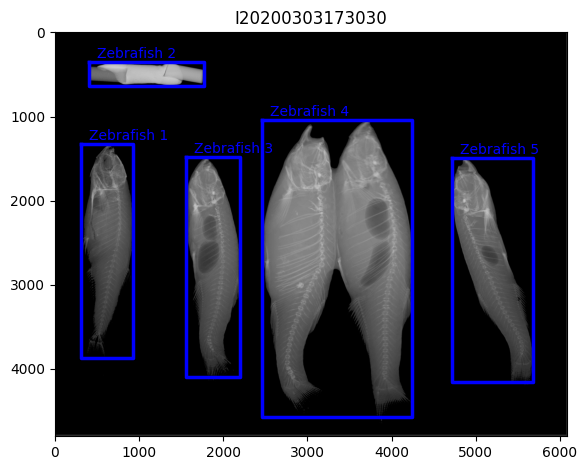

Progress:  94%|█████████▍| 203/216 [15:01<00:56,  4.34s/it]

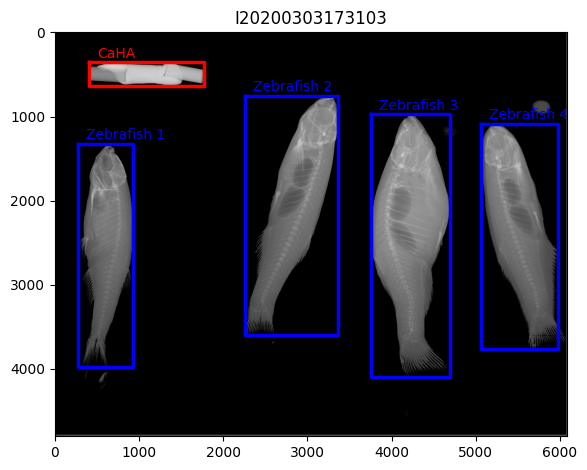

Progress:  94%|█████████▍| 204/216 [15:05<00:49,  4.15s/it]

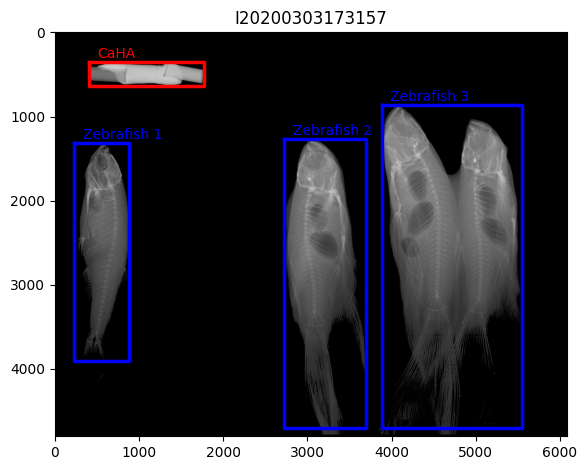

Progress:  95%|█████████▍| 205/216 [15:08<00:44,  4.01s/it]

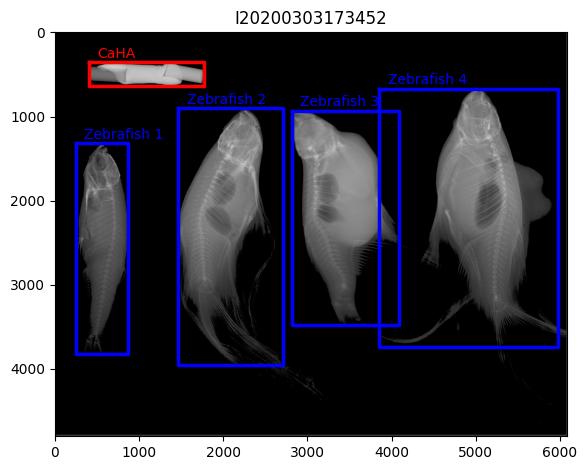

Progress:  95%|█████████▌| 206/216 [15:14<00:43,  4.34s/it]

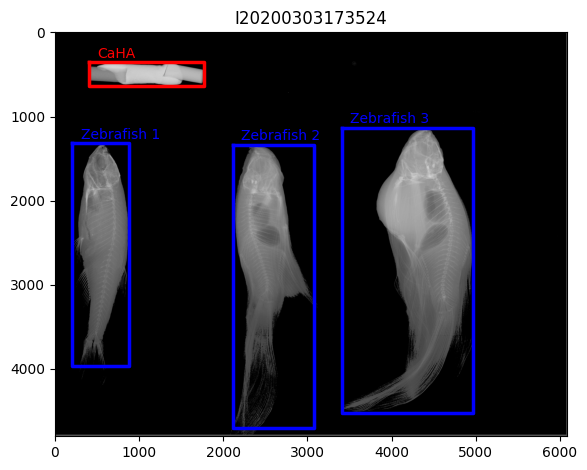

Progress:  96%|█████████▌| 207/216 [15:17<00:37,  4.20s/it]

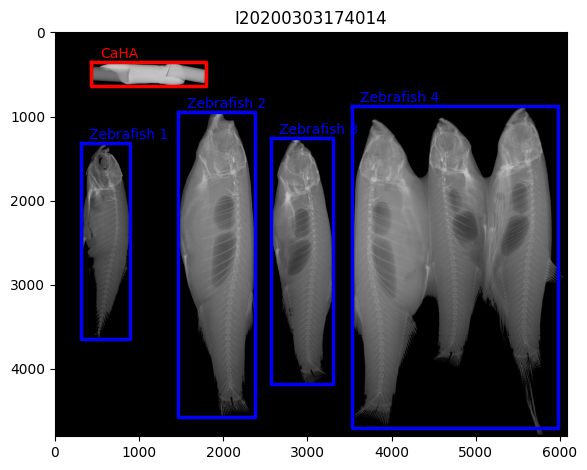

Progress:  96%|█████████▋| 208/216 [15:21<00:32,  4.09s/it]

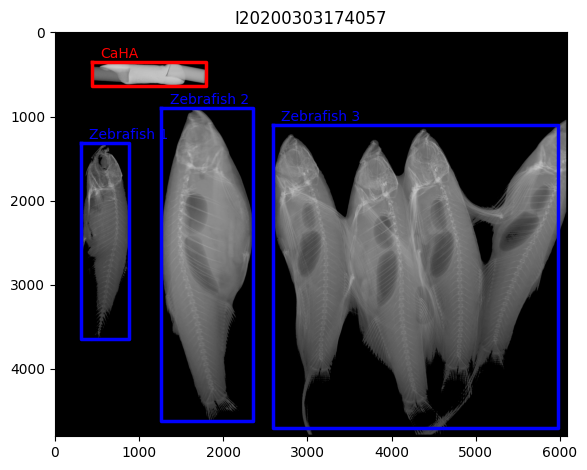

Progress:  97%|█████████▋| 209/216 [15:24<00:26,  3.82s/it]

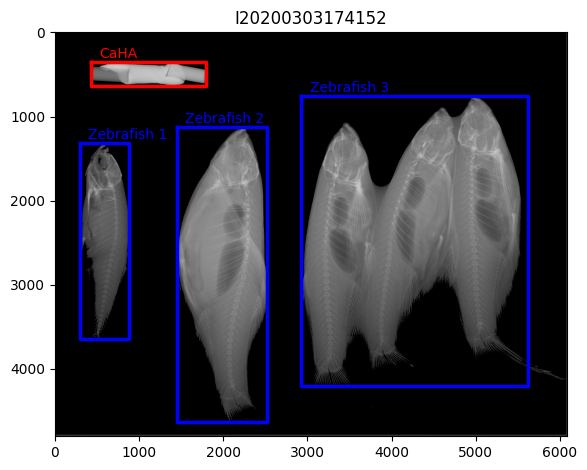

Progress:  97%|█████████▋| 210/216 [15:30<00:25,  4.22s/it]

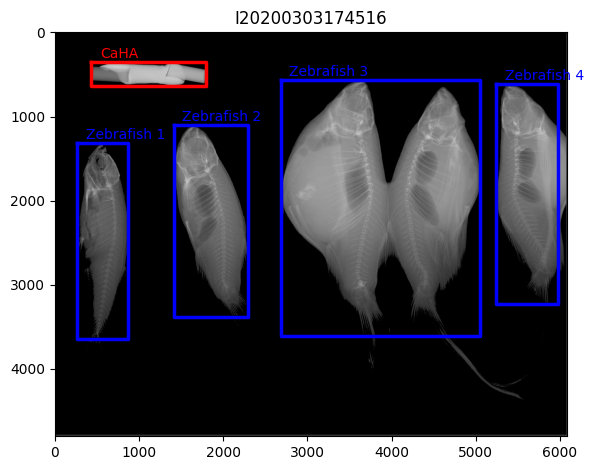

Progress:  98%|█████████▊| 211/216 [15:34<00:21,  4.25s/it]

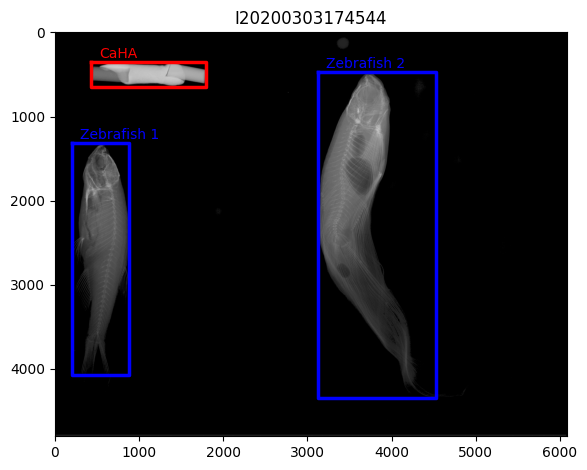

Progress:  98%|█████████▊| 212/216 [15:38<00:16,  4.17s/it]

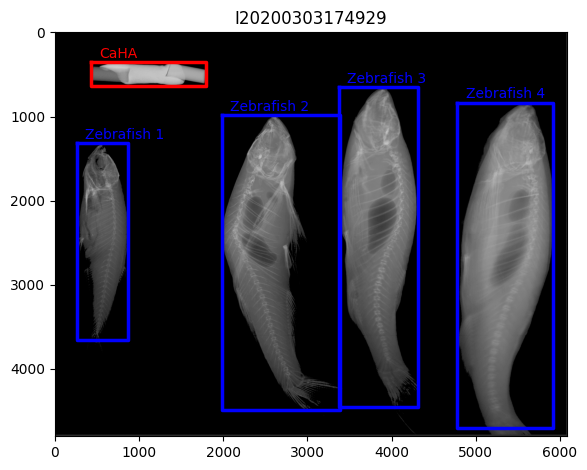

Progress:  99%|█████████▊| 213/216 [15:43<00:13,  4.36s/it]

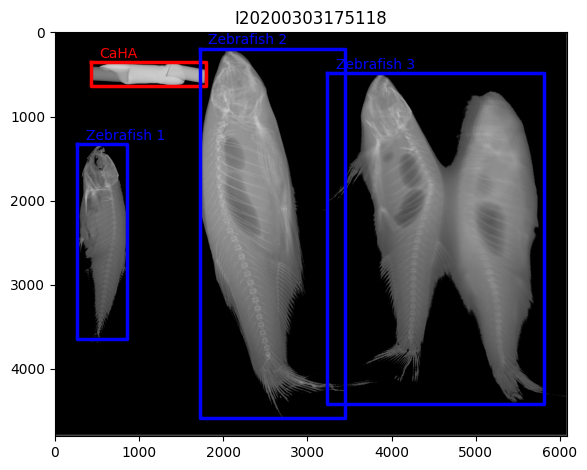

Progress:  99%|█████████▉| 214/216 [15:48<00:09,  4.58s/it]

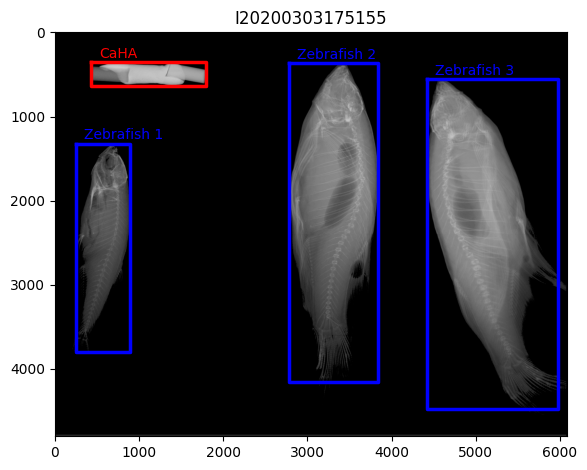

Progress: 100%|█████████▉| 215/216 [15:52<00:04,  4.44s/it]

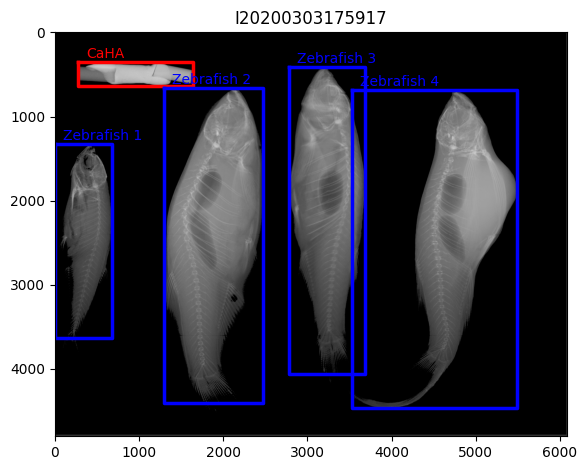

Progress: 100%|██████████| 216/216 [15:56<00:00,  4.43s/it]


In [22]:
os.chdir(os.path.join(dir_zebrafish_stock, shortcuts[0]))

progressbar = tqdm(re_iterations.Stock.unique(), desc = "Progress")
for n in progressbar:
  dcm_header = pydicom.dcmread(n + ".dcm")
  dcm_file = dcm_header.pixel_array*dcm_header.RescaleSlope - dcm_header.RescaleIntercept
  dcm_file = dcm_file.max() - dcm_file

  mask = dcm_file > np.mean(dcm_file)

  fig, ax = plt.subplots()
  ax.imshow([dcm_file > np.mean(dcm_file)][0]*dcm_file, cmap = "gray")

  indices = np.where(re_iterations.Stock == n)[0]

  for i in indices:
    bx = (re_iterations.X[i], re_iterations.X[i] + re_iterations.Width[i], re_iterations.X[i] + re_iterations.Width[i], re_iterations.X[i], re_iterations.X[i])
    by = (re_iterations.Y[i], re_iterations.Y[i], re_iterations.Y[i] + re_iterations.Height[i], re_iterations.Y[i] + re_iterations.Height[i], re_iterations.Y[i])

    if re_iterations.Class[i] == "Zebrafish":
      ax.plot(bx, by, '-b', linewidth = 2.5)
      ax.text(re_iterations.X[i] + 100, re_iterations.Y[i] - 50, "Zebrafish " + str(re_iterations["Image Names"][i].split(".")[1]), fontsize=10, color = 'b')

    else:
      ax.plot(bx, by, '-r', linewidth = 2.5)
      ax.text(re_iterations.X[i] + 100, re_iterations.Y[i] - 50, str(re_iterations["Image Names"][i].split(".")[1]), fontsize=10, color = 'r')

  plt.title(n)

  fig.tight_layout()
  plt.show()

### Saving Final Excel Version